In [18]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import pymongo
client = pymongo.MongoClient()
db = client.implementation_database
db.collection_names()   # ['RawData', 'Experiments']

['RawData', 'Experiments']

In [ ]:
"""
# Fields for Experiment entry to MongoDB
        self.experimentParams = {'exp_id':exp_id,
                         'experimentDescription':experimentDescription,
                         'conditionList':conditionList,
                         'cycles':cycles,
                         'segmentDuration':segmentDuration,
                         'numSegments':len(conditionList)*cycles,
                         'segment_id_list':[str(exp_id)+'_'+str(segNum) for segNum in range(len(conditionList)*cycles)],
                         'segment_condition_list':conditionList * cycles,
                         'posture':posture,
                         'delayTimer':delayTimer}
        # Create experiment document in MongoDB
        #db.Experiments.insert_one(self.experimentParams)
"""

In [ ]:
"""
# Fields for RawData entry to MongoDB

        entryDict = {'segment_id':EXPERIMENTER.experimentParams['segment_id_list'][seg], 
                     'segment_order_num':seg,
                     'exp_id':EXPERIMENTER.experimentParams['exp_id'],  
                     'condition_type':EXPERIMENTER.experimentParams['segment_condition_list'][seg],
                     'duration_seconds':EXPERIMENTER.experimentParams['segmentDuration'], 
                     'numFlags':len(flagsArrays[seg]), 
                     'flagsData':flagsArrays[seg],
                     'numPointsEEG':len(eegArrays[seg]), 
                     'eegData':eegArrays[seg],
                     'numPointsACC':len(accArrays[seg]),
                     'accData':accArrays[seg],
                     'numPointsGYRO':len(gyroArrays[seg]),
                     'gyroData':gyroArrays[seg]}
        #db.RawData.insert_one(entryDict)   
        #print('Segment data saved to database')
"""

In [26]:
docs_open = db.RawData.find({'condition_type':'eyes open', 'exp_id':'test_sitting_2'}, 
                            {'segment_id':1, 'duration_seconds':1,
                             'condition_type':1, 'numFlags':1,'numPointsEEG':1,
                             'numPointsACC':1,'numPointsGYRO':1, '_id':0}) 

docs_closed = db.RawData.find({'condition_type':'eyes closed', 'exp_id':'test_sitting_2'}, 
                            {'segment_id':1, 'duration_seconds':1,
                             'condition_type':1, 'numFlags':1,'numPointsEEG':1,
                             'numPointsACC':1,'numPointsGYRO':1, '_id':0}) 

In [15]:
for doc in docs_open:
    print(doc)

{'segment_id': 'test_sitting_2_0', 'condition_type': 'eyes open', 'duration_seconds': 10, 'numFlags': 1, 'numPointsEEG': 2568, 'numPointsACC': 517, 'numPointsGYRO': 519}
{'segment_id': 'test_sitting_2_2', 'condition_type': 'eyes open', 'duration_seconds': 10, 'numFlags': 0, 'numPointsEEG': 2556, 'numPointsACC': 516, 'numPointsGYRO': 516}
{'segment_id': 'test_sitting_2_4', 'condition_type': 'eyes open', 'duration_seconds': 10, 'numFlags': 2, 'numPointsEEG': 2556, 'numPointsACC': 516, 'numPointsGYRO': 514}
{'segment_id': 'test_sitting_2_6', 'condition_type': 'eyes open', 'duration_seconds': 10, 'numFlags': 1, 'numPointsEEG': 2548, 'numPointsACC': 518, 'numPointsGYRO': 519}
{'segment_id': 'test_sitting_2_8', 'condition_type': 'eyes open', 'duration_seconds': 10, 'numFlags': 2, 'numPointsEEG': 2552, 'numPointsACC': 519, 'numPointsGYRO': 516}
{'segment_id': 'test_sitting_2_10', 'condition_type': 'eyes open', 'duration_seconds': 10, 'numFlags': 3, 'numPointsEEG': 2556, 'numPointsACC': 516, '

In [16]:
for doc in docs_closed:
    print(doc)

{'segment_id': 'test_sitting_2_1', 'condition_type': 'eyes closed', 'duration_seconds': 10, 'numFlags': 1, 'numPointsEEG': 2568, 'numPointsACC': 519, 'numPointsGYRO': 519}
{'segment_id': 'test_sitting_2_3', 'condition_type': 'eyes closed', 'duration_seconds': 10, 'numFlags': 0, 'numPointsEEG': 2568, 'numPointsACC': 519, 'numPointsGYRO': 519}
{'segment_id': 'test_sitting_2_5', 'condition_type': 'eyes closed', 'duration_seconds': 10, 'numFlags': 0, 'numPointsEEG': 2568, 'numPointsACC': 519, 'numPointsGYRO': 519}
{'segment_id': 'test_sitting_2_7', 'condition_type': 'eyes closed', 'duration_seconds': 10, 'numFlags': 1, 'numPointsEEG': 2556, 'numPointsACC': 513, 'numPointsGYRO': 516}
{'segment_id': 'test_sitting_2_9', 'condition_type': 'eyes closed', 'duration_seconds': 10, 'numFlags': 9, 'numPointsEEG': 2580, 'numPointsACC': 519, 'numPointsGYRO': 519}
{'segment_id': 'test_sitting_2_11', 'condition_type': 'eyes closed', 'duration_seconds': 10, 'numFlags': 1, 'numPointsEEG': 2544, 'numPoints

In [27]:
df_open = pd.DataFrame(list(docs_open))

In [28]:
df_closed = pd.DataFrame(list(docs_closed))

In [31]:
df = pd.concat([df_open, df_closed], axis=0)
df

,segment_id,condition_type,duration_seconds,numFlags,numPointsEEG,numPointsACC,numPointsGYRO
0,test_sitting_2_0,eyes open,10,1,2568,517,519
1,test_sitting_2_2,eyes open,10,0,2556,516,516
2,test_sitting_2_4,eyes open,10,2,2556,516,514
3,test_sitting_2_6,eyes open,10,1,2548,518,519
4,test_sitting_2_8,eyes open,10,2,2552,519,516
5,test_sitting_2_10,eyes open,10,3,2556,516,516
6,test_sitting_2_12,eyes open,10,2,2580,519,519
7,test_sitting_2_14,eyes open,10,3,2549,516,516
8,test_sitting_2_16,eyes open,10,3,2556,516,516
9,test_sitting_2_18,eyes open,10,2,2556,516,516


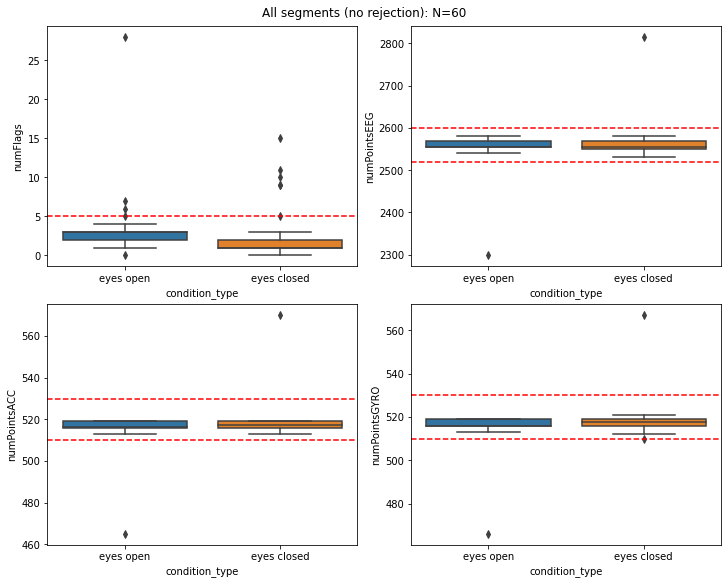

In [56]:
fig, axes = plt.subplots(2,2,constrained_layout=True, figsize=(10,8))
sns.boxplot(data=df, 
            y='numFlags', x='condition_type', ax=axes[0,0])

sns.boxplot(data=df, 
            y='numPointsEEG', x='condition_type', ax=axes[0,1])

sns.boxplot(data=df, 
            y='numPointsACC', x='condition_type', ax=axes[1,0])

sns.boxplot(data=df, 
            y='numPointsGYRO', x='condition_type', ax=axes[1,1])

axes[0,0].axhline(5,color='r',ls='--')
axes[0,1].axhline(2520,color='r',ls='--')
axes[1,0].axhline(510,color='r',ls='--')
axes[1,1].axhline(510,color='r',ls='--')
axes[0,1].axhline(2600,color='r',ls='--')
axes[1,0].axhline(530,color='r',ls='--')
axes[1,1].axhline(530,color='r',ls='--')
fig.suptitle('All segments (no rejection): N='+str(len(df)))
plt.show()

# Exclude segments with 5 or more flags. These flags indicate noise artifacts or signal problems of known kinds.

# Also exclude segments with number of datapoints more than 1.5% different from average, as this could indicate a gap in the recording.

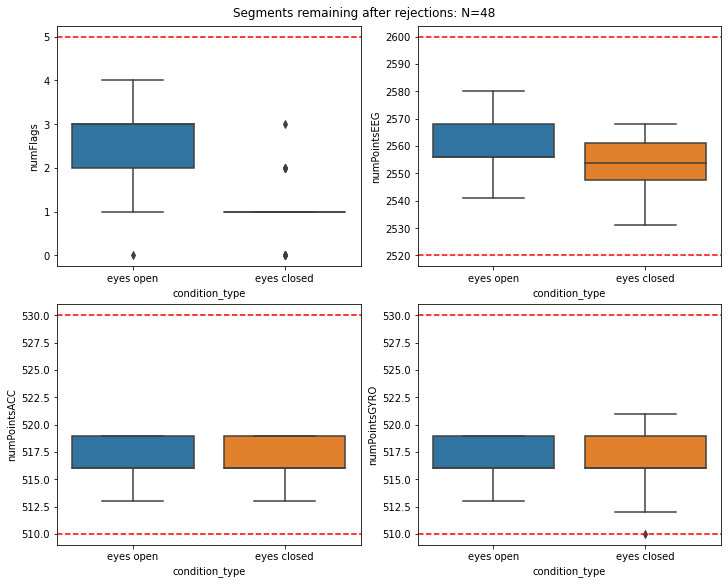

In [63]:
fig, axes = plt.subplots(2,2,constrained_layout=True, figsize=(10,8))
sns.boxplot(data=df[(df.numFlags < 5) & (abs(df.numPointsEEG / df.numPointsEEG.mean() - 1) < 0.015)], 
            y='numFlags', x='condition_type', ax=axes[0,0])

sns.boxplot(data=df[(df.numFlags < 5) & (abs(df.numPointsEEG / df.numPointsEEG.mean() - 1) < 0.015)], 
            y='numPointsEEG', x='condition_type', ax=axes[0,1])

sns.boxplot(data=df[(df.numFlags < 5) & (abs(df.numPointsEEG / df.numPointsEEG.mean() - 1) < 0.015)], 
            y='numPointsACC', x='condition_type', ax=axes[1,0])

sns.boxplot(data=df[(df.numFlags < 5) & (abs(df.numPointsEEG / df.numPointsEEG.mean() - 1) < 0.015)], 
            y='numPointsGYRO', x='condition_type', ax=axes[1,1])

axes[0,0].axhline(5,color='r',ls='--')
axes[0,1].axhline(2520,color='r',ls='--')
axes[1,0].axhline(510,color='r',ls='--')
axes[1,1].axhline(510,color='r',ls='--')
axes[0,1].axhline(2600,color='r',ls='--')
axes[1,0].axhline(530,color='r',ls='--')
axes[1,1].axhline(530,color='r',ls='--')
fig.suptitle('Segments remaining after rejections: N='+str(len(df[(df.numFlags < 5) & (abs(df.numPointsEEG - df.numPointsEEG.mean()) < 40)])))
plt.show()

In [65]:
descr_df1 = df.groupby('condition_type').describe().T
descr_df2 = df[(df.numFlags < 5) & (abs(df.numPointsEEG / df.numPointsEEG.mean() - 1) < 0.015)].groupby('condition_type').describe().T

display(pd.concat([descr_df1,descr_df2],axis=1))

condition_type          eyes closed    eyes open  eyes closed    eyes open
duration_seconds count    30.000000    30.000000    23.000000    25.000000
                 mean     10.000000    10.000000    10.000000    10.000000
                 std       0.000000     0.000000     0.000000     0.000000
                 min      10.000000    10.000000    10.000000    10.000000
                 25%      10.000000    10.000000    10.000000    10.000000
                 50%      10.000000    10.000000    10.000000    10.000000
                 75%      10.000000    10.000000    10.000000    10.000000
                 max      10.000000    10.000000    10.000000    10.000000
numFlags         count    30.000000    30.000000    23.000000    25.000000
                 mean      2.833333     3.566667     1.043478     2.400000
                 std       3.869272     4.825817     0.767420     0.866025
                 min       0.000000     0.000000     0.000000     0.000000
                 25%       1.000000     2.000000     1.000000     2.000000
                 50%       1.000000     3.000000     1.000000     3.000000
                 75%       2.000000     3.000000     1.000000     3.000000
                 max      15.000000    28.000000     3.000000     4.000000
numPointsEEG     count    30.000000    30.000000    23.000000    25.000000
                 mean   2564.566667  2551.166667  2554.173913  2558.480000
                 std      48.640613    48.724478    10.016587     9.097252
                 min    2531.000000  2298.000000  2531.000000  2541.000000
                 25%    2550.250000  2556.000000  2547.500000  2556.000000
                 50%    2556.000000  2556.000000  2554.000000  2556.000000
                 75%    2568.000000  2568.000000  2561.000000  2568.000000
                 max    2816.000000  2580.000000  2568.000000  2580.000000
numPointsACC     count    30.000000    30.000000    23.000000    25.000000
                 mean    518.633333   515.533333   516.695652   517.120000
                 std       9.963670     9.701523     2.324470     1.786990
                 min     513.000000   465.000000   513.000000   513.000000
                 25%     516.000000   516.000000   516.000000   516.000000
                 50%     517.500000   516.500000   516.000000   516.000000
                 75%     519.000000   519.000000   519.000000   519.000000
                 max     570.000000   519.000000   519.000000   519.000000
numPointsGYRO    count    30.000000    30.000000    23.000000    25.000000
                 mean    518.733333   515.433333   516.826087   517.040000
                 std       9.424595     9.511095     2.587596     1.903506
                 min     510.000000   466.000000   510.000000   513.000000
                 25%     516.000000   516.000000   516.000000   516.000000
                 50%     517.500000   516.000000   516.000000   516.000000
                 75%     519.000000   519.000000   519.000000   519.000000
                 max     567.000000   519.000000   521.000000   519.000000

In [69]:
dg = df[(df.numFlags < 5) & (abs(df.numPointsEEG / df.numPointsEEG.mean() - 1) < 0.015)].copy()
dg = dg.reset_index(drop=True)
dg

,segment_id,condition_type,duration_seconds,numFlags,numPointsEEG,numPointsACC,numPointsGYRO
0,test_sitting_2_0,eyes open,10,1,2568,517,519
1,test_sitting_2_2,eyes open,10,0,2556,516,516
2,test_sitting_2_4,eyes open,10,2,2556,516,514
3,test_sitting_2_6,eyes open,10,1,2548,518,519
4,test_sitting_2_8,eyes open,10,2,2552,519,516
5,test_sitting_2_10,eyes open,10,3,2556,516,516
6,test_sitting_2_12,eyes open,10,2,2580,519,519
7,test_sitting_2_14,eyes open,10,3,2549,516,516
8,test_sitting_2_16,eyes open,10,3,2556,516,516
9,test_sitting_2_18,eyes open,10,2,2556,516,516


# Now going deeper into embedded data arrays

In [70]:
db.RawData.find_one().keys()

dict_keys(['_id', 'segment_id', 'segment_order_num', 'exp_id', 'condition_type', 'duration_seconds', 'numFlags', 'flagsData', 'numPointsEEG', 'eegData', 'numPointsACC', 'accData', 'numPointsGYRO', 'gyroData'])

In [83]:
outerSet = set()
for seg_id in df.segment_id.values:
    docs = db.RawData.find({'segment_id':seg_id}, {'flagsData':1, '_id':0})
    try:
        outerSet.add(*[ doc['flagsData'][0]['flag'] for doc in list(docs)])
    except:
        pass
print('All distinct flags in original dataset:',outerSet)

outerSet = set()
for seg_id in dg.segment_id.values:
    docs = db.RawData.find({'segment_id':seg_id}, {'flagsData':1, '_id':0})
    try:
        outerSet.add(*[ doc['flagsData'][0]['flag'] for doc in list(docs)])
    except:
        pass
print('All distinct flags in cleaned dataset:',outerSet)

All distinct flags in original dataset: {'flag_hsi_tp9', 'flag_blink'}
All distinct flags in cleaned dataset: {'flag_blink'}


In [140]:
# ['eegData','accData','gyroData']:

simple_agg_funcs = ['mean','var','min','max']
outerList = []

docs = db.RawData.find({'segment_id':{"$in":list(dg.segment_id.values)}} , {'eegData':1, '_id':0})   # , {'eegData':1, '_id':0}
for doc in docs:
    outerList.append(pd.DataFrame(doc['eegData']).iloc[:,1:].agg(simple_agg_funcs))

#for listItem in outerList:
display(outerList[0])

,tp9,af7,af8,tp10
mean,802.402790,803.310482,802.987259,803.229363
var,2619.993527,42.064232,32.443997,7621.517768
min,682.564087,774.835144,782.490845,651.538452
max,911.831482,823.992676,824.395630,953.736267


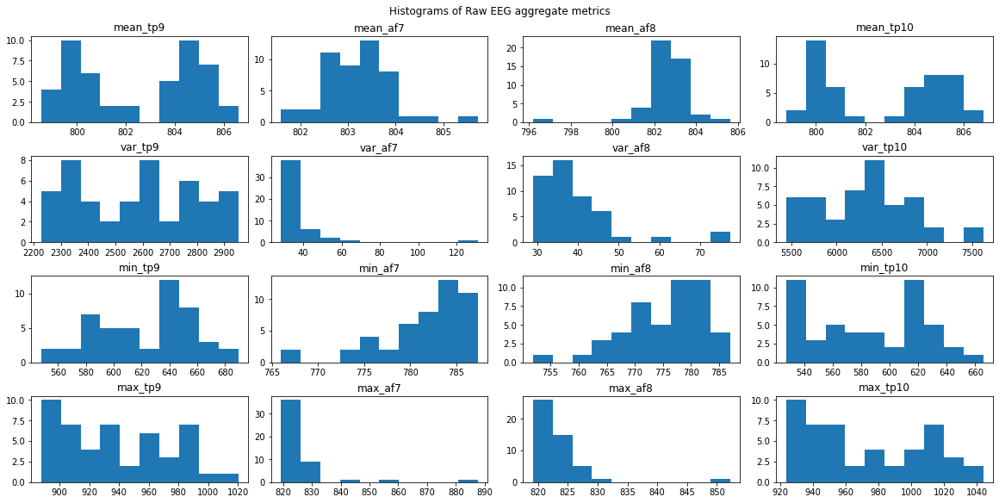

In [134]:
fig, axes = plt.subplots(4,4,constrained_layout=True,figsize=(16,8))
col_names = ['tp9','af7','af8','tp10']
row_names = ['mean','var','min','max']
for i in range(4):
    for j in range(4):
        axes[i,j].hist([item.iloc[i,j] for item in outerList])
        axes[i,j].set_title(row_names[i]+'_'+col_names[j])
fig.suptitle('Histograms of Raw EEG aggregate metrics')
plt.show()

### This analysis shows me that there is a very narrow range of mean values of raw EEG data, when averaged over 10 seconds. However, there is substantial variability in variance.

In [147]:
# ['eegData','accData','gyroData']:

simple_agg_funcs = ['mean','var','min','max']
outerList = []

docs = db.RawData.find({'segment_id':{"$in":list(dg.segment_id.values)}} , {'accData':1, '_id':0}) 
for doc in docs:
    outerList.append(pd.DataFrame(doc['accData']).iloc[:,1:].agg(simple_agg_funcs))

#for listItem in outerList:
display(outerList[0])

,acc_x,acc_y,acc_z
mean,-0.396427,0.006151,0.907710
var,0.000037,0.000020,0.000032
min,-0.409729,-0.005920,0.876526
max,-0.377930,0.022827,0.929199


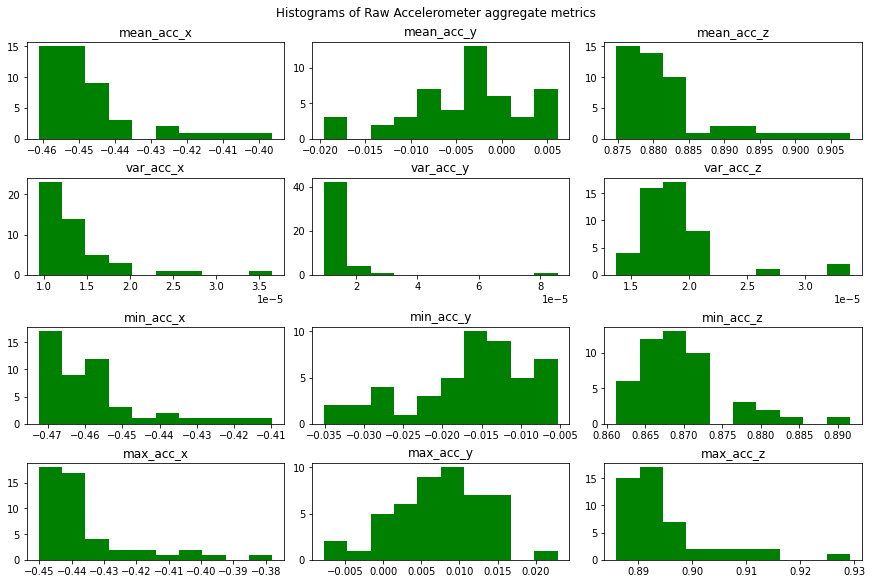

In [150]:
fig, axes = plt.subplots(4,3,constrained_layout=True,figsize=(12,8))
col_names = ['acc_x','acc_y','acc_z']
row_names = ['mean','var','min','max']
for i in range(4):
    for j in range(3):
        axes[i,j].hist([item.iloc[i,j] for item in outerList], color='g')
        axes[i,j].set_title(row_names[i]+'_'+col_names[j])
fig.suptitle('Histograms of Raw Accelerometer aggregate metrics')
plt.show()

### The aggregate metrics of the accelerometer shows me that acc_x and acc_z are not centered around zero. There is not much variability.

In [156]:
# ['eegData','accData','gyroData']:

simple_agg_funcs = ['mean','var','min','max']
outerList = []

docs = db.RawData.find({'segment_id':{"$in":list(dg.segment_id.values)}} , {'gyroData':1, '_id':0}) 
for doc in docs:
    outerList.append(pd.DataFrame(doc['gyroData']).iloc[:,1:].agg(simple_agg_funcs))

#for listItem in outerList:
display(outerList[0])

,gyro_x,gyro_y,gyro_z
mean,4.269415,-0.543948,3.856649
var,0.136389,0.497203,0.332824
min,2.721558,-4.747772,1.383209
max,6.512299,0.949554,7.050629


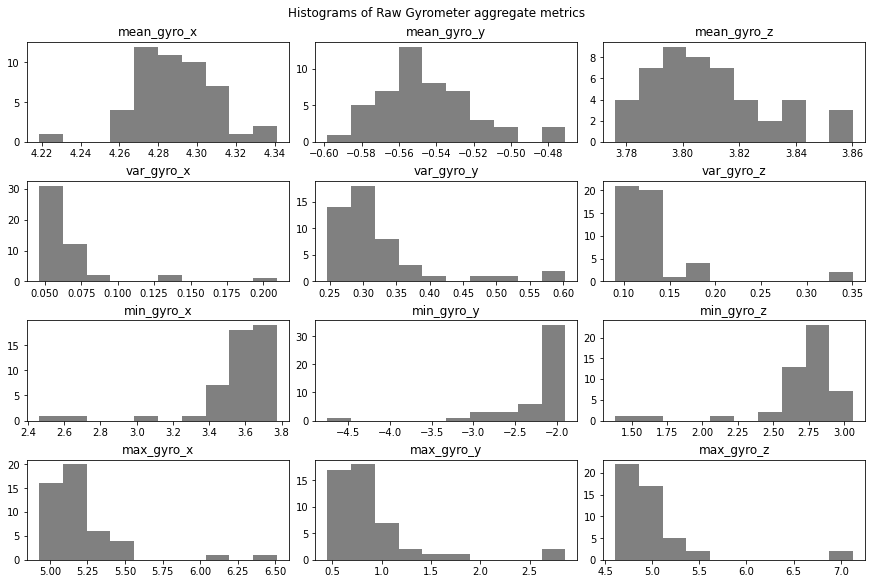

In [154]:
fig, axes = plt.subplots(4,3,constrained_layout=True,figsize=(12,8))
col_names = ['gyro_x','gyro_y','gyro_z']
row_names = ['mean','var','min','max']
for i in range(4):
    for j in range(3):
        axes[i,j].hist([item.iloc[i,j] for item in outerList], color='gray')
        axes[i,j].set_title(row_names[i]+'_'+col_names[j])
fig.suptitle('Histograms of Raw Gyrometer aggregate metrics')
plt.show()

### The mean for gyroscope appears to be more normally distributed than the accelerometer.

# Now to return to EEG data for some frequency based analysis.

In [167]:
import scipy.signal as sg
def plot_spectrograms(signals, fs_list, window_len_list, freq_adjust_list, ylabel_list, fig_suptitle):
    """
    This function plots multiple time series on a shared x-axis.
    INPUTS:
    start_time : int/float (start time in seconds)
    end_time : int/float (end time in seconds)
    
    signals : list of numpy arrays (signals to plot)
    fs_list : list of int/float (sampling rates corresponding to signals)
    window_len_list : list of integers (num_points in STFT window)
    ylabel_list : list of strings for y-axes
    
    fig_suptitle : string for figure title
    """  
    # number of signals in list
    num_channels = len(signals)
    
    # initiate figure and axes, figure height of 2.5 per channel
    #fig, ax = plt.subplots(num_channels, 1, sharex=True, figsize=(16, num_channels*2.5))
    
    for i in range(num_channels):
    
        fs = fs_list[i]   # sampling rate
        signal_length = signals[i].shape[0]  # number of time points
        t_end = signal_length / fs
        times = np.linspace(0, t_end, signal_length, endpoint=False)
        
        fig = plt.figure(figsize=[12, 8])
        plt.subplot(3,1,1)
        plt.plot(times, signals[i])
        plt.xlabel('Time (Seconds)')
        plt.ylabel(ylabel_list[i])
        
        ############
        ##########
        ########
        ######   
        # import scipy.signal as sg
        
        
        #overl = len(wind) - int(len(wind) * 0.125)     # Apply kernel with steps of 10%. 90% overlap between subsequent segments.
        #yFreqs = range(21)        # Define frequencies we want in our spectrogram.
  
        # Compute Spectrogram
        windLength = window_len_list[i]
        wind = np.kaiser(windLength, 0)   # Create Kaiser window
        
        print("windLength",windLength)        #debug
        print("len(wind)",len(wind))    #debug
        #print("overl",overl) #debug
        print("signal_length",signal_length)
        print("signal_shapeh",signals[i].shape)
        
        
        f, tt, Sxx = sg.spectrogram(signals[i].ravel(), fs, wind, noverlap=len(wind)*0.9)
        print('f.shape =',f.shape,'tt.shape =',tt.shape, 'Sxx.shape =',Sxx.shape)
        
        plt.subplot(3,1,2)
        plt.pcolormesh(tt[1:], f[1:freq_adjust_list[i]], np.log(Sxx[1:freq_adjust_list[i],1:]), cmap='hot') #
        plt.ylabel('Frequency (Hz)')
        plt.xlabel('Time (Seconds)')
        #plt.ylim([1,20])
        plt.title('Kaiser window')
        plt.colorbar()
        
        print("windLength",windLength)        #debug
        print("len(wind)",len(wind))    #debug
        #print("overl",overl) #debug
        print("signal_length",signal_length)

        wind = np.hanning(windLength)   # Create Hanning window of length 1024
        f, tt, Sxx = sg.spectrogram(signals[i].ravel(), fs, wind, noverlap=len(wind)*0.9)   # Compute Spectrogram
        plt.subplot(3,1,3)
        plt.pcolormesh(tt[1:], f[1:freq_adjust_list[i]], np.log(Sxx[1:freq_adjust_list[i],1:]), cmap='hot')
        #plt.ylabel('Frequency (Hz)')
        plt.xlabel('Time (Seconds)')
        #plt.ylim([1,20])
        plt.title('Hanning window')
        plt.colorbar()

        plt.tight_layout()
        plt.show()

In [ ]:
"""
plot_spectrograms(
                  signals=[ECG_signal, BVP_signal, EMG_signal], 
                  fs_list=[700, 64, 700], 
                  window_len_list = [4048, 370, 4048], 
                  freq_adjust_list = [int(2025), int(186), int(2025)],
                  ylabel_list= ['ECG \n(time domain)', 'BVP \n(time domain)', 'EMG \n(time domain)'],
                  fig_suptitle='STFT of 0s-60s, Subject S11')
"""

In [162]:
outerList = []
seg_id_list = []

docs = db.RawData.find({'segment_id':{"$in":list(dg.segment_id.values)}} , {'eegData':1, 'segment_id':1, '_id':0})   # , {'eegData':1, '_id':0}
for doc in docs:
    #print(doc['segment_id'])
    seg_id_list.append(doc['segment_id'])
    outerList.append(pd.DataFrame(doc['eegData']).iloc[:,1:])

#for listItem in outerList:
print(seg_id_list[0])
display(outerList[0])

test_sitting_2_0


,tp9,af7,af8,tp10
0,882.417603,806.263733,809.084229,871.941406
1,797.399292,798.608032,809.487183,909.010986
2,874.358948,807.472534,800.219788,809.084229
3,750.659363,800.219788,798.205139,863.479858
4,733.333313,795.384644,808.278381,770.402954
...,...,...,...,...
2563,785.714294,804.249084,792.564087,705.128235
2564,858.644714,805.860779,800.219788,813.113525
2565,819.560425,802.637390,802.637390,886.849792
2566,832.857117,805.860779,802.637390,729.304016


test_sitting_2_0 

windLength 1280
len(wind) 1280
signal_length 2568
signal_shapeh (2568,)
f.shape = (641,) tt.shape = (11,) Sxx.shape = (641, 11)
windLength 1280
len(wind) 1280
signal_length 2568


<ipython-input-167-1dc447fd05e9>:60: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(tt[1:], f[1:freq_adjust_list[i]], np.log(Sxx[1:freq_adjust_list[i],1:]), cmap='hot') #
<ipython-input-167-1dc447fd05e9>:75: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(tt[1:], f[1:freq_adjust_list[i]], np.log(Sxx[1:freq_adjust_list[i],1:]), cmap='hot')


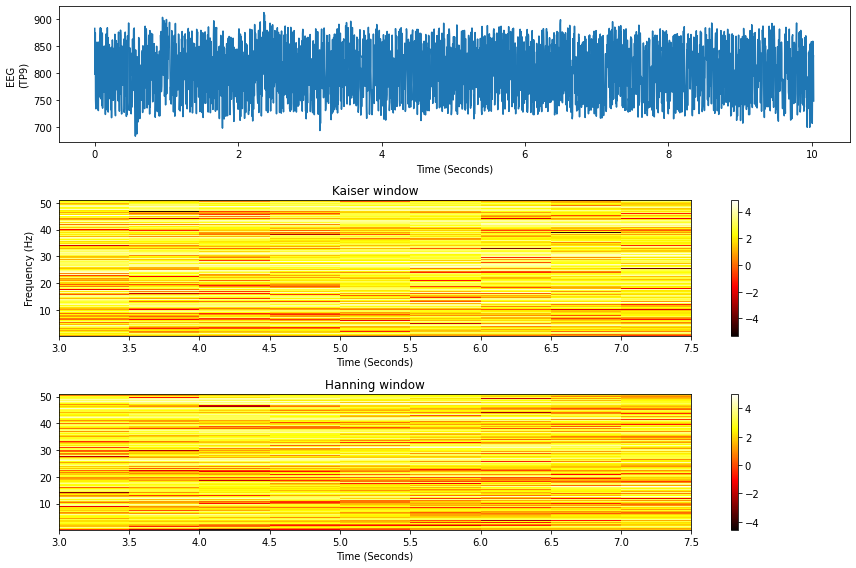

windLength 1280
len(wind) 1280
signal_length 2568
signal_shapeh (2568,)
f.shape = (641,) tt.shape = (11,) Sxx.shape = (641, 11)
windLength 1280
len(wind) 1280
signal_length 2568


<ipython-input-167-1dc447fd05e9>:60: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(tt[1:], f[1:freq_adjust_list[i]], np.log(Sxx[1:freq_adjust_list[i],1:]), cmap='hot') #
<ipython-input-167-1dc447fd05e9>:75: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(tt[1:], f[1:freq_adjust_list[i]], np.log(Sxx[1:freq_adjust_list[i],1:]), cmap='hot')


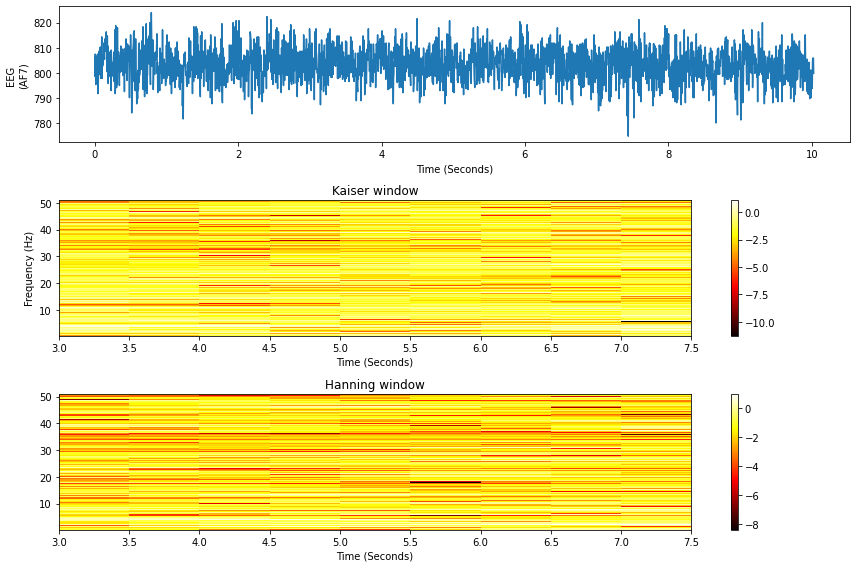

windLength 1280
len(wind) 1280
signal_length 2568
signal_shapeh (2568,)
f.shape = (641,) tt.shape = (11,) Sxx.shape = (641, 11)
windLength 1280
len(wind) 1280
signal_length 2568


<ipython-input-167-1dc447fd05e9>:60: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(tt[1:], f[1:freq_adjust_list[i]], np.log(Sxx[1:freq_adjust_list[i],1:]), cmap='hot') #
<ipython-input-167-1dc447fd05e9>:75: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(tt[1:], f[1:freq_adjust_list[i]], np.log(Sxx[1:freq_adjust_list[i],1:]), cmap='hot')


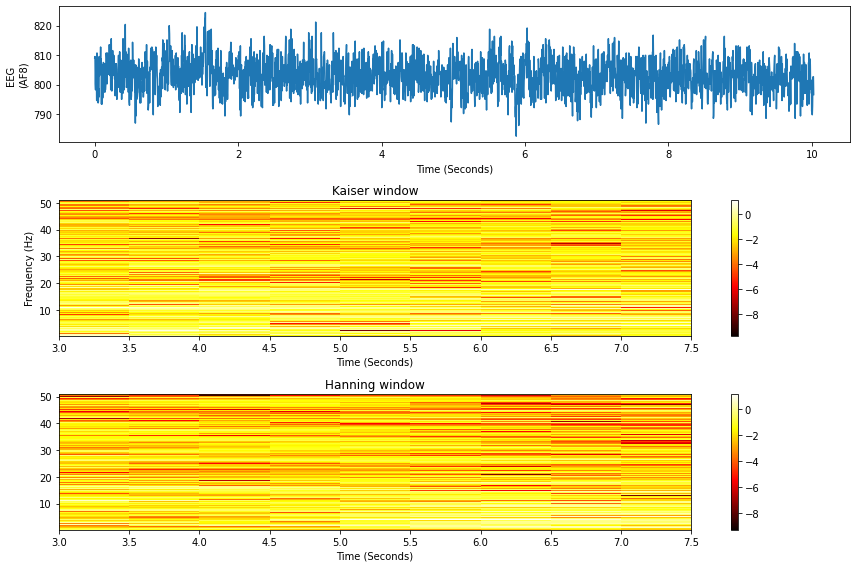

windLength 1280
len(wind) 1280
signal_length 2568
signal_shapeh (2568,)
f.shape = (641,) tt.shape = (11,) Sxx.shape = (641, 11)
windLength 1280
len(wind) 1280
signal_length 2568


<ipython-input-167-1dc447fd05e9>:60: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(tt[1:], f[1:freq_adjust_list[i]], np.log(Sxx[1:freq_adjust_list[i],1:]), cmap='hot') #
<ipython-input-167-1dc447fd05e9>:75: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(tt[1:], f[1:freq_adjust_list[i]], np.log(Sxx[1:freq_adjust_list[i],1:]), cmap='hot')


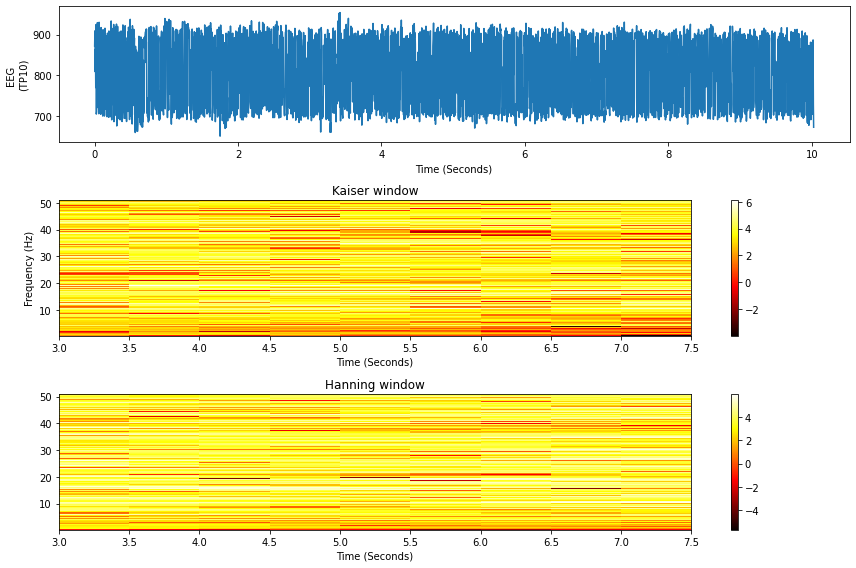

test_sitting_2_59 

windLength 1280
len(wind) 1280
signal_length 2561
signal_shapeh (2561,)
f.shape = (641,) tt.shape = (11,) Sxx.shape = (641, 11)
windLength 1280
len(wind) 1280
signal_length 2561


<ipython-input-167-1dc447fd05e9>:60: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(tt[1:], f[1:freq_adjust_list[i]], np.log(Sxx[1:freq_adjust_list[i],1:]), cmap='hot') #
<ipython-input-167-1dc447fd05e9>:75: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(tt[1:], f[1:freq_adjust_list[i]], np.log(Sxx[1:freq_adjust_list[i],1:]), cmap='hot')


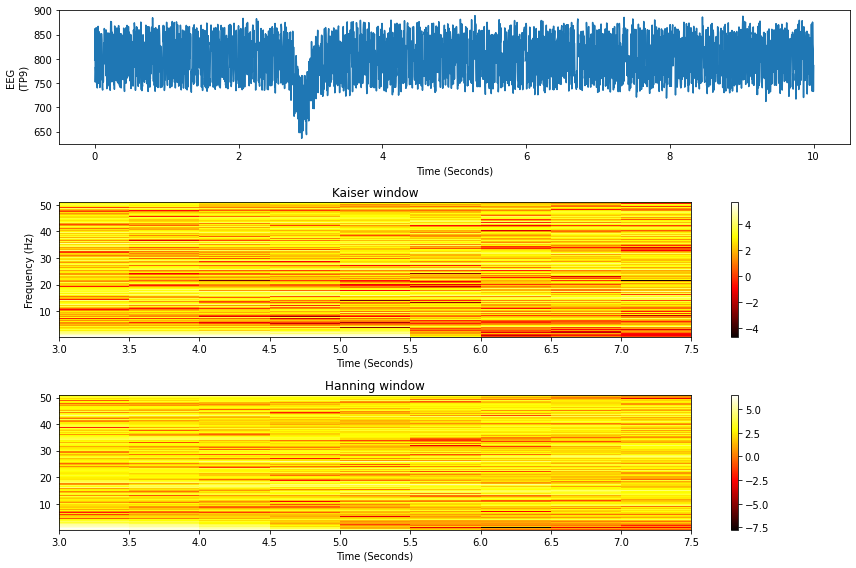

windLength 1280
len(wind) 1280
signal_length 2561
signal_shapeh (2561,)
f.shape = (641,) tt.shape = (11,) Sxx.shape = (641, 11)
windLength 1280
len(wind) 1280
signal_length 2561


<ipython-input-167-1dc447fd05e9>:60: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(tt[1:], f[1:freq_adjust_list[i]], np.log(Sxx[1:freq_adjust_list[i],1:]), cmap='hot') #
<ipython-input-167-1dc447fd05e9>:75: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(tt[1:], f[1:freq_adjust_list[i]], np.log(Sxx[1:freq_adjust_list[i],1:]), cmap='hot')


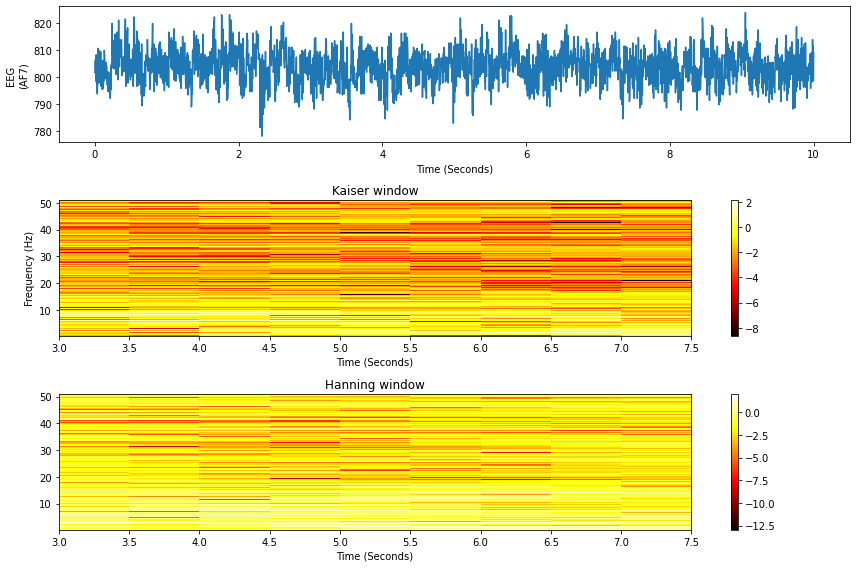

windLength 1280
len(wind) 1280
signal_length 2561
signal_shapeh (2561,)
f.shape = (641,) tt.shape = (11,) Sxx.shape = (641, 11)
windLength 1280
len(wind) 1280
signal_length 2561


<ipython-input-167-1dc447fd05e9>:60: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(tt[1:], f[1:freq_adjust_list[i]], np.log(Sxx[1:freq_adjust_list[i],1:]), cmap='hot') #
<ipython-input-167-1dc447fd05e9>:75: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(tt[1:], f[1:freq_adjust_list[i]], np.log(Sxx[1:freq_adjust_list[i],1:]), cmap='hot')


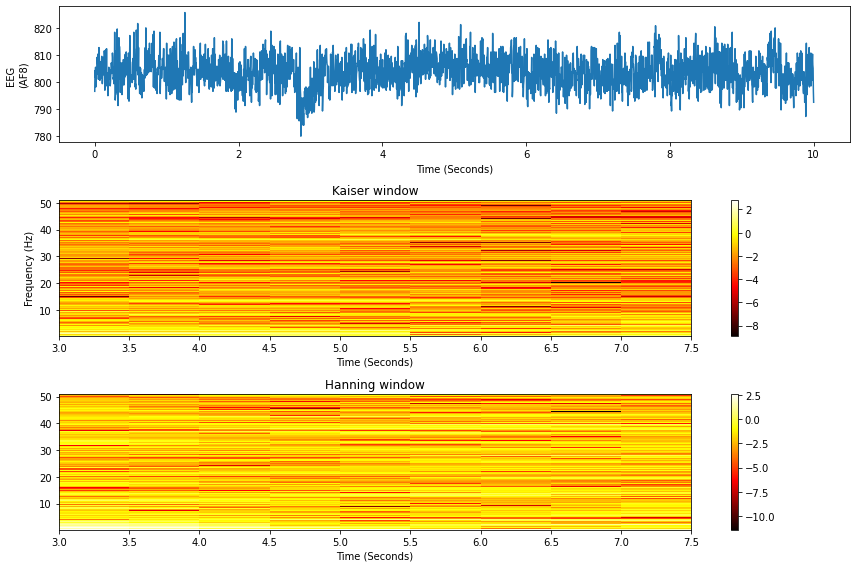

windLength 1280
len(wind) 1280
signal_length 2561
signal_shapeh (2561,)
f.shape = (641,) tt.shape = (11,) Sxx.shape = (641, 11)
windLength 1280
len(wind) 1280
signal_length 2561


<ipython-input-167-1dc447fd05e9>:60: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(tt[1:], f[1:freq_adjust_list[i]], np.log(Sxx[1:freq_adjust_list[i],1:]), cmap='hot') #
<ipython-input-167-1dc447fd05e9>:75: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(tt[1:], f[1:freq_adjust_list[i]], np.log(Sxx[1:freq_adjust_list[i],1:]), cmap='hot')


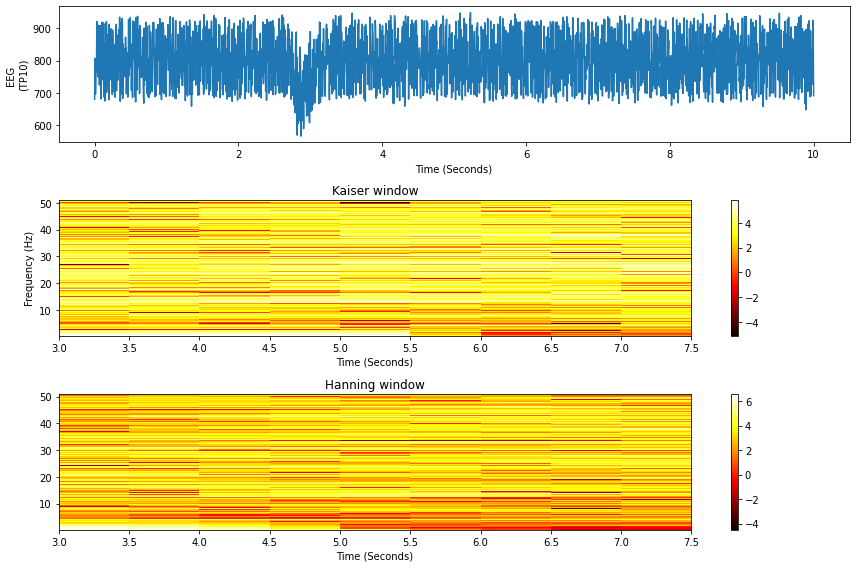

In [174]:
#idx = 0
for idx in [0,-1]:
    print(seg_id_list[idx],'\n')
    plot_spectrograms(
                      signals=[outerList[idx]['tp9'], outerList[idx]['af7'], outerList[idx]['af8'], outerList[idx]['tp10']], 
                      fs_list=[256]*4, 
                      window_len_list = [256*5]*4, 
                      freq_adjust_list = [int(256)]*4,
                      ylabel_list= ['EEG \n(TP9)', 'EEG \n(AF7)','EEG \n(AF8)', 'EEG \n(TP10)',],
                      fig_suptitle='STFT of 0s-10s : '+seg_id_list[idx])

In [233]:
#def test_all_FFT(dur=9.85, start_idx=0):
def test_all_FFT(signals, fs_list, window_len_list, freq_adjust_list, ylabel_list, fig_suptitle, dur=8, start_idx=256):
    # part of this FFT handling code is from Neural Data Science by Erik Nylen Lee and Pascal Wallisch
    fig, ax = plt.subplots(4,1, figsize=[12, 8], sharex=True, constrained_layout=True)
    fig.suptitle(fig_suptitle)
    returnList = []
    for i, signal in enumerate(signals):
        # Test tp9 signal first
        signalName = ylabel_list[i]
        fs = fs_list[i]
        end_idx = 256*9
        signalAndNoise = signal[start_idx:end_idx]
        n = len(signalAndNoise)                            # Determine number of points in time base

        t = np.linspace(0 +(1/fs)/2, 
                        n/fs +(1/fs)/2, 
                        n, 
                        endpoint=False)
        t = t[start_idx:end_idx]


        
        # Now perform and plot Fourier transform

        nyquist = fs/2                                     # Determine the Nyquist frequency (half the sampling rate)
        fSpaceSignal = np.fft.fft(signalAndNoise)/len(t)   #Do the fast Fourier transform, normalized by time
        fBase = np.linspace(0, nyquist, int(np.floor(len(signalAndNoise)/2)+1))    #Create a frequency base

        halfTheSignal = fSpaceSignal[:len(fBase)] # Determine what half the signal is frequency space is
        complexConjugate = np.conj(halfTheSignal) # Take the complex conjugate of that
        powe = halfTheSignal*complexConjugate     # Calculate Power
        forPlotting = np.abs(halfTheSignal**2)
        #forPlotting = forPlotting/np.mean(forPlotting) 
        ax[i].plot(fBase, forPlotting, c='k',lw=2)    # Plot power over the frequency base
        #ax[i].set_xlim([-1, 350]);              #9
        #ax[i].set_xticks(range(20));#10
        ax[i].set_xlabel('Frequency (in Hz)') #11
        ax[i].set_ylabel('Power')

        ax[i].set_title('FFT of ' + signalName)
        #fig.suptitle('FFT of ' + signalName + ', ' + str(dur) + ' second segment')
        returnList.append((fBase,forPlotting))
    plt.show()
    return returnList

test_sitting_2_0 



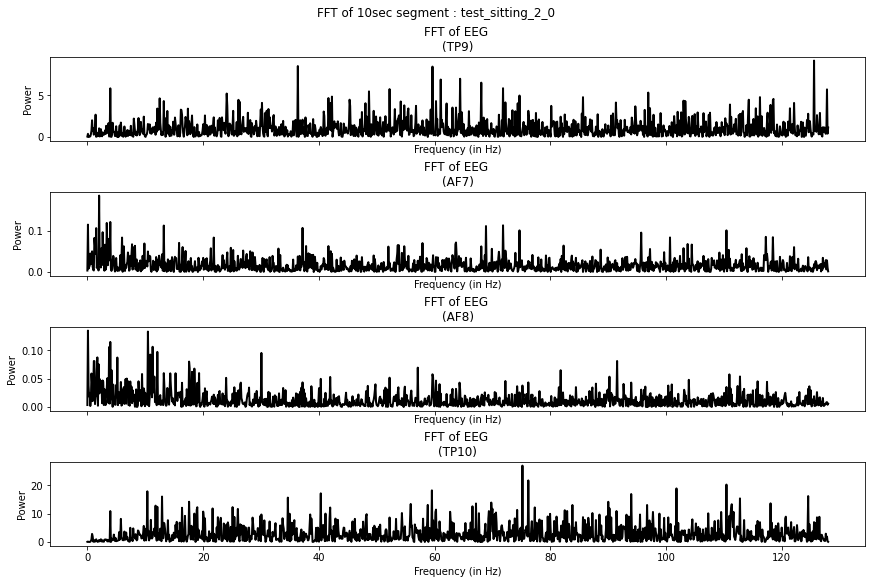

test_sitting_2_59 



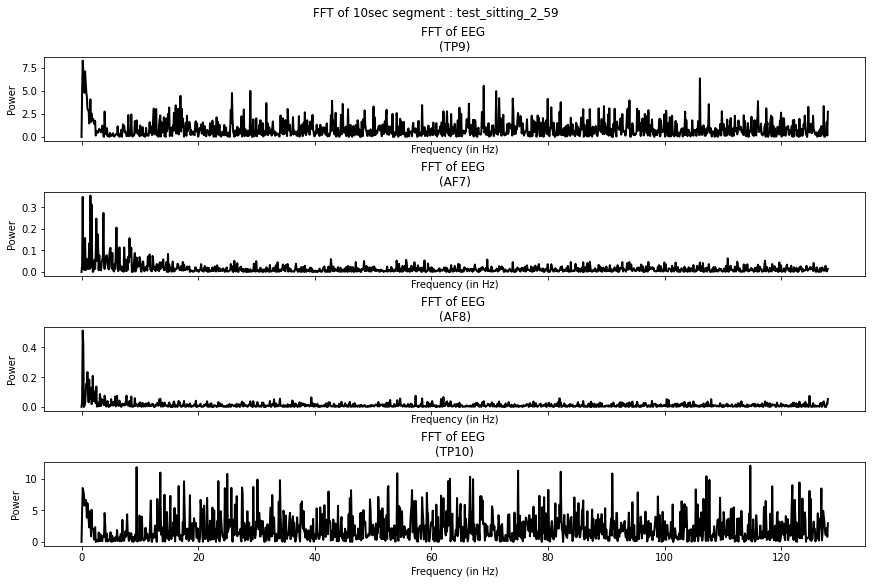

In [188]:
def MMP(pdSeries):
    return pdSeries-pdSeries.mean()

for idx in [0,-1]:
    print(seg_id_list[idx],'\n')
    test_all_FFT(signals=[MMP(outerList[idx]['tp9']), 
                          MMP(outerList[idx]['af7']), 
                          MMP(outerList[idx]['af8']), 
                          MMP(outerList[idx]['tp10'])], 
                      fs_list=[256]*4, 
                      window_len_list = [256*5]*4, 
                      freq_adjust_list = [int(256)]*4,
                      ylabel_list= ['EEG \n(TP9)', 'EEG \n(AF7)','EEG \n(AF8)', 'EEG \n(TP10)',],
                      fig_suptitle='FFT of 10sec segment : '+seg_id_list[idx])
    time.sleep(1)

In [197]:
from scipy.signal import butter, lfilter


def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a


def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    y = lfilter(b, a, data)
    return y

def BP(signal, lowcut=2, highcut=80, fs=256, order=3):
    return butter_bandpass_filter(signal, lowcut, highcut, fs, order=3)

def BANDPASS(signal):
    # code from Warren Weckesser on
    # https://stackoverflow.com/questions/12093594/how-to-implement-band-pass-butterworth-filter-with-scipy-signal-butter
    


    if __name__ == "__main__":
        import numpy as np
        import matplotlib.pyplot as plt
        from scipy.signal import freqz

        # Sample rate and desired cutoff frequencies (in Hz).
        fs = 256
        lowcut = 2
        highcut = 80

        # Plot the frequency response for a few different orders.
        plt.figure(1)
        plt.clf()
        for order in [3, 6, 9]:
            b, a = butter_bandpass(lowcut, highcut, fs, order=order)
            w, h = freqz(b, a, worN=2000)
            plt.plot((fs * 0.5 / np.pi) * w, abs(h), label="order = %d" % order)

        plt.plot([0, 0.5 * fs], [np.sqrt(0.5), np.sqrt(0.5)],
                 '--', label='sqrt(0.5)')
        plt.xlabel('Frequency (Hz)')
        plt.ylabel('Gain')
        plt.grid(True)
        plt.legend(loc='best')

        # Filter a noisy signal.
        T = 9.85
        nsamples = int(T * fs)
        t = np.linspace(0, T, nsamples, endpoint=False)
        x = signal[:nsamples]
        plt.figure(2)
        plt.clf()
        plt.plot(t, x, label='Noisy signal')

        y = butter_bandpass_filter(x, lowcut, highcut, fs, order=3)
        plt.plot(t, y, label='Filtered signal')
        plt.xlabel('time (seconds)')
        plt.hlines([-a, a], 0, T, linestyles='--')
        plt.grid(True)
        plt.axis('tight')
        plt.legend(loc='upper left')

        plt.show()


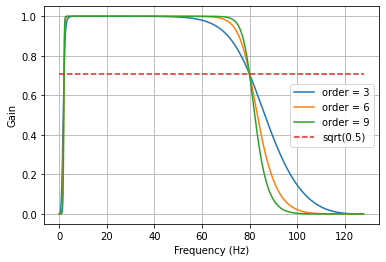

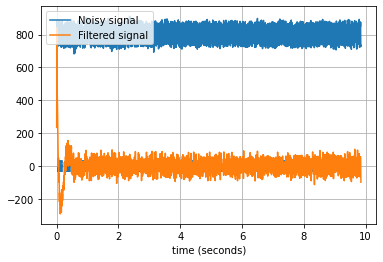

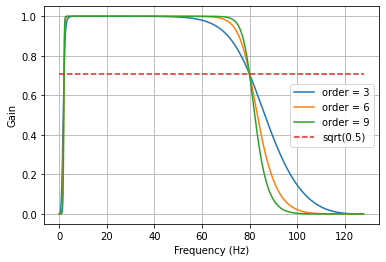

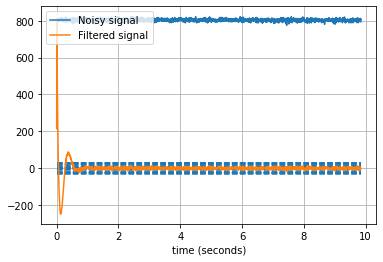

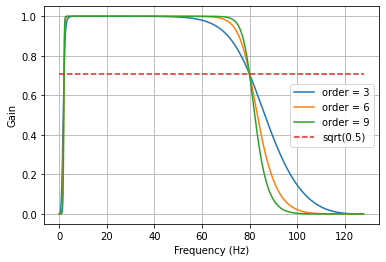

...

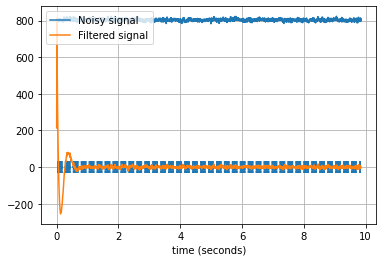

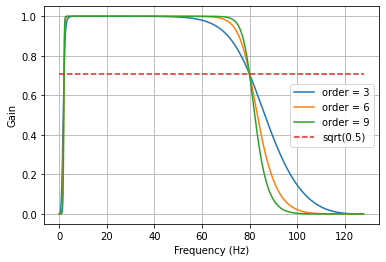

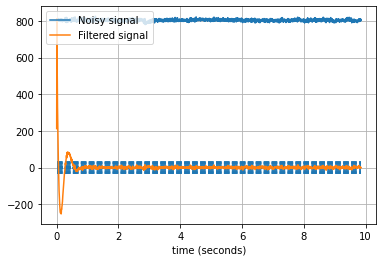

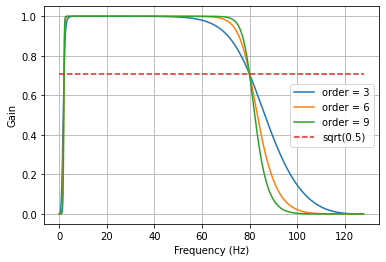

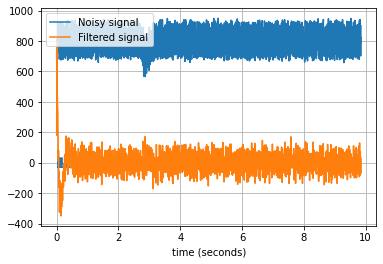

In [195]:
for i in [0,-1]:
    for ch in ['tp9','af7','af8','tp10']:
        BANDPASS(outerList[i][ch])    

test_sitting_2_0 



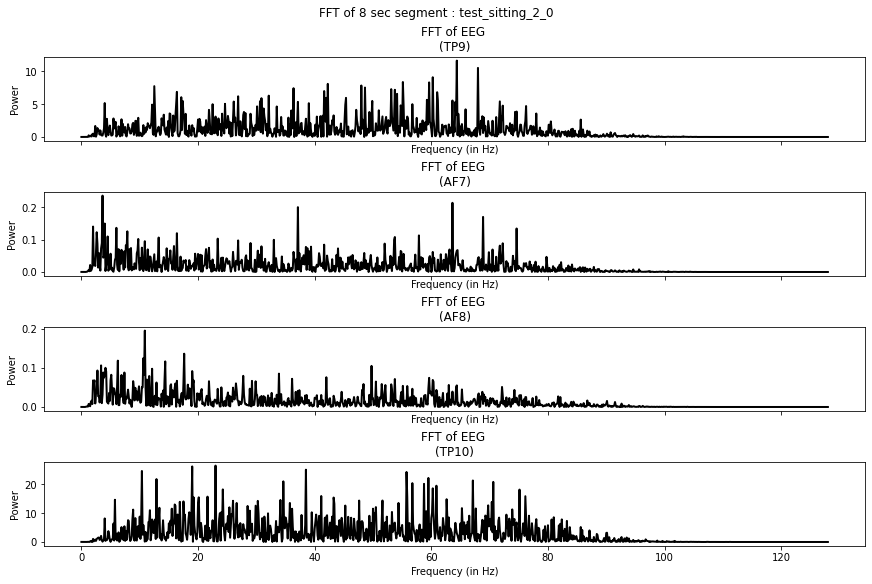

test_sitting_2_1 



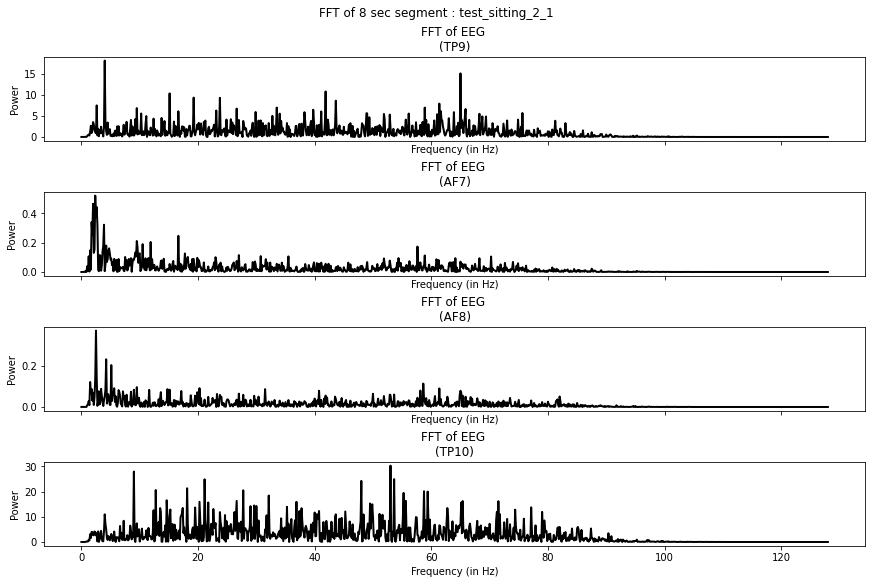

test_sitting_2_2 



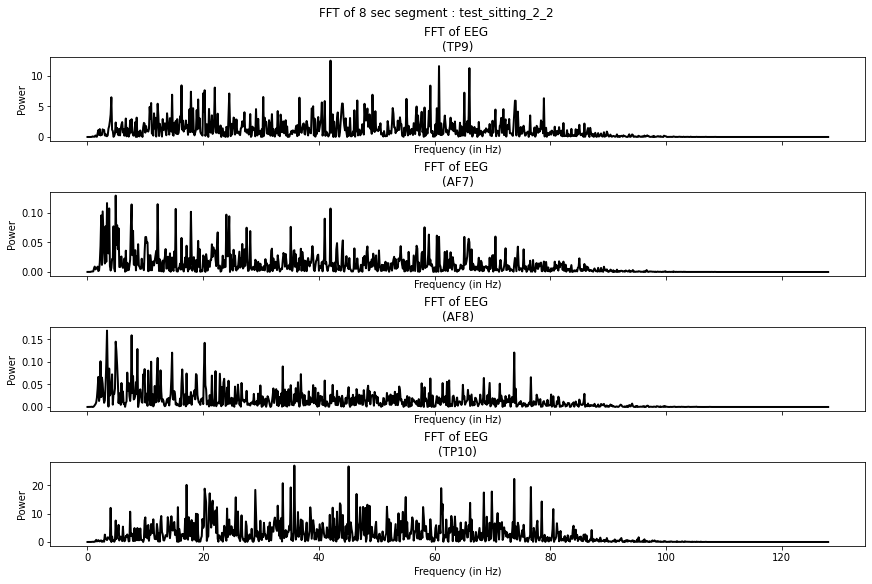

test_sitting_2_3 



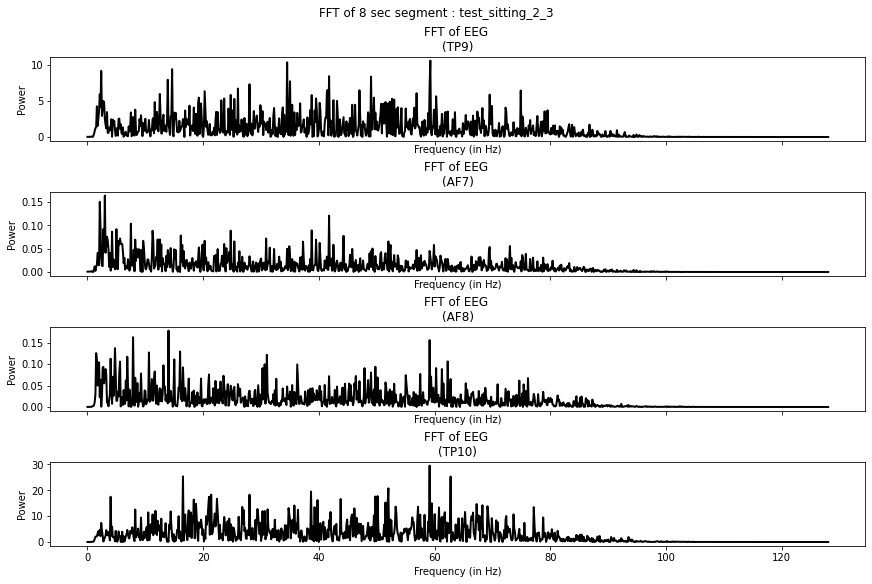

test_sitting_2_4 



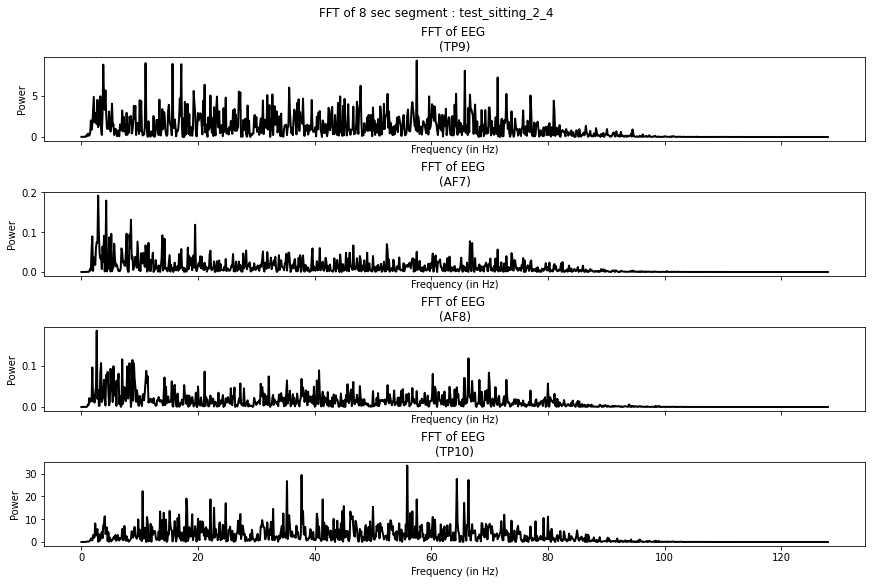

test_sitting_2_5 



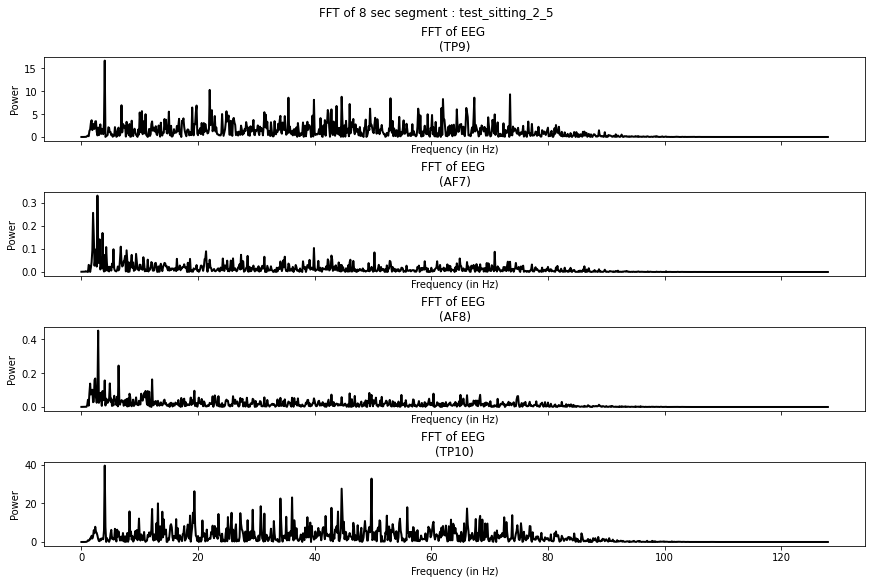

test_sitting_2_6 



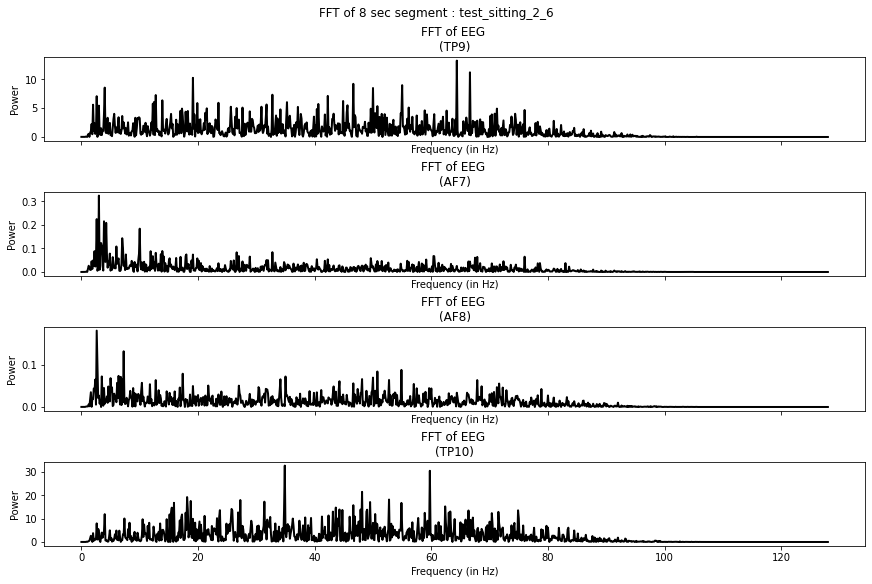

test_sitting_2_7 



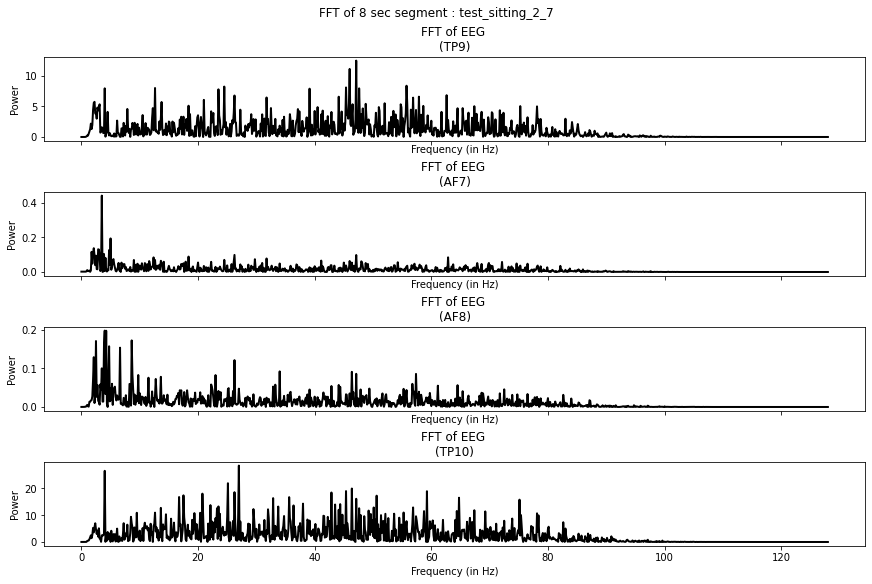

test_sitting_2_8 



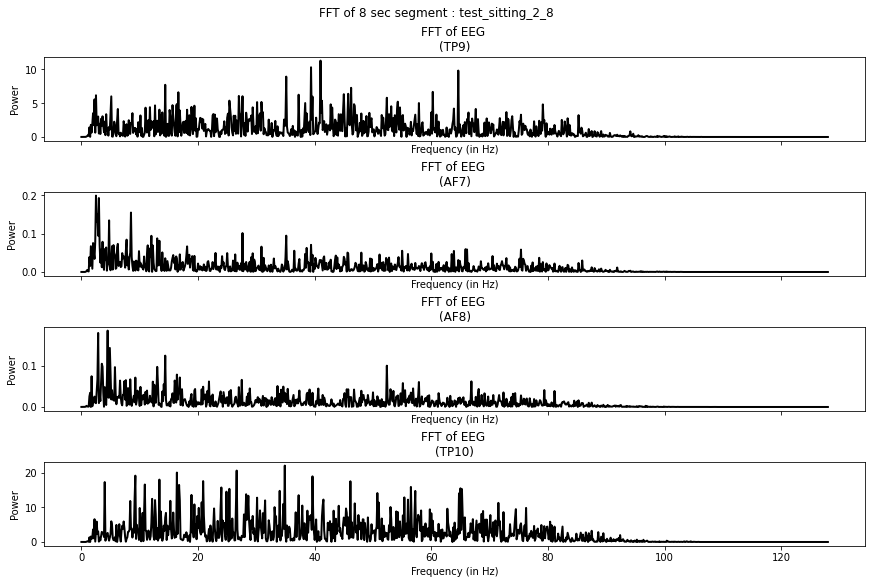

test_sitting_2_10 



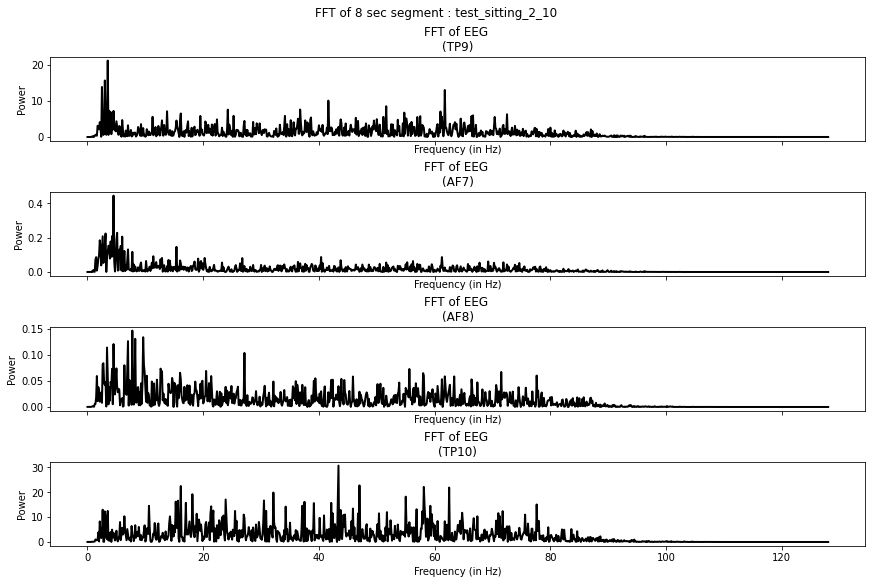

test_sitting_2_11 



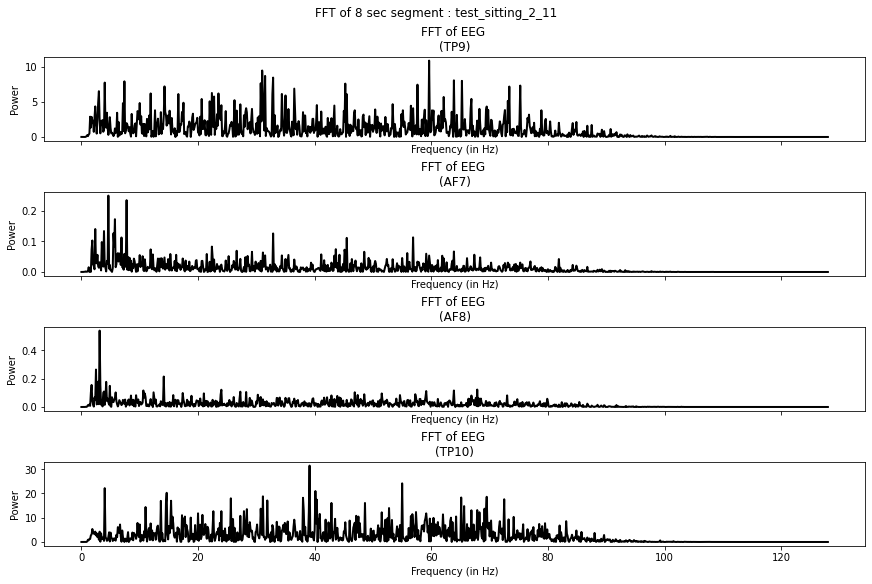

test_sitting_2_12 



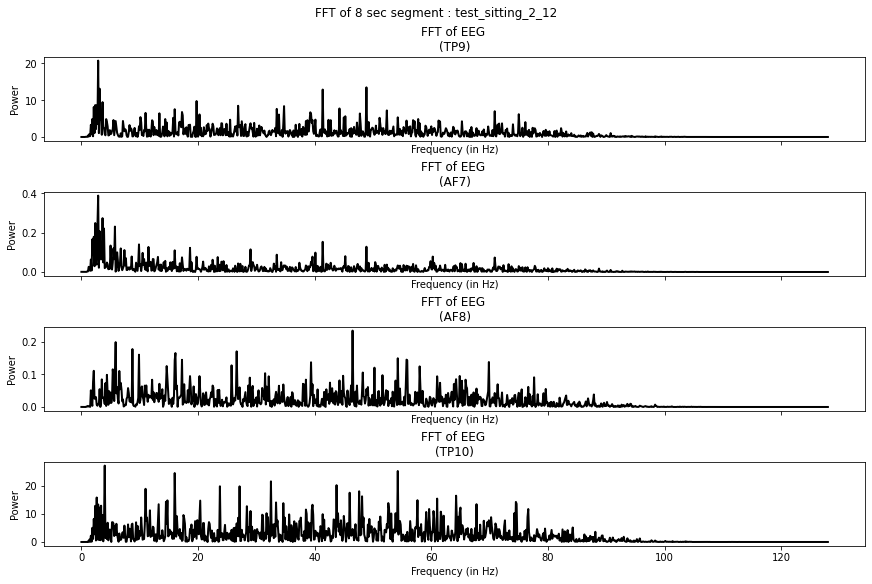

test_sitting_2_13 



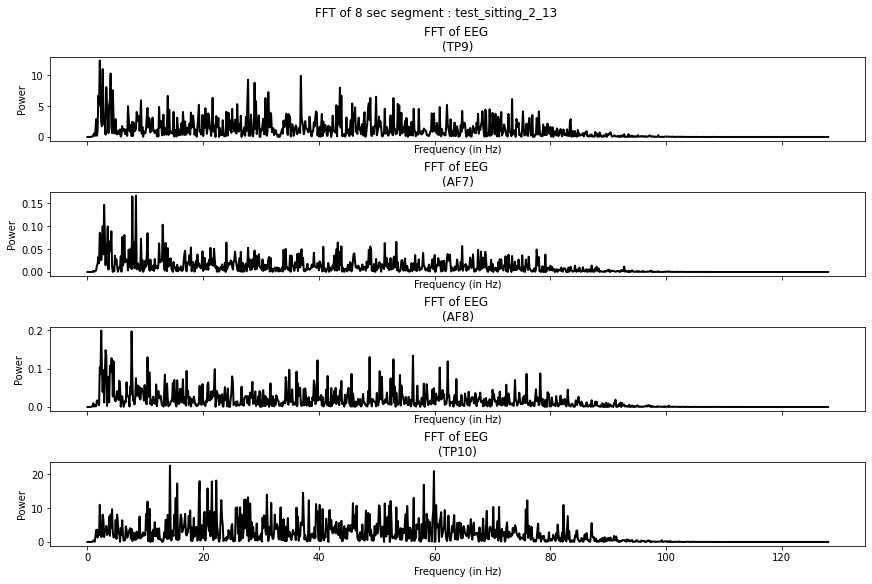

test_sitting_2_14 



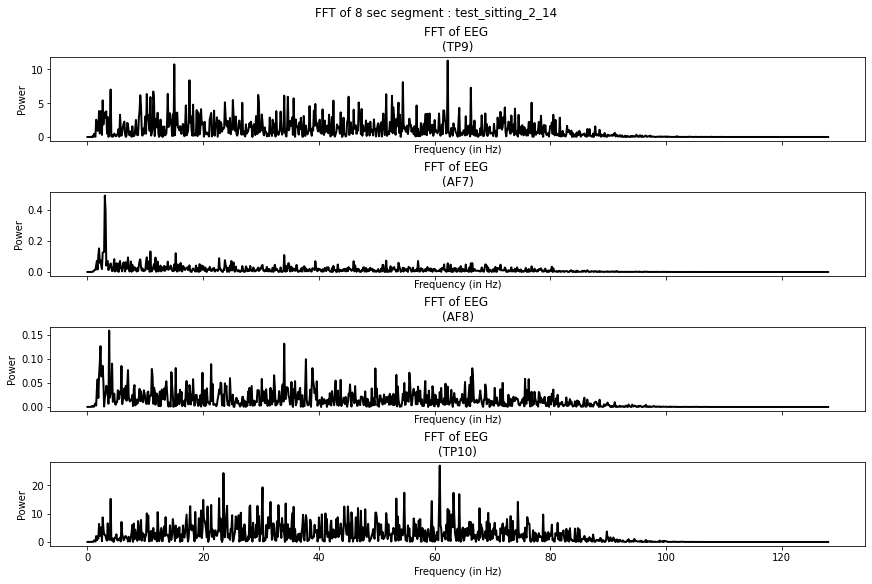

test_sitting_2_15 



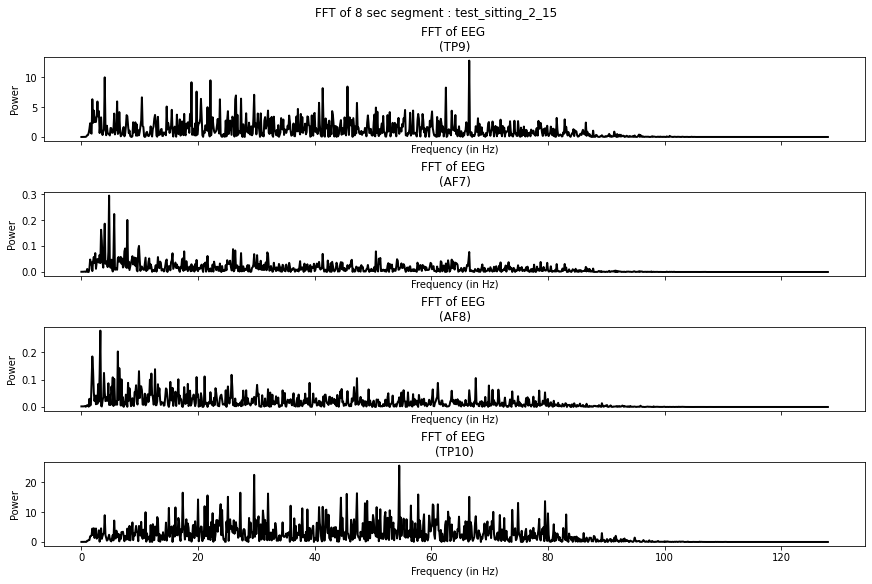

test_sitting_2_16 



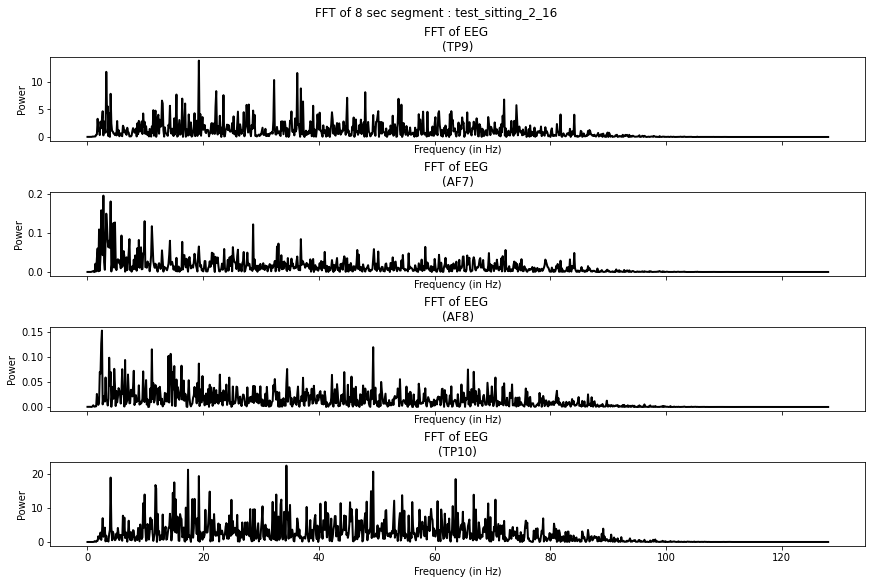

test_sitting_2_18 



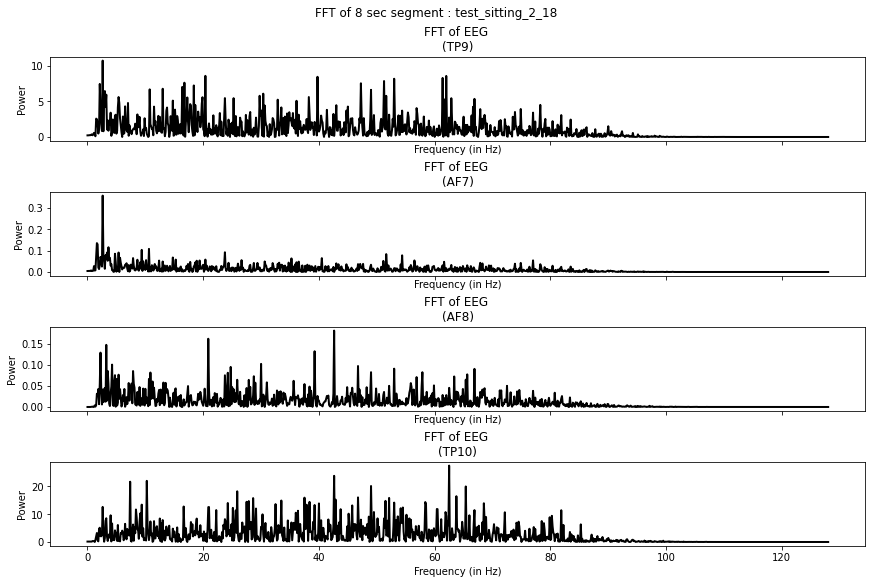

test_sitting_2_19 



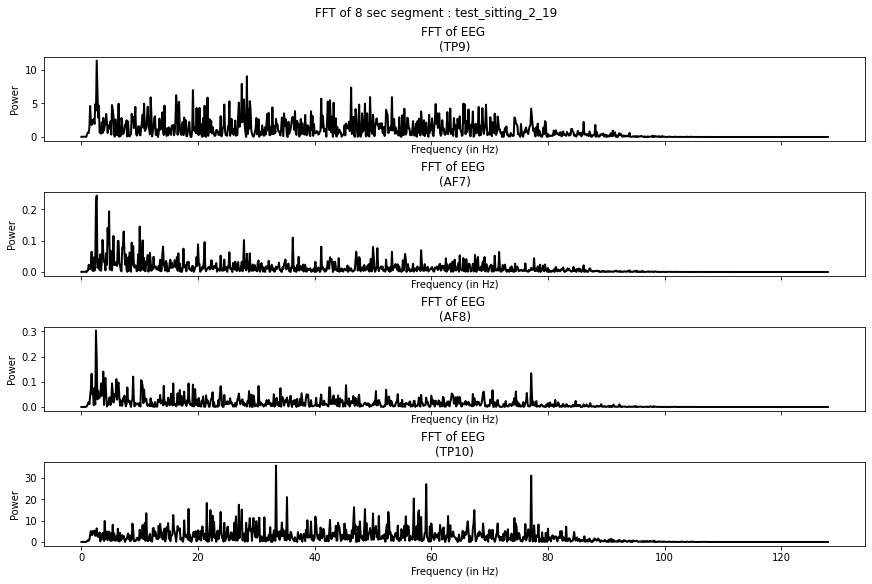

test_sitting_2_20 



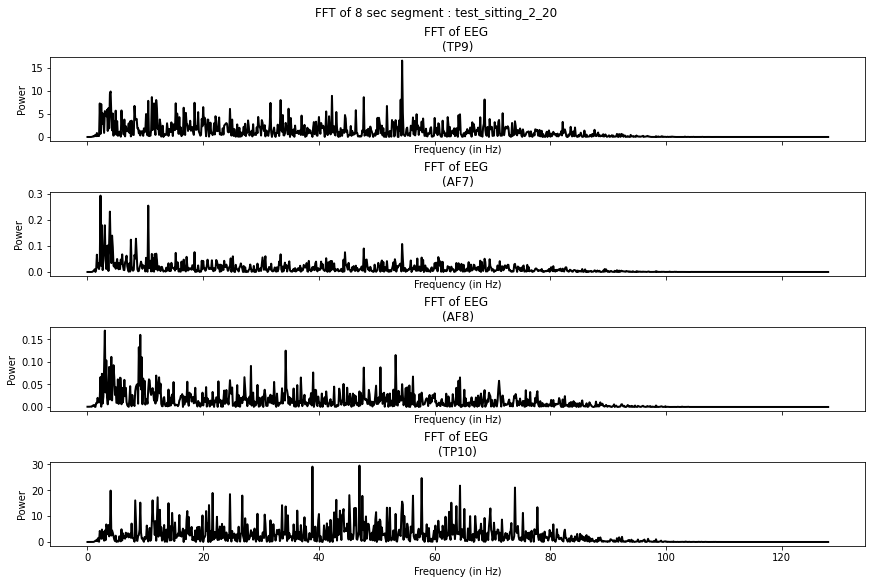

test_sitting_2_21 



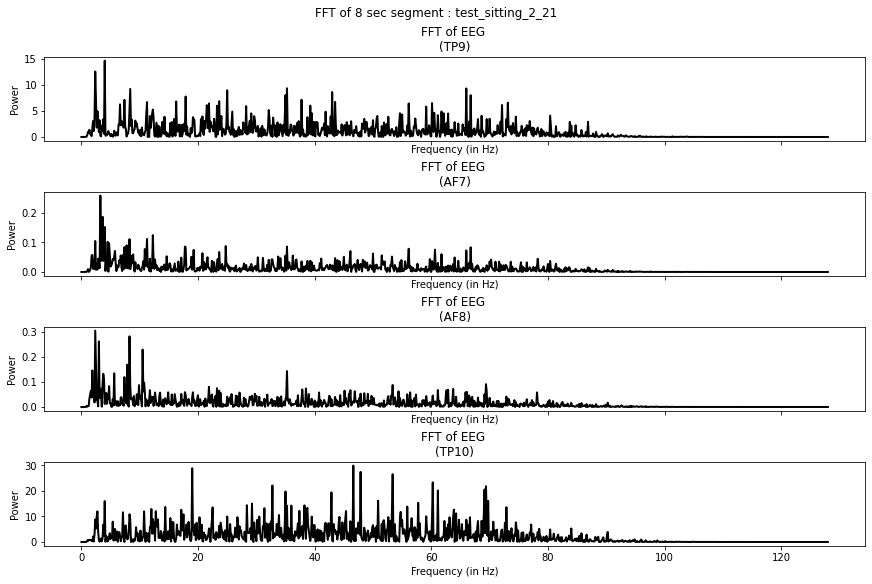

test_sitting_2_22 



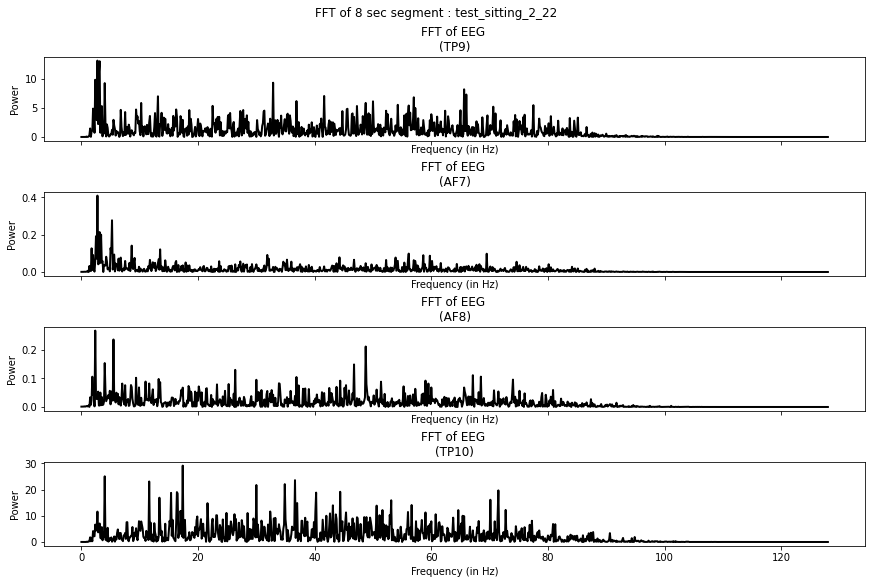

test_sitting_2_23 



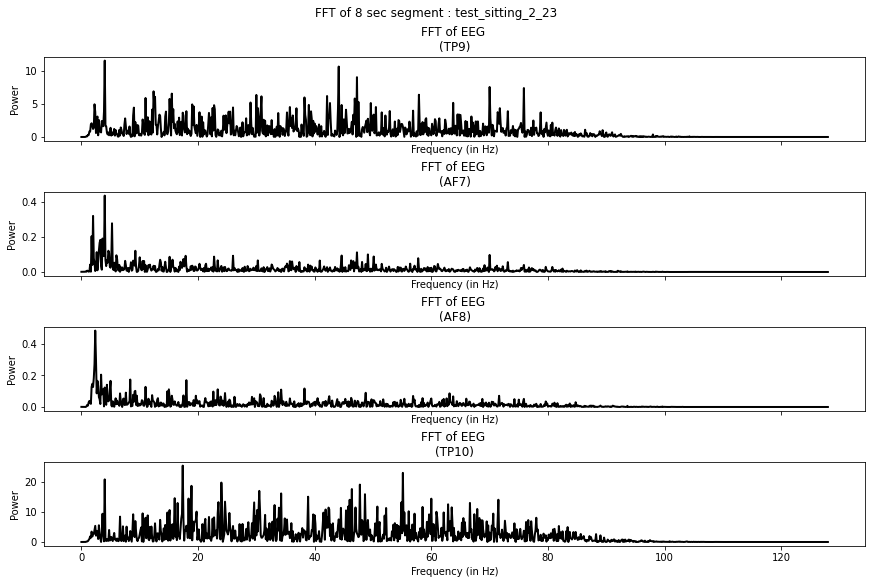

test_sitting_2_24 



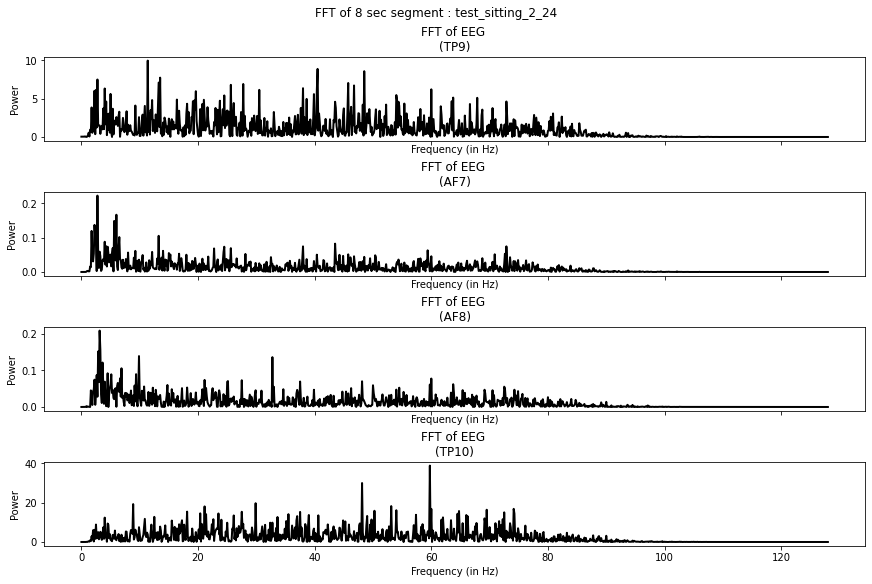

test_sitting_2_25 



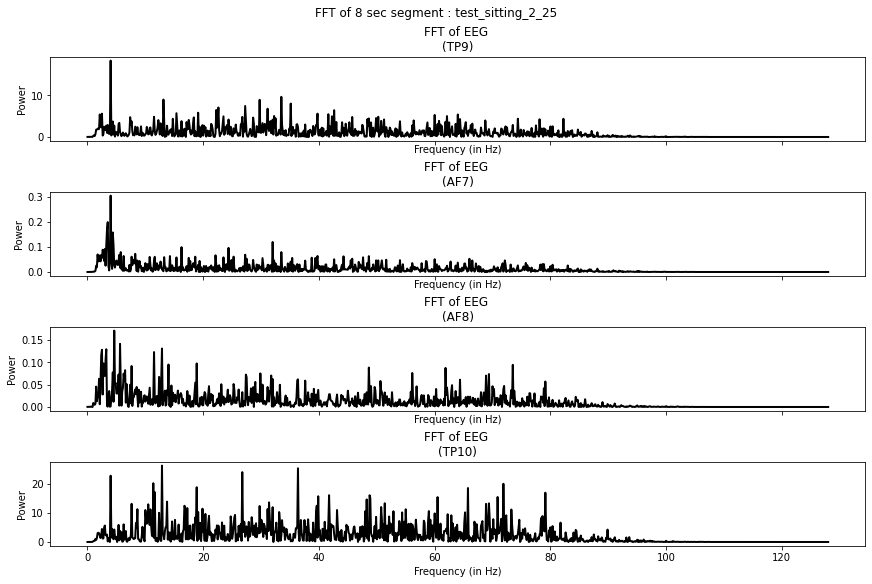

test_sitting_2_26 



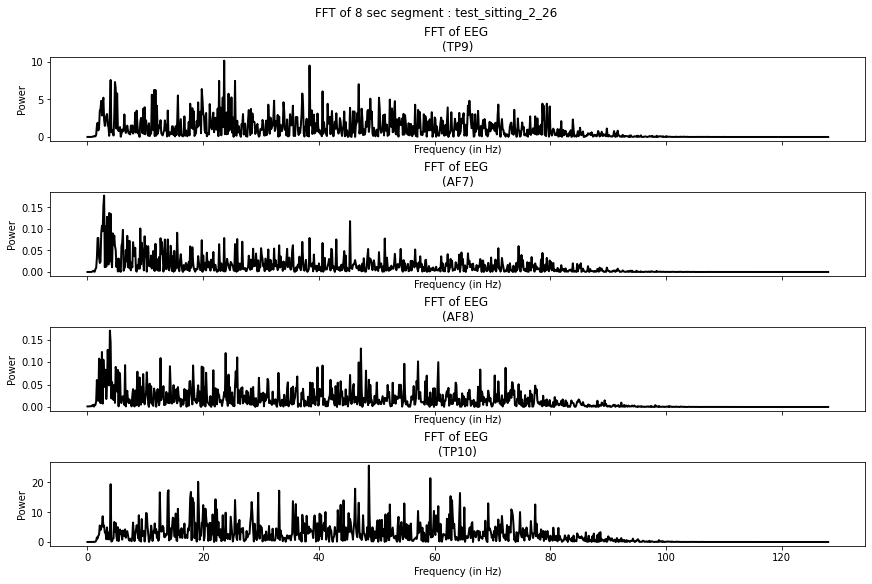

test_sitting_2_27 



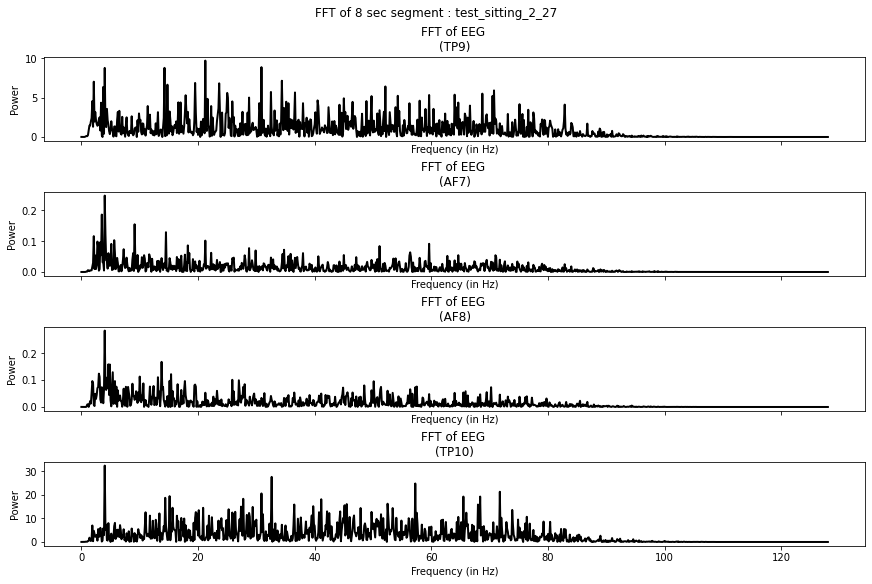

test_sitting_2_28 



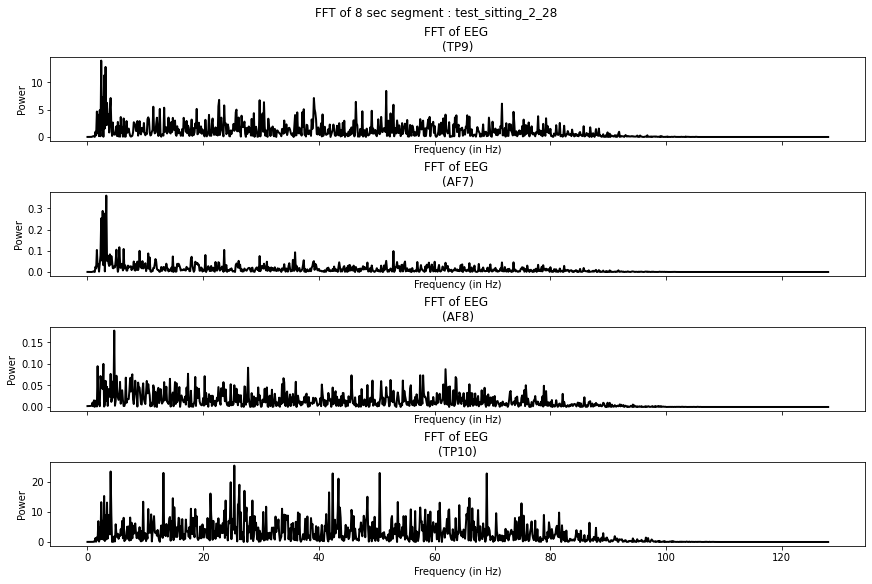

test_sitting_2_31 



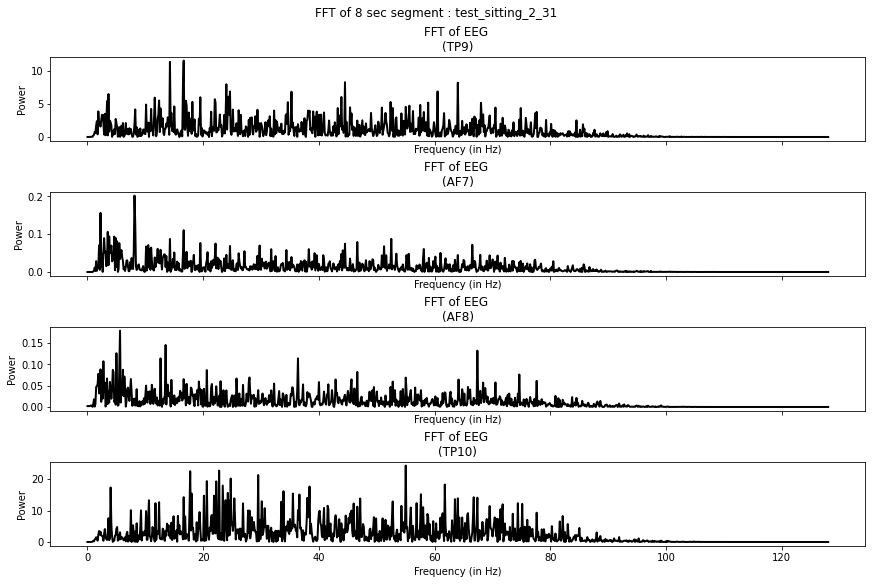

test_sitting_2_32 



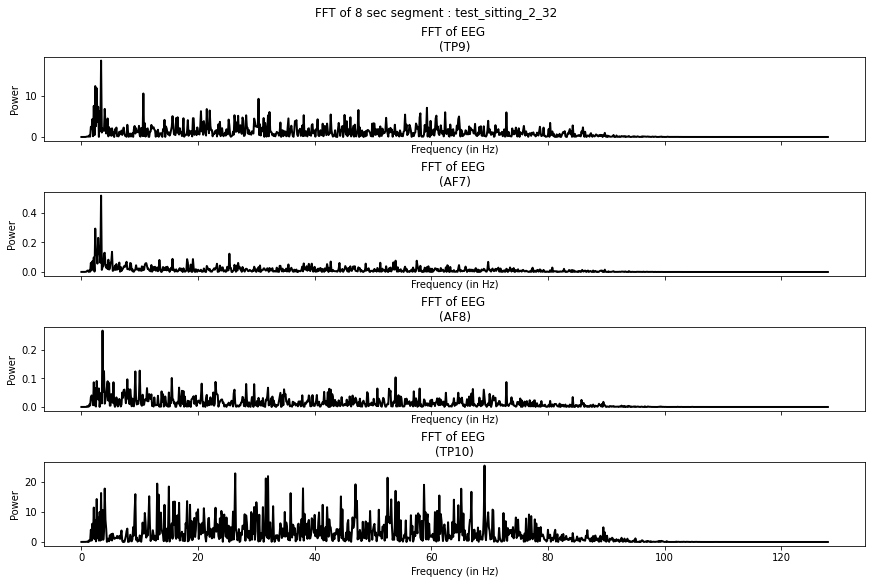

test_sitting_2_35 



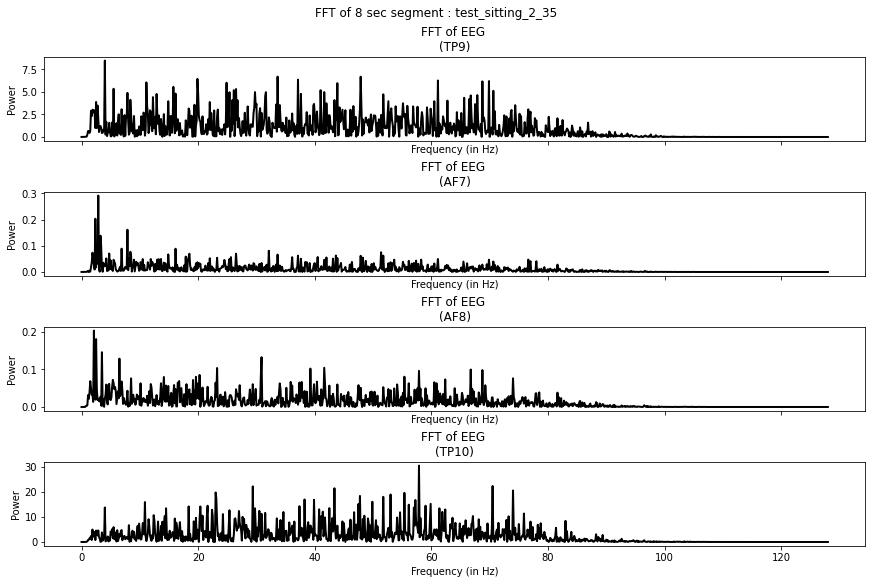

test_sitting_2_36 



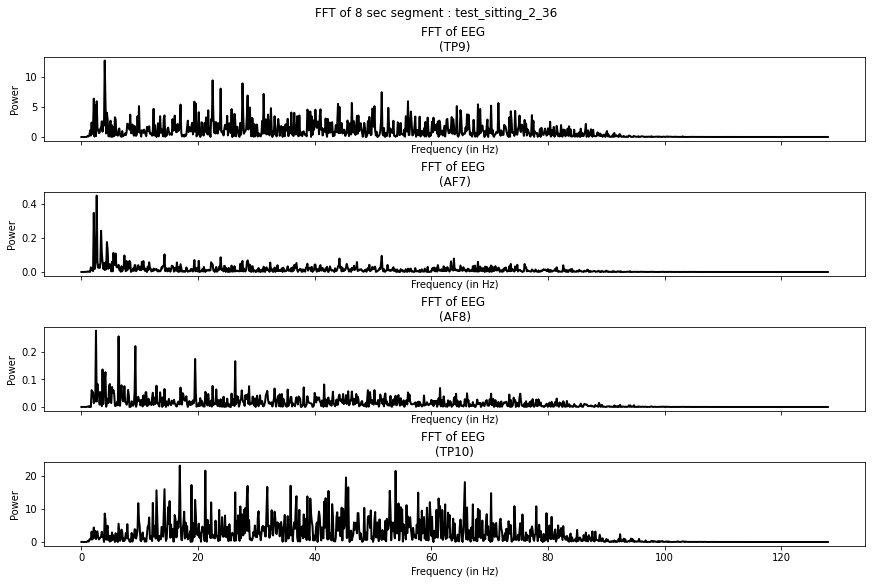

test_sitting_2_37 



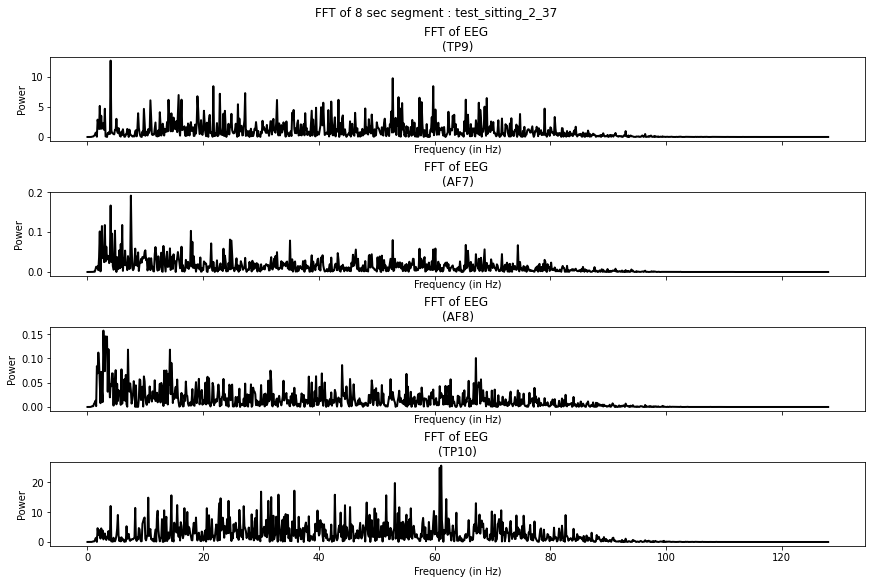

test_sitting_2_38 



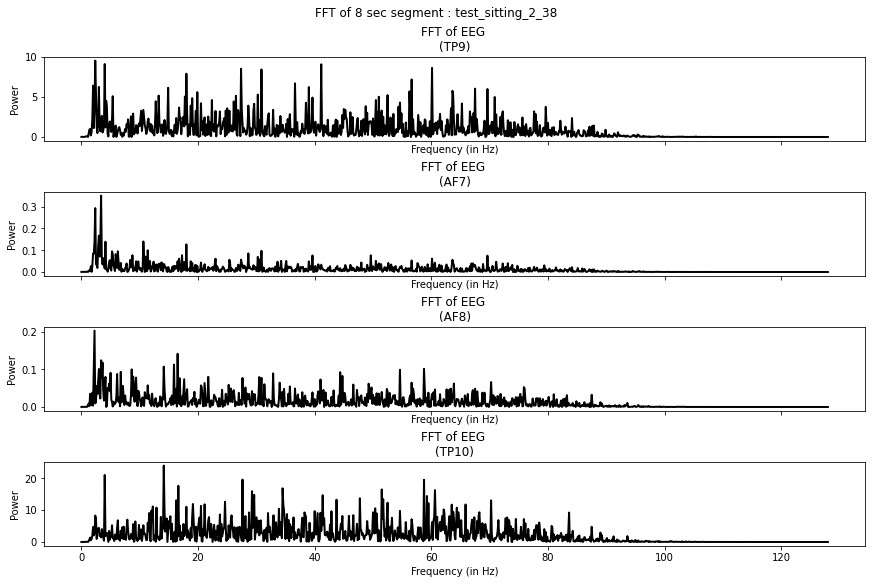

test_sitting_2_41 



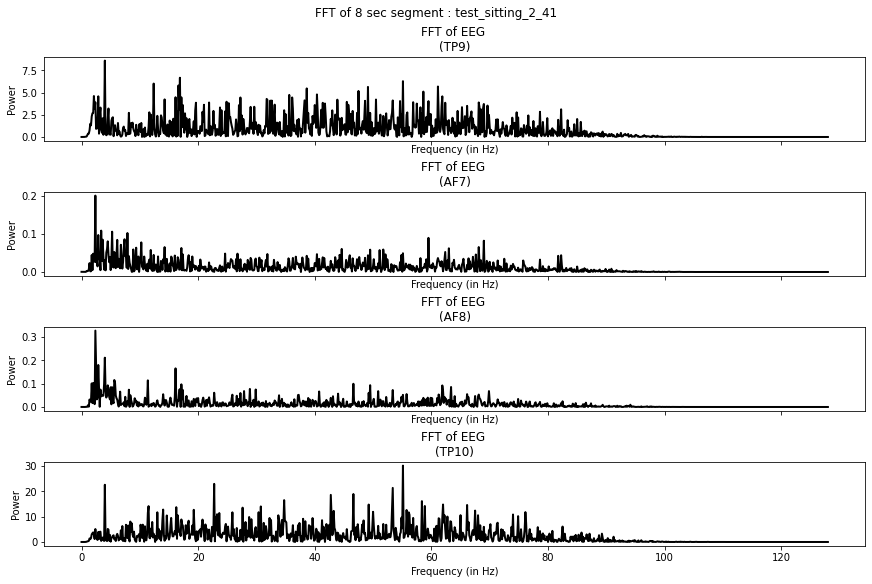

test_sitting_2_43 



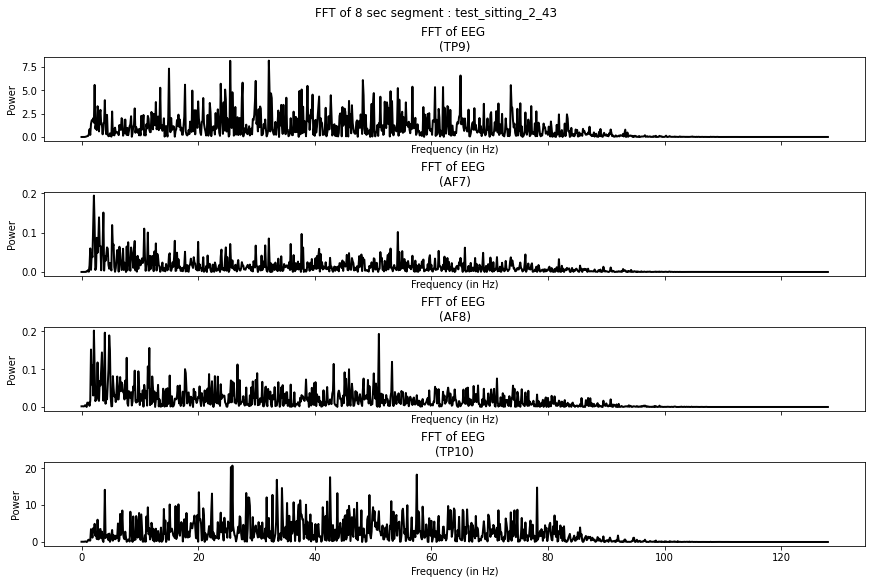

test_sitting_2_44 



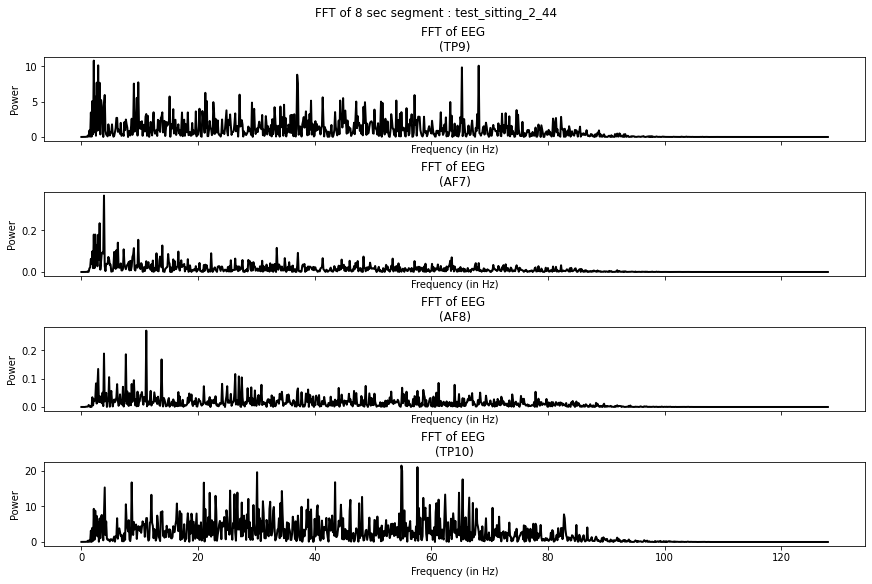

test_sitting_2_45 



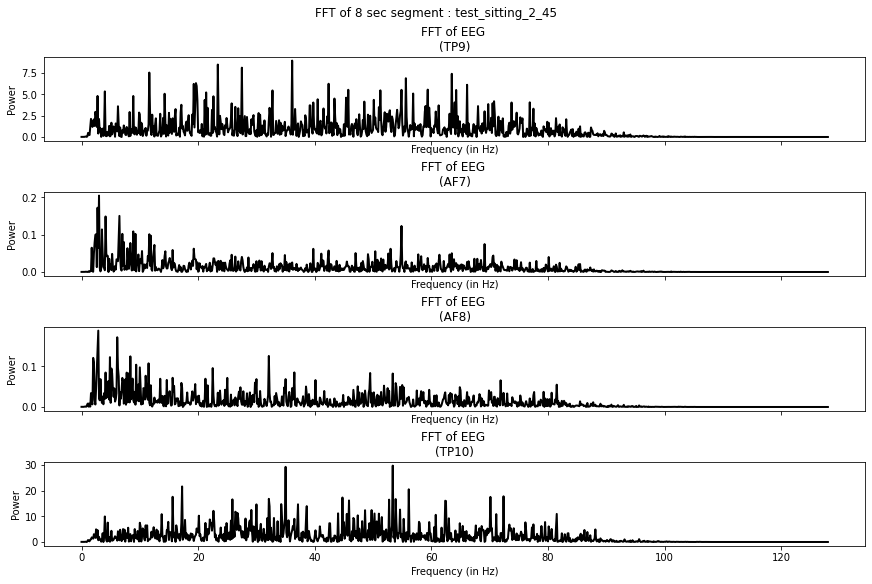

test_sitting_2_46 



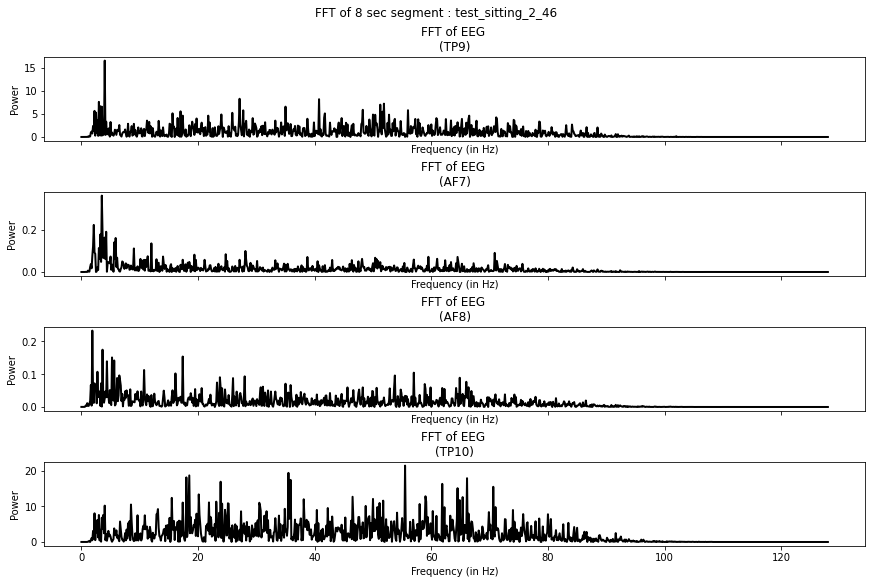

test_sitting_2_47 



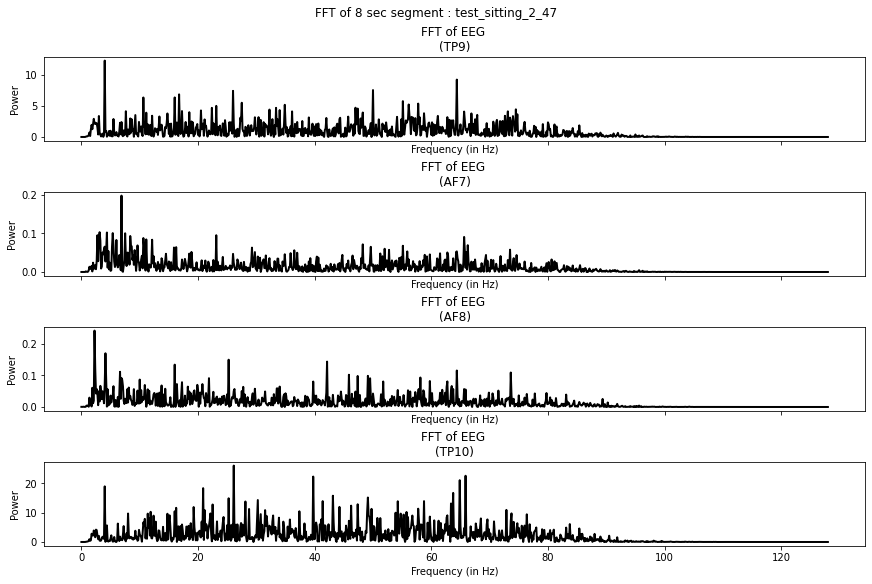

test_sitting_2_48 



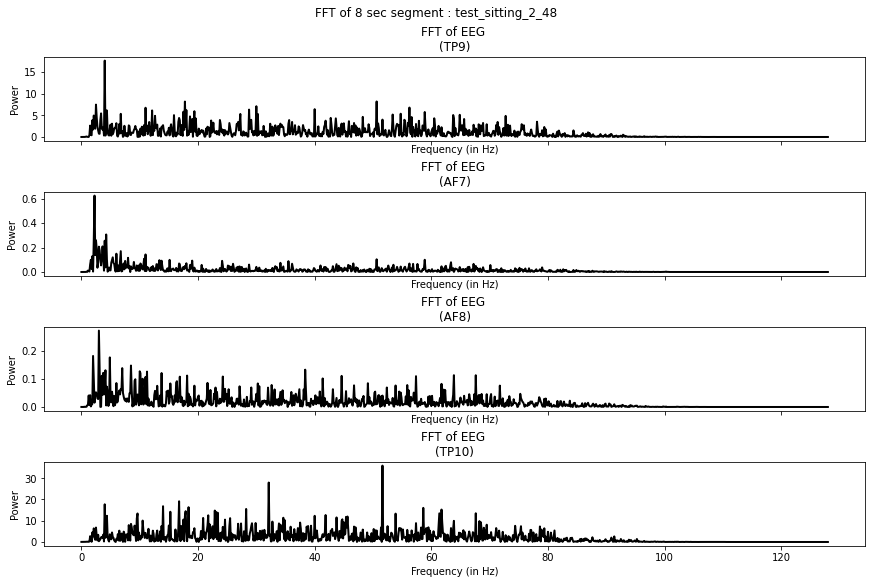

test_sitting_2_50 



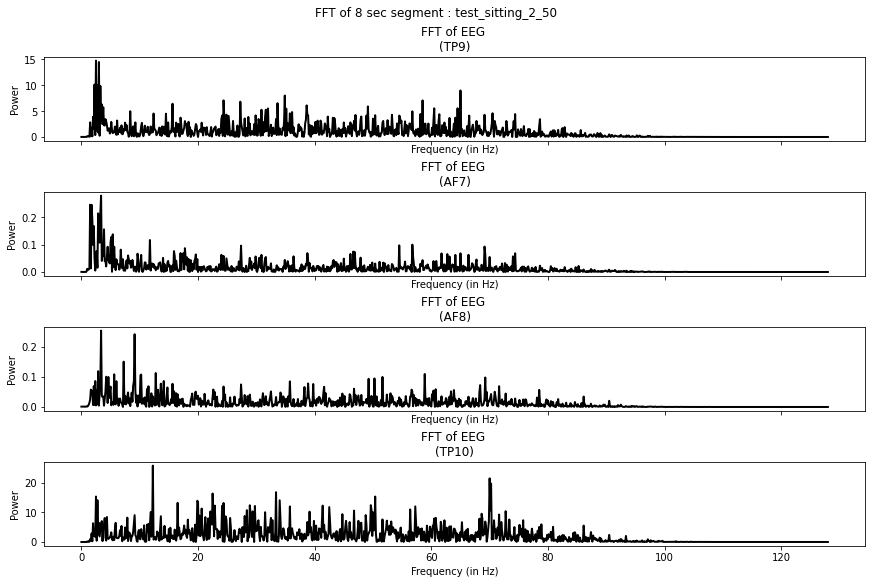

test_sitting_2_51 



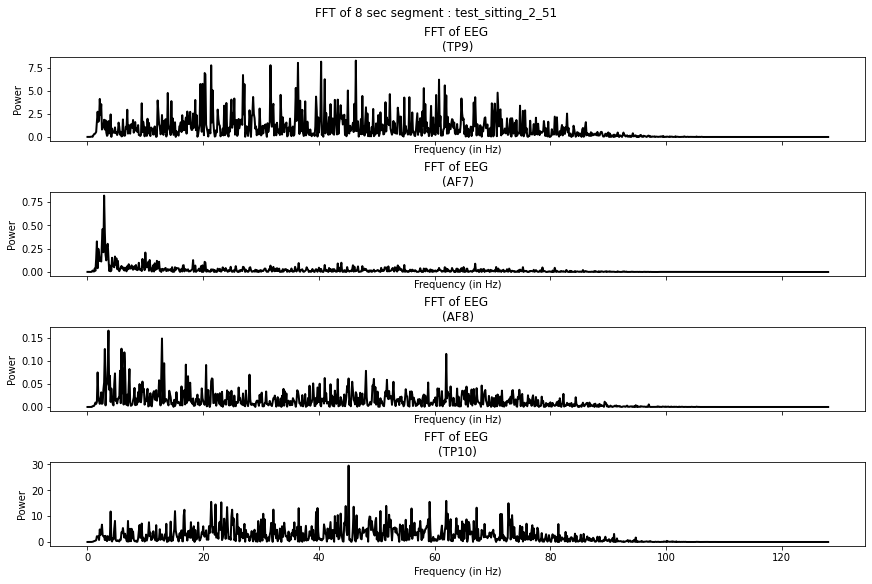

test_sitting_2_52 



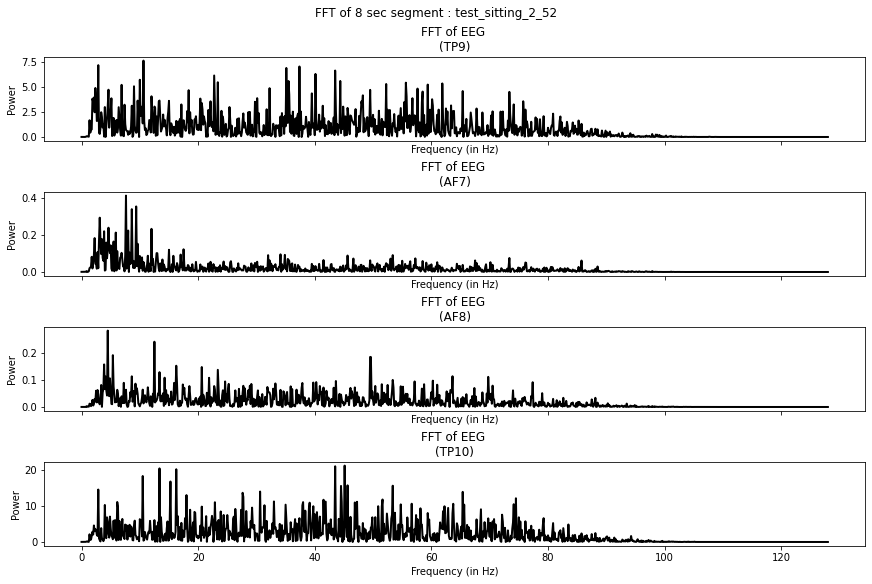

test_sitting_2_53 



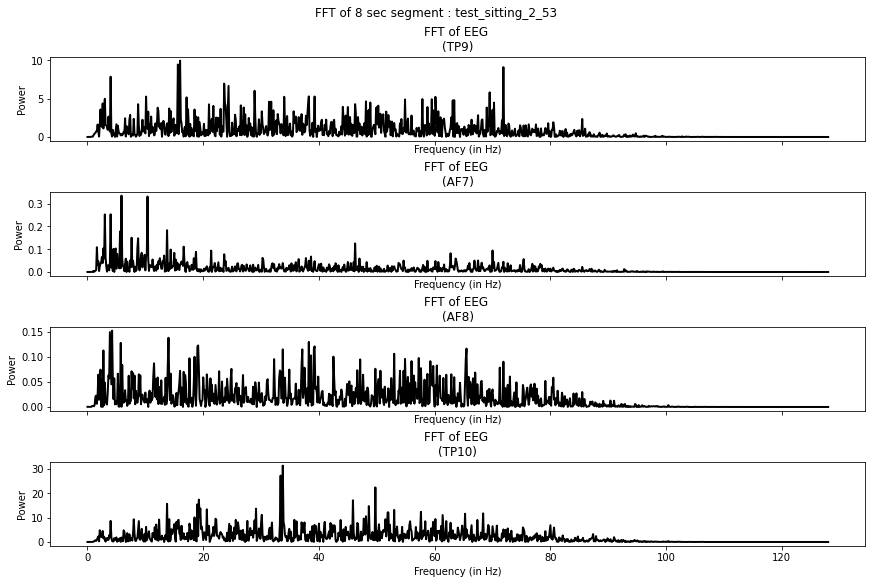

test_sitting_2_54 



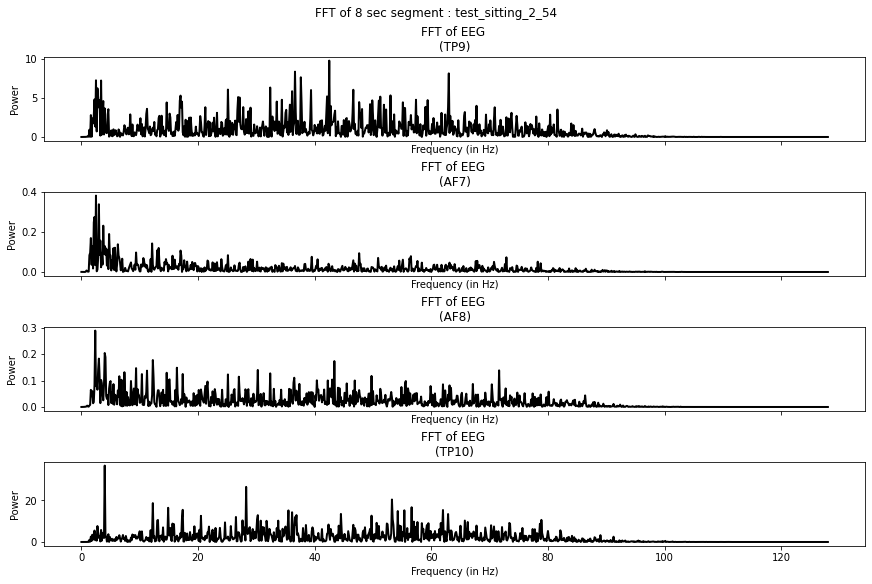

test_sitting_2_55 



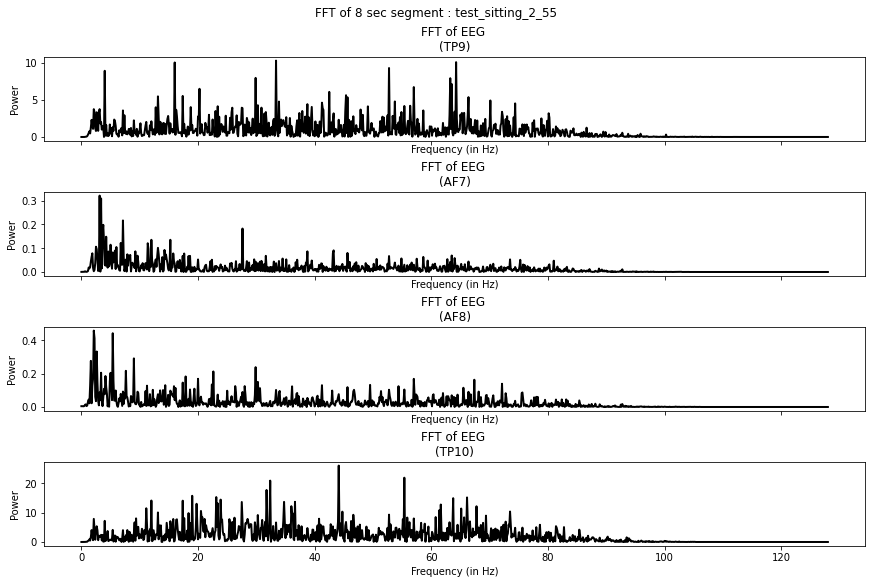

test_sitting_2_58 



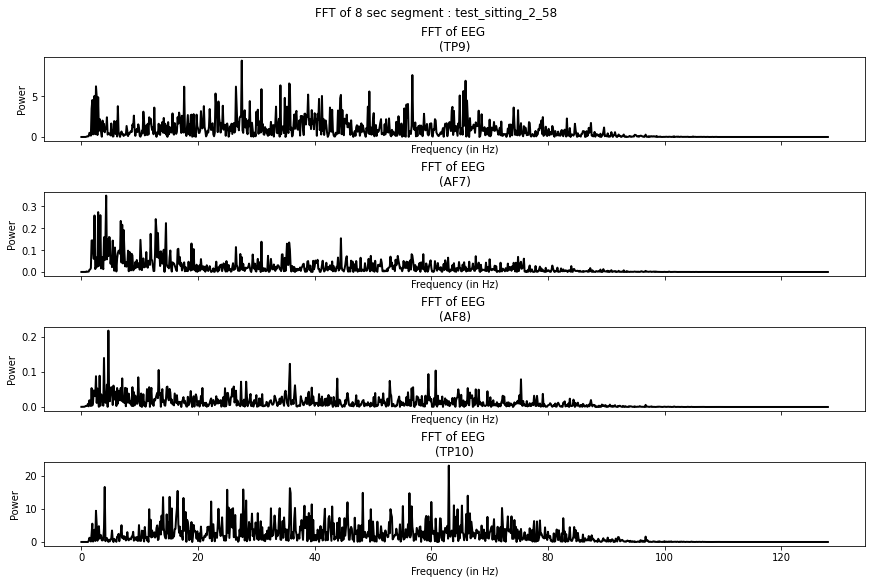

test_sitting_2_59 



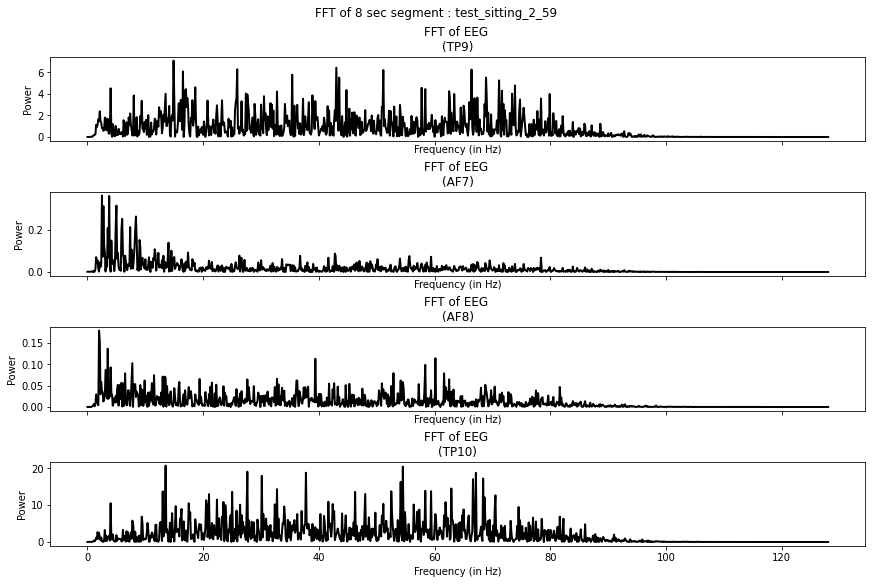

48
dict_keys(['test_sitting_2_0', 'test_sitting_2_1', 'test_sitting_2_2', 'test_sitting_2_3', 'test_sitting_2_4', 'test_sitting_2_5', 'test_sitting_2_6', 'test_sitting_2_7', 'test_sitting_2_8', 'test_sitting_2_10', 'test_sitting_2_11', 'test_sitting_2_12', 'test_sitting_2_13', 'test_sitting_2_14', 'test_sitting_2_15', 'test_sitting_2_16', 'test_sitting_2_18', 'test_sitting_2_19', 'test_sitting_2_20', 'test_sitting_2_21', 'test_sitting_2_22', 'test_sitting_2_23', 'test_sitting_2_24', 'test_sitting_2_25', 'test_sitting_2_26', 'test_sitting_2_27', 'test_sitting_2_28', 'test_sitting_2_31', 'test_sitting_2_32', 'test_sitting_2_35', 'test_sitting_2_36', 'test_sitting_2_37', 'test_sitting_2_38', 'test_sitting_2_41', 'test_sitting_2_43', 'test_sitting_2_44', 'test_sitting_2_45', 'test_sitting_2_46', 'test_sitting_2_47', 'test_sitting_2_48', 'test_sitting_2_50', 'test_sitting_2_51', 'test_sitting_2_52', 'test_sitting_2_53', 'test_sitting_2_54', 'test_sitting_2_55', 'test_sitting_2_58', 'test_si

In [234]:
valsDict = dict()
for idx in range(len(seg_id_list)):
    print(seg_id_list[idx],'\n')
    vals = test_all_FFT(signals=[BP(outerList[idx]['tp9']), 
                          BP(outerList[idx]['af7']), 
                          BP(outerList[idx]['af8']), 
                          BP(outerList[idx]['tp10'])], 
                      fs_list=[256]*4, 
                      window_len_list = [256*5]*4, 
                      freq_adjust_list = [int(256)]*4,
                      ylabel_list= ['EEG \n(TP9)', 'EEG \n(AF7)','EEG \n(AF8)', 'EEG \n(TP10)',],
                      fig_suptitle='FFT of 8 sec segment : '+seg_id_list[idx])
    valsDict[seg_id_list[idx]] = {['tp9','af7','af8','tp10'][i]:vals_[1] for i,vals_ in enumerate(vals)}
    fBase = vals[0][0]
    time.sleep(0.2)
print(len(valsDict))
print(valsDict.keys())
print(valsDict['test_sitting_2_0'].keys())

In [260]:
fBase = vals[0][0]
fBase

array([0.00000e+00, 1.25000e-01, 2.50000e-01, ..., 1.27750e+02,
       1.27875e+02, 1.28000e+02])

In [215]:
openeyes_list = [id for id in seg_id_list if int(id.split('_')[-1])%2==0]
closedeyes_list = [id for id in seg_id_list if int(id.split('_')[-1])%2==1]
print(openeyes_list)
print(closedeyes_list)

['test_sitting_2_0', 'test_sitting_2_2', 'test_sitting_2_4', 'test_sitting_2_6', 'test_sitting_2_8', 'test_sitting_2_10', 'test_sitting_2_12', 'test_sitting_2_14', 'test_sitting_2_16', 'test_sitting_2_18', 'test_sitting_2_20', 'test_sitting_2_22', 'test_sitting_2_24', 'test_sitting_2_26', 'test_sitting_2_28', 'test_sitting_2_32', 'test_sitting_2_36', 'test_sitting_2_38', 'test_sitting_2_44', 'test_sitting_2_46', 'test_sitting_2_48', 'test_sitting_2_50', 'test_sitting_2_52', 'test_sitting_2_54', 'test_sitting_2_58']
['test_sitting_2_1', 'test_sitting_2_3', 'test_sitting_2_5', 'test_sitting_2_7', 'test_sitting_2_11', 'test_sitting_2_13', 'test_sitting_2_15', 'test_sitting_2_19', 'test_sitting_2_21', 'test_sitting_2_23', 'test_sitting_2_25', 'test_sitting_2_27', 'test_sitting_2_31', 'test_sitting_2_35', 'test_sitting_2_37', 'test_sitting_2_41', 'test_sitting_2_43', 'test_sitting_2_45', 'test_sitting_2_47', 'test_sitting_2_51', 'test_sitting_2_53', 'test_sitting_2_55', 'test_sitting_2_59']

In [237]:
Power_arrays = dict()
Power_arrays['open eyes'] = [valsDict[id] for id in openeyes_list]
Power_arrays['closed eyes'] = [valsDict[id] for id in closedeyes_list]

In [238]:
Power_arrays['open eyes'][0]['tp9']

array([4.17515785e-03, 4.22208070e-03, 4.42957993e-03, ...,
       5.45842964e-06, 5.45474015e-06, 5.45349607e-06])

In [241]:
print(min([len(Power_arrays['open eyes'][idx]['tp9']) for idx in range(len(Power_arrays['open eyes']))]))
print(max([len(Power_arrays['open eyes'][idx]['tp9']) for idx in range(len(Power_arrays['open eyes']))]))

1025
1025


In [242]:
print(fBase)

(array([0.00000e+00, 1.25000e-01, 2.50000e-01, ..., 1.27750e+02,
       1.27875e+02, 1.28000e+02]), array([1.59531656e-03, 1.67976052e-03, 1.55771419e-03, ...,
       9.03959780e-06, 9.03726096e-06, 9.03627831e-06]))


In [250]:
PowerDict = {condition:{key:np.array([Power_arrays[condition][idx][key] for idx in range(len(Power_arrays[condition]))]) for key in ['tp9','af7','af8','tp10']} for condition in ['open eyes','closed eyes']}

In [251]:
PowerDict['open eyes']['tp9'].shape

(25, 1025)

In [252]:
PowerDict['closed eyes']['tp9'].shape

(23, 1025)

In [254]:
np.mean(np.array([[1,2],
 [3,4],
 [5,80]]),axis=0)

array([ 3.        , 28.66666667])

In [259]:
fBase

(array([0.00000e+00, 1.25000e-01, 2.50000e-01, ..., 1.27750e+02,
        1.27875e+02, 1.28000e+02]),
 array([1.59531656e-03, 1.67976052e-03, 1.55771419e-03, ...,
        9.03959780e-06, 9.03726096e-06, 9.03627831e-06]))

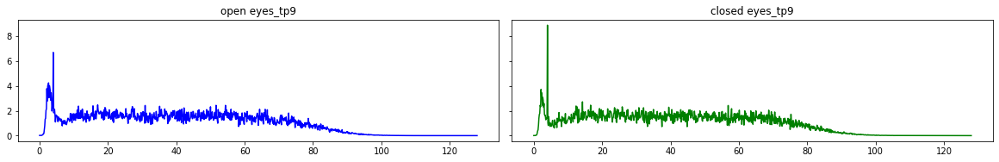

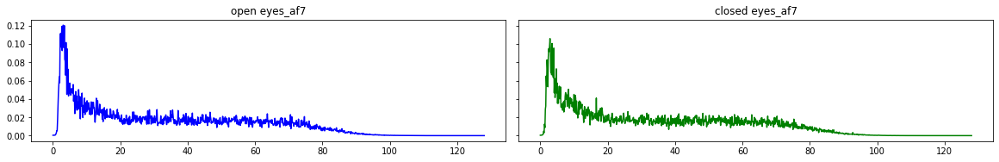

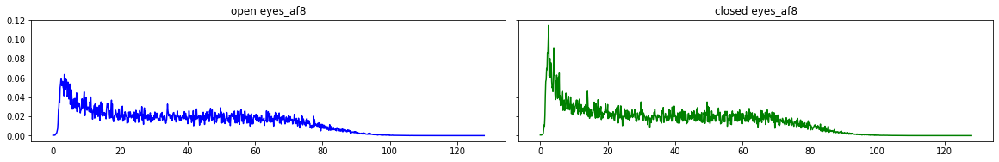

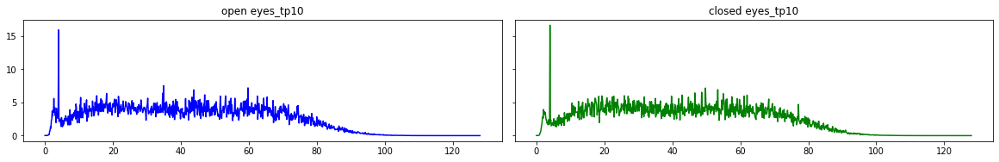

In [265]:
for i,ch in zip(range(4),['tp9','af7','af8','tp10']):
    fig, axes = plt.subplots(1,2,constrained_layout=True, figsize=(16,2.5),sharey=True,sharex=True)

    for j,condition,c in zip(range(2),['open eyes','closed eyes'],['b','g']):
        axes[j].plot(fBase, np.mean(PowerDict[condition][ch],axis=0), color=c)
        axes[j].set_title(condition+'_'+ch)
    plt.show()

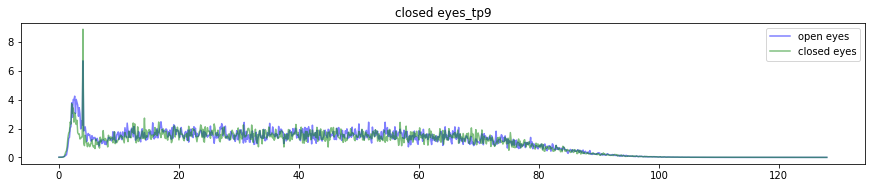

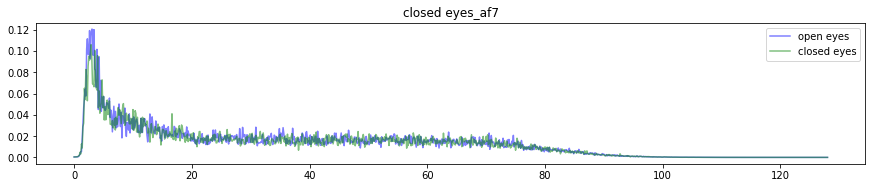

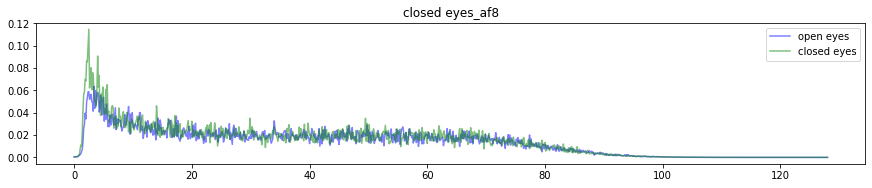

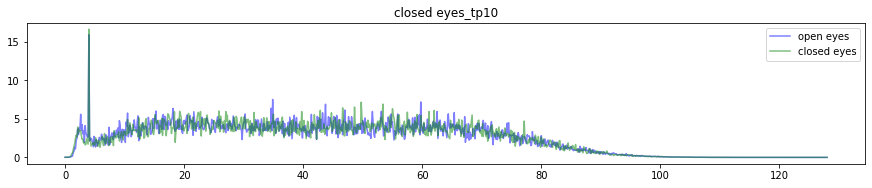

In [267]:
for i,ch in zip(range(4),['tp9','af7','af8','tp10']):
    fig, axes = plt.subplots(1,1,constrained_layout=True, figsize=(12,2.5),sharey=True,sharex=True)

    for j,condition,c in zip(range(2),['open eyes','closed eyes'],['b','g']):
        axes.plot(fBase, np.mean(PowerDict[condition][ch],axis=0), color=c, label=condition, alpha=0.5)
        axes.set_title(condition+'_'+ch)
        axes.legend(loc='upper right')
    plt.show()

In [269]:
AList = []
#AList.append({'subject':,'freq':,'condition':,'ch':,'power_value':})

In [ ]:
print(openeyes_list)
print(closedeyes_list)

In [270]:
for N, condition, id_list in zip([25,23],['open eyes','closed eyes'],[openeyes_list,closedeyes_list]):
    for ch in ['tp9','af7','af8','tp10']:
        for idx in range(N):
            for f_i,freq in enumerate(fBase):
                AList.append({'subject':id_list[idx],'freq':freq,'condition':condition,'ch':ch,
                              'power_value':PowerDict[condition][ch][idx][f_i]})
        
A_melted_df = pd.DataFrame(AList)
display(A_melted_df)

,subject,freq,condition,ch,power_value
0,test_sitting_2_0,0.000,open eyes,tp9,0.004175
1,test_sitting_2_0,0.125,open eyes,tp9,0.004222
2,test_sitting_2_0,0.250,open eyes,tp9,0.004430
3,test_sitting_2_0,0.375,open eyes,tp9,0.004477
4,test_sitting_2_0,0.500,open eyes,tp9,0.005416
...,...,...,...,...,...
196795,test_sitting_2_59,127.500,closed eyes,tp10,0.000024
196796,test_sitting_2_59,127.625,closed eyes,tp10,0.000024
196797,test_sitting_2_59,127.750,closed eyes,tp10,0.000024
196798,test_sitting_2_59,127.875,closed eyes,tp10,0.000024


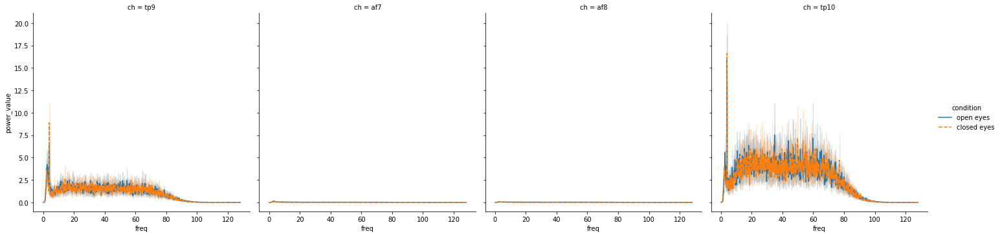

In [271]:
sns.relplot(
    data=A_melted_df, x="freq", y="power_value",
    col="ch", hue="condition", style="condition",
    kind="line", ci=95
)

In [ ]:
sns.relplot(
    data=A_melted_df, x="freq", y="power_value",
    col="ch", hue="condition", style="condition",
    kind="line", ci=95, figsize=(16,6)
)

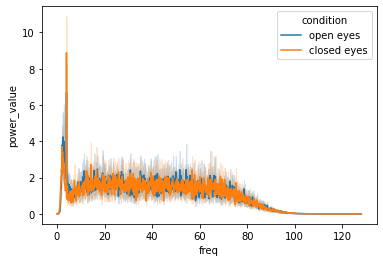

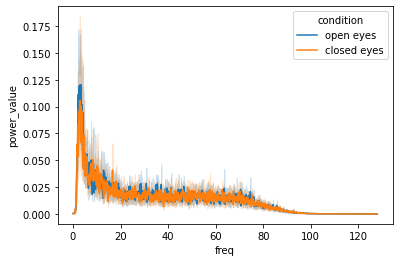

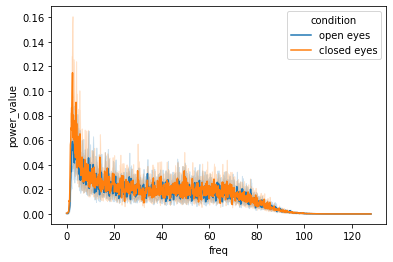

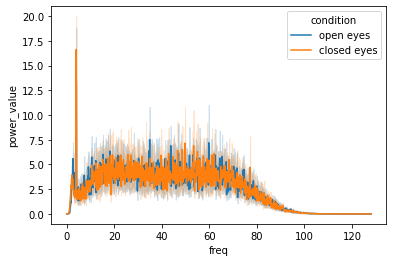

In [272]:
for key in ['tp9','af7','af8','tp10']:
    sns.lineplot(data=A_melted_df[A_melted_df.ch == key], x="freq", y="power_value", hue="condition")
    plt.show()

In [ ]:


for N, condition, id_list in zip([25,23],['open eyes','closed eyes'],[openeyes_list,closedeyes_list]):
    for ch in ['tp9','af7','af8','tp10']:
        for idx in range(N):
            for f_i,freq in enumerate(fBase):
                AList.append({'subject':id_list[idx],'freq':freq,'condition':condition,'ch':ch,
                              'power_value':PowerDict[condition][ch][idx][f_i]})
        
A_melted_df = pd.DataFrame(AList)
display(A_melted_df)

In [274]:
SmoothedDict = {'open eyes':{key:dict() for key in ['tp9','af7','af8','tp10']}, 
                'closed eyes':{key:dict() for key in ['tp9','af7','af8','tp10']}}

for N, condition, id_list in zip([25,23],['open eyes','closed eyes'],[openeyes_list,closedeyes_list]):
    for ch in ['tp9','af7','af8','tp10']:
        for idx in range(N):
            SmoothedDict[condition][ch][id_list[idx]] = np.convolve([1/9,1/9,1/9,1/9,1/9, 1/9,1/9,1/9,1/9],PowerDict[condition][ch][idx],mode='same')

In [276]:
SmoothedList=[]
for N, condition, id_list in zip([25,23],['open eyes','closed eyes'],[openeyes_list,closedeyes_list]):
    for ch in ['tp9','af7','af8','tp10']:
        for idx in range(N):
            for f_i,freq in enumerate(fBase):
                SmoothedList.append({'subject':id_list[idx],'freq':freq,'condition':condition,'ch':ch,
                              'power_value':SmoothedDict[condition][ch][id_list[idx]][f_i]})
        
Smoothed_melted_df = pd.DataFrame(SmoothedList)
display(Smoothed_melted_df)

,subject,freq,condition,ch,power_value
0,test_sitting_2_0,0.000,open eyes,tp9,0.002524
1,test_sitting_2_0,0.125,open eyes,tp9,0.003640
2,test_sitting_2_0,0.250,open eyes,tp9,0.005129
3,test_sitting_2_0,0.375,open eyes,tp9,0.006690
4,test_sitting_2_0,0.500,open eyes,tp9,0.008274
...,...,...,...,...,...
196795,test_sitting_2_59,127.500,closed eyes,tp10,0.000024
196796,test_sitting_2_59,127.625,closed eyes,tp10,0.000022
196797,test_sitting_2_59,127.750,closed eyes,tp10,0.000019
196798,test_sitting_2_59,127.875,closed eyes,tp10,0.000016


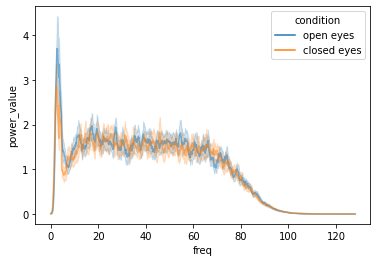

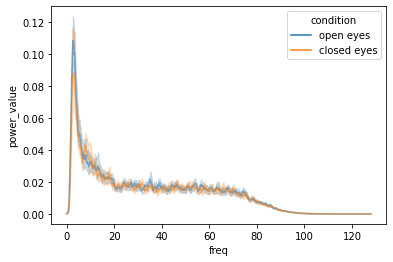

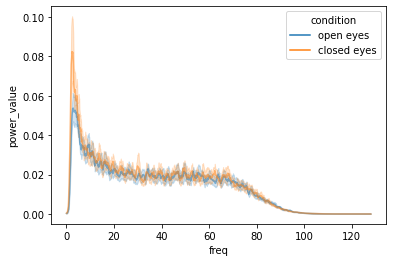

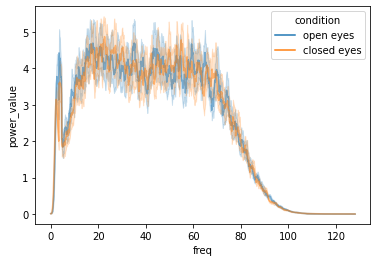

In [277]:
for key in ['tp9','af7','af8','tp10']:
    sns.lineplot(data=Smoothed_melted_df[A_melted_df.ch == key], x="freq", y="power_value", hue="condition", alpha=0.5)
    plt.show()

In [218]:
NormalizedPower_arrays = dict()
NormalizedPower_arrays['open eyes'] = {id:valsDict[id] for id in openeyes_list}
NormalizedPower_arrays['closed eyes'] = {id:valsDict[id] for id in closedeyes_list}

print(NormalizedPower_arrays['open eyes'])
#display(NormalizedPower_arrays['closed eyes'])

{'test_sitting_2_0': {'tp9': array([0.00256564, 0.002609  , 0.00279663, ..., 0.00045856, 0.00045852,
       0.0004585 ]), 'af7': array([8.30902803e-03, 8.54020216e-03, 9.24645350e-03, ...,
       3.32525374e-05, 3.32435084e-05, 3.32378306e-05]), 'af8': array([0.00161359, 0.00174632, 0.00198576, ..., 0.00124913, 0.00124911,
       0.00124909]), 'tp10': array([0.00256597, 0.00256776, 0.00257889, ..., 0.00182875, 0.00182867,
       0.00182863])}, 'test_sitting_2_2': {'tp9': array([0.00010292, 0.00024587, 0.00099757, ..., 0.00021742, 0.00021741,
       0.0002174 ]), 'af7': array([0.00913004, 0.00937678, 0.01000472, ..., 0.00072024, 0.00072023,
       0.00072022]), 'af8': array([0.01462171, 0.01492568, 0.01446062, ..., 0.00015626, 0.00015626,
       0.00015626]), 'tp10': array([0.00020877, 0.00027684, 0.00058358, ..., 0.00049976, 0.0004997 ,
       0.00049968])}, 'test_sitting_2_4': {'tp9': array([0.00412036, 0.00406143, 0.00408324, ..., 0.00087393, 0.0008739 ,
       0.00087388]), 'af7': a

In [219]:
NormalizedPower_dict = dict()
for name in ['tp9','af7','af8','tp10']:
    NormalizedPower_dict[name] = {labelType:{id:valsDict[id][name] for id in bigList} for labelType,bigList in zip(['open eyes','closed eyes'],[openeyes_list,closedeyes_list])}


In [232]:
min([len(x) for x in NormalizedPower_dict['tp9']['open eyes'].values()])

1015

In [228]:
NormalizedPower_dict['tp9']['open eyes']

{'test_sitting_2_0': array([0.00256564, 0.002609  , 0.00279663, ..., 0.00045856, 0.00045852,
        0.0004585 ]),
 'test_sitting_2_2': array([0.00010292, 0.00024587, 0.00099757, ..., 0.00021742, 0.00021741,
        0.0002174 ]),
 'test_sitting_2_4': array([0.00412036, 0.00406143, 0.00408324, ..., 0.00087393, 0.0008739 ,
        0.00087388]),
 'test_sitting_2_6': array([0.02567723, 0.02597707, 0.02590185, ..., 0.00019522, 0.00019521,
        0.00019521]),
 'test_sitting_2_8': array([0.00489697, 0.00484519, 0.00505744, ..., 0.00090222, 0.0009022 ,
        0.0009022 ]),
 'test_sitting_2_10': array([2.05857887e-03, 2.60531787e-03, 4.85370397e-03, ...,
        4.24143378e-05, 4.24127160e-05, 4.24122176e-05]),
 'test_sitting_2_12': array([2.57595386e-02, 2.57597568e-02, 2.65908096e-02, ...,
        6.04507491e-06, 6.03291276e-06, 6.02729921e-06]),
 'test_sitting_2_14': array([0.00216263, 0.00229338, 0.00271892, ..., 0.00014448, 0.00014447,
        0.00014447]),
 'test_sitting_2_16': array([

# Try wavelet analysis

In [287]:
def visualize_wavelet(freq=6, n_wavelet_cycles=6, windowLengthSeconds=1, fs=300):
    std_for_gaussian = lambda n, f: n/(2*np.pi*f)
    cmw = lambda t, f, s: (1/np.sqrt(s*np.sqrt(np.pi))) * np.exp(-t**2/(2*s**2)) * np.exp(1j*2*np.pi*f*t)
    x = np.linspace(-windowLengthSeconds/2, windowLengthSeconds/2, int(windowLengthSeconds*fs)+1)  # 300 Hz sampling rate
    complex_morlet_wavelet = cmw(x, freq, std_for_gaussian(n=n_wavelet_cycles, f=freq))

    fig = plt.figure()
    ax = fig.gca(projection='3d')
    ax.plot(x, np.real(complex_morlet_wavelet), np.imag(complex_morlet_wavelet))
    ax.set_xlabel('time(s)')
    ax.set_ylabel('real')
    ax.set_zlabel('imag')
    plt.show()

    fig = plt.figure()  # real component is centered at time=0 (like a cosine function)
    ax = fig.gca(projection='3d')
    ax.plot(x, np.real(complex_morlet_wavelet), np.imag(complex_morlet_wavelet))
    ax.view_init(90, -90)
    ax.set_xlabel('time(s)')
    ax.set_ylabel('real')
    ax.set_zlabel('imag')
    plt.show()

    fig = plt.figure()   # imaginary component is phase-shifted by 90 degrees (like a sine function)
    ax = fig.gca(projection='3d')
    ax.plot(x, np.real(complex_morlet_wavelet), np.imag(complex_morlet_wavelet))
    ax.view_init(0, -90)
    ax.set_xlabel('time(s)')
    ax.set_ylabel('real')
    ax.set_zlabel('imag')
    plt.show()

def apply_wavelets(data, wavelet_width, freqs, n_wavelet_cycles, extract_list=['power'], 
                   mode='valid', plot_things=False, verbose=False):
    # Use mode='same' if data wrangling requires equal input and output size. Otherwise use mode='valid',especially for aggregations.
    # Ensure n_wavelet_cycles is coherent with freqs (Either int/float or sequence with length matching len(freqs))
    if type(n_wavelet_cycles)==int or type(n_wavelet_cycles)==float:
        n_wavelet_cycles = [n_wavelet_cycles] * len(freqs)
    else:
        assert len(n_wavelet_cycles) == len(freqs), 'Error: If n_wavelet_cycles is a sequence, it must match length of freqs.'
    
    std_for_gaussian = lambda n, f: n/(2*np.pi*f)
    cmw = lambda t, f, s: (1/np.sqrt(s*np.sqrt(np.pi))) * np.exp(-t**2/(2*s**2)) * np.exp(1j*2*np.pi*f*t)
    
    outer_list = []
    
    for freq, n_cycles in zip(freqs, n_wavelet_cycles): # iterate over each peak frequency
        inner_dict = dict()
        windowLengthSeconds = wavelet_width
        t = np.linspace(-windowLengthSeconds/2, windowLengthSeconds/2, int(windowLengthSeconds*256)+1)  # 256 Hz sampling rate
        complex_morlet_wavelet = cmw(t, freq, std_for_gaussian(n=n_cycles, f=freq))
        
        if plot_things==True:
            visualize_wavelet(freq, n_wavelet_cycles=n_cycles, windowLengthSeconds=windowLengthSeconds, fs=256)
        
        for i in range(4):   # iterate over each channel
            complex_convolved = np.convolve(complex_morlet_wavelet, data[:,i], mode=mode)
            
            inner_dict['bandpass_'+str(i)] = np.real(complex_convolved)  
            inner_dict['amplitude_'+str(i)] = np.abs(complex_convolved)
            inner_dict['power_'+str(i)] = np.abs(complex_convolved**2)
            inner_dict['phase_'+str(i)] = np.angle(complex_convolved)

        outer_list.append(inner_dict)

        if verbose==True: 
            print(inner_dict.keys())

    new_df=pd.DataFrame({extraction+str(np.round(freq,1))+'HzCh'+str(i) : outer_item[extraction+'_'+str(i)] for extraction in extract_list for i in range(4) for freq, outer_item in zip(freqs, outer_list)})
    return new_df  

In [ ]:
def transform_epochs(dataframe, epoch_dict, agg_funcs=['mean','var'], downsample_or_agg_all='agg_all',
                     wavelet_width=0.5, wavelet_freqs=np.linspace(4, 80, 39), 
                     wavelet_extract_list=['power', 'amplitude', 'phase']):
    """Transform data within epochs
    epoch_dict contains lists of 2-tuples with start and end timestamps (of type Timedelta)
    downsample_string should match 
    """
    new_epoch_dict = {'/Marker/1':[], '/Marker/2':[], '/Marker/3':[], '/Marker/4':[], '/Marker/5':[], 'Between_Tasks':[]}
    wavelet_width_timedelta = pd.to_timedelta('00:00:'+str(wavelet_width))
    for marker_type in epoch_dict.keys():
        for epoch in tqdm(epoch_dict[marker_type]):
            start_timestamp = epoch[0]
            end_timestamp = epoch[1]
            
            start_for_wavelets = epoch[0] - (wavelet_width_timedelta/2)
            end_for_wavelets = epoch[1] + (wavelet_width_timedelta/2)
            
            raw_channels = ['RAW_TP9', 'RAW_AF7', 'RAW_AF8', 'RAW_TP10']
            convolve_segment = dataframe.loc[start_for_wavelets:end_for_wavelets, raw_channels]

            wavelet_output = apply_wavelets(data=convolve_segment.values, wavelet_width=wavelet_width, freqs=wavelet_freqs, 
                           n_wavelet_cycles=wavelet_freqs, extract_list=wavelet_extract_list)
            assert len(wavelet_output) == len(convolve_segment.index)
            wavelet_output.index = convolve_segment.index
            
            if 'phase' in wavelet_extract_list:

                # Extract phase differences between channels
                phase_diff_dict = dict()

                def smallestSignedAngleBetween(x, y):
                    """
                    based on function from https://stackoverflow.com/a/1878936
                    """
                    A = (x - y) % (2*np.pi)
                    B = (y - x) % (2*np.pi)
                    return [-a if a < b else b for a,b in zip(A,B)]

                for float_for_string in wavelet_freqs:
                    float_string = str(float_for_string)   #example: 'phase6.0HzCh0'

                    for ch_pair in [(0,1),(0,2),(0,3),(1,2),(1,3),(2,3)]:

                        name_string_A = 'phase'+float_string+'HzCh'+str(ch_pair[0])
                        name_string_B = 'phase'+float_string+'HzCh'+str(ch_pair[1])

                        phase_diff_name = 'phaseDifference_'+name_string_A+'_'+name_string_B

                        phase_diff = smallestSignedAngleBetween(x=wavelet_output[name_string_A], y=wavelet_output[name_string_B])

                        phase_diff_dict[phase_diff_name] = phase_diff

                        #print(phase_diff_name+': ', phase_diff_dict[phase_diff_name][0])
                        #print('\n')

                phase_diff_df = pd.DataFrame(phase_diff_dict, index=convolve_segment.index)

                all_features_single_epoch = pd.concat([dataframe.loc[start_for_wavelets:end_for_wavelets, :], 
                                                       wavelet_output, phase_diff_df], axis=1)

                # aggregation framework
                if downsample_or_agg_all=='agg_all':
                    agg_all_df = all_features_single_epoch.loc[start_timestamp:end_timestamp, :].agg(agg_funcs)
                    new_epoch_dict[marker_type].append((epoch, agg_all_df))
                    
                else:
                    downsample_string = downsample_or_agg_all # example:'100ms'
                    agg_all_df = all_features_single_epoch.loc[start_timestamp:end_timestamp, :].resample(downsample_string).agg(agg_funcs)
                    #print(len(agg_all_df))
                    new_epoch_dict[marker_type].append((epoch, agg_all_df))
                    
    return new_epoch_dict

In [ ]:
for idx in [0,-1]:
    print(seg_id_list[idx],'\n')
    test_all_FFT(signals=[MMP(outerList[idx]['tp9']), 
                          MMP(outerList[idx]['af7']), 
                          MMP(outerList[idx]['af8']), 
                          MMP(outerList[idx]['tp10'])], 
                      fs_list=[256]*4, 
                      window_len_list = [256*5]*4, 
                      freq_adjust_list = [int(256)]*4,
                      ylabel_list= ['EEG \n(TP9)', 'EEG \n(AF7)','EEG \n(AF8)', 'EEG \n(TP10)',],
                      fig_suptitle='FFT of 10sec segment : '+seg_id_list[idx])

power4HzCh0     4.634267e+05
power6HzCh0     3.969845e+05
power8HzCh0     3.983354e+05
power10HzCh0    4.327927e+05
power12HzCh0    7.920565e+05
                    ...     
power72HzCh3    1.803089e+06
power74HzCh3    2.760469e+06
power76HzCh3    2.983602e+06
power78HzCh3    2.052974e+06
power80HzCh3    1.832428e+06
Length: 156, dtype: float64

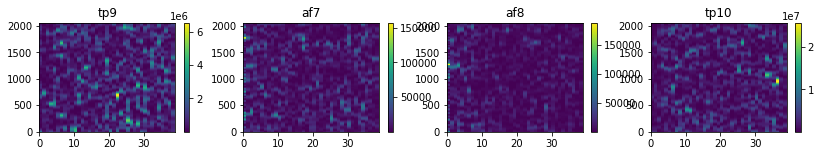

In [337]:
temp = apply_wavelets(data=np.vstack([np.array([outerList[0][key] for key in ['tp9','af7','af8','tp10']])]).T, 
               wavelet_width=2, 
               freqs=[f for f in range(4,81,2)], 
               n_wavelet_cycles=[f for f in range(4,81,2)], 
               extract_list=['power'], 
               plot_things=False, 
               verbose=False)
display(temp.mean(axis=0))
plt.figure(figsize=[14,2])
for i in range(4):
    
    plt.subplot(1,4,i+1)
    plt.pcolor(temp.values[:,i*39:(i+1)*39])
    plt.colorbar()
    plt.title(['tp9','af7','af8','tp10'][i])
plt.show()

power4HzCh0     5.963040e+05
power6HzCh0     3.698573e+05
power8HzCh0     4.427571e+05
power10HzCh0    4.561403e+05
power12HzCh0    7.955785e+05
                    ...     
power72HzCh3    1.409717e+06
power74HzCh3    1.853693e+06
power76HzCh3    1.969207e+06
power78HzCh3    1.259836e+06
power80HzCh3    8.457647e+05
Length: 156, dtype: float64

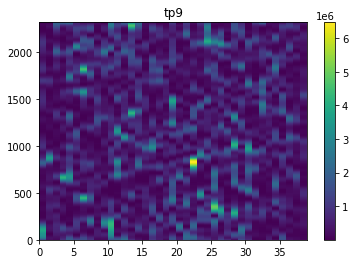

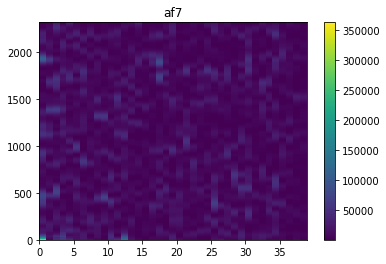

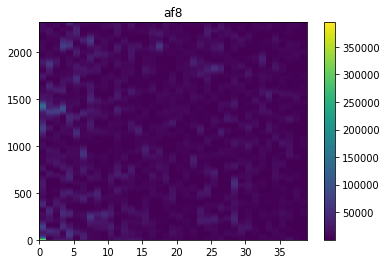

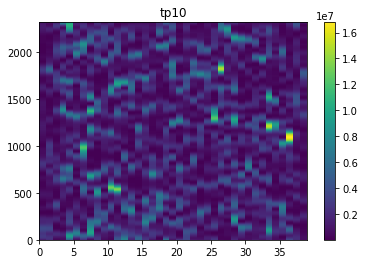

In [330]:

temp = apply_wavelets(data=np.vstack([BP(np.array([outerList[0][key] for key in ['tp9','af7','af8','tp10']]))]).T, 
               wavelet_width=1, 
               freqs=[f for f in range(4,81,2)], 
               n_wavelet_cycles=[f for f in range(4,81,2)], 
               extract_list=['power'], 
               plot_things=False, 
               verbose=False)
display(temp.mean(axis=0))
for i in range(4):
    plt.pcolor(temp.values[:,i*39:(i+1)*39])
    plt.colorbar()
    plt.title(['tp9','af7','af8','tp10'][i])
    plt.show()

power4HzCh0     5.922924e+05
power6HzCh0     3.698513e+05
power8HzCh0     4.449870e+05
power10HzCh0    4.573967e+05
power12HzCh0    7.959992e+05
                    ...     
power72HzCh3    1.798007e+06
power74HzCh3    2.565580e+06
power76HzCh3    2.991047e+06
power78HzCh3    2.158252e+06
power80HzCh3    1.705602e+06
Length: 156, dtype: float64

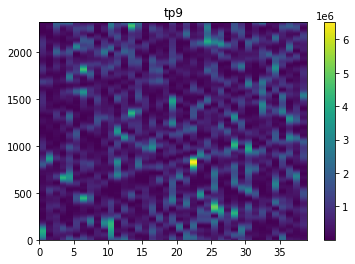

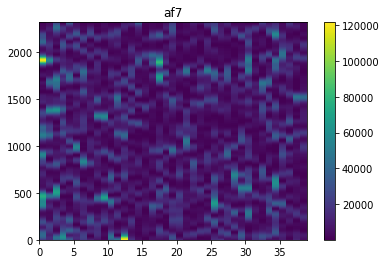

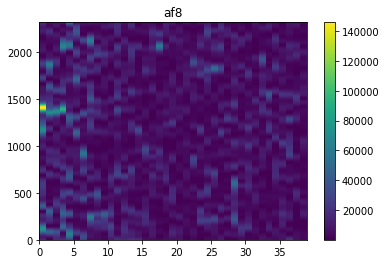

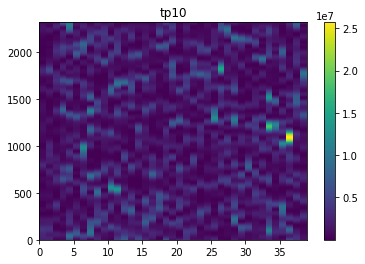

In [331]:
temp = apply_wavelets(data=np.vstack([np.array([outerList[0][key] for key in ['tp9','af7','af8','tp10']])-np.mean(np.array([outerList[0][key] for key in ['tp9','af7','af8','tp10']]))]).T, 
               wavelet_width=1, 
               freqs=[f for f in range(4,81,2)], 
               n_wavelet_cycles=[f for f in range(4,81,2)], 
               extract_list=['power'], 
               plot_things=False, 
               verbose=False)
display(temp.mean(axis=0))
for i in range(4):
    plt.pcolor(temp.values[:,i*39:(i+1)*39])
    plt.colorbar()
    plt.title(['tp9','af7','af8','tp10'][i])
    plt.show()

In [289]:
len(outerList[0][key])

2568

In [290]:
outerList[0][key].shape

(2568,)

In [311]:
np.vstack([np.array([outerList[0][key] for key in ['tp9','af7','af8','tp10']])]).T.shape

(2568, 4)

test_sitting_2_0
EYES OPEN


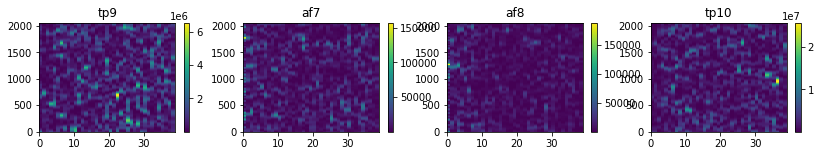

test_sitting_2_1
EYES CLOSED


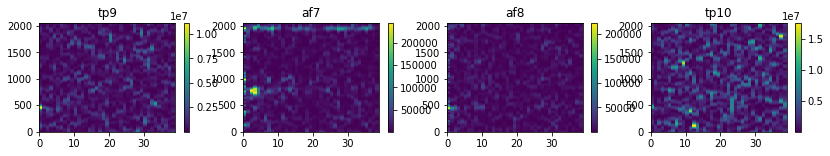

test_sitting_2_2
EYES OPEN


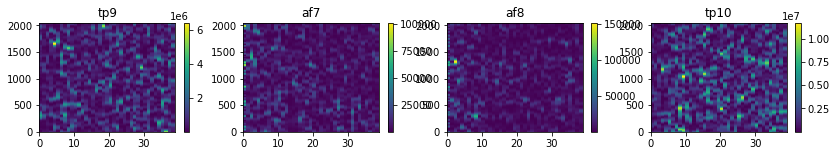

test_sitting_2_3
EYES CLOSED


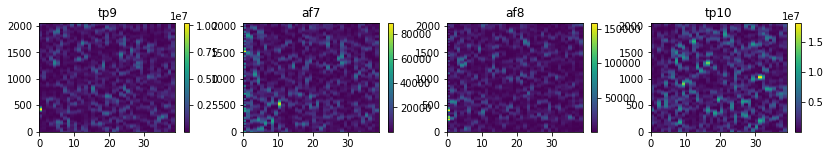

test_sitting_2_4
EYES OPEN


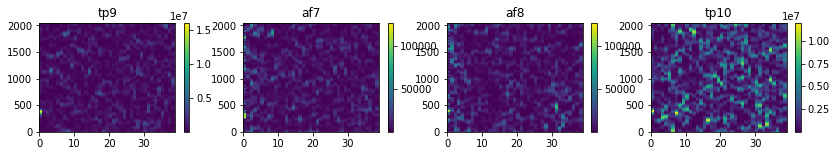

test_sitting_2_5
EYES CLOSED


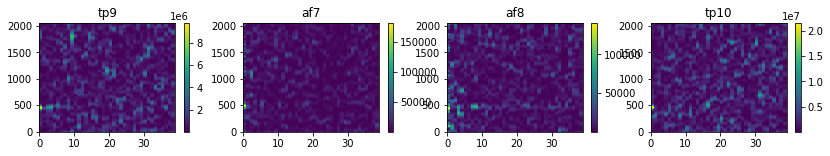

test_sitting_2_6
EYES OPEN


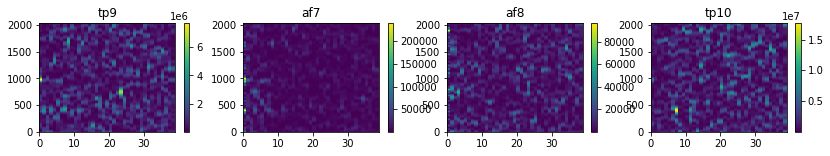

test_sitting_2_7
EYES CLOSED


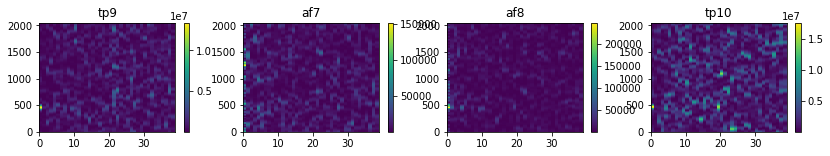

test_sitting_2_8
EYES OPEN


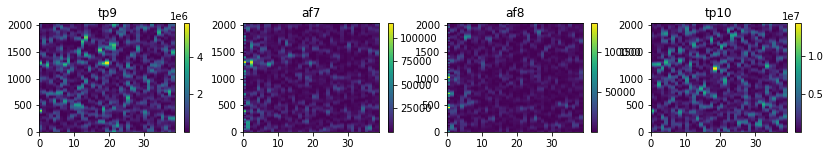

test_sitting_2_10
EYES OPEN


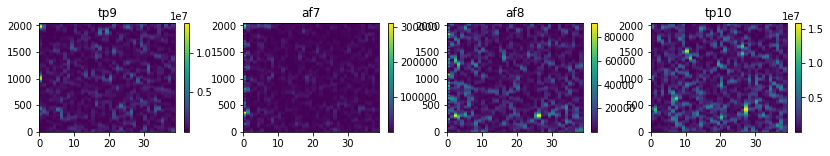

test_sitting_2_11
EYES CLOSED


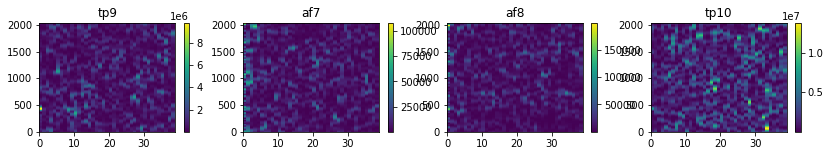

test_sitting_2_12
EYES OPEN


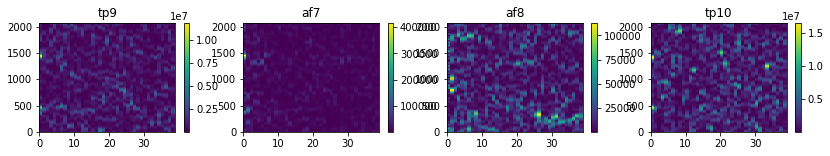

test_sitting_2_13
EYES CLOSED


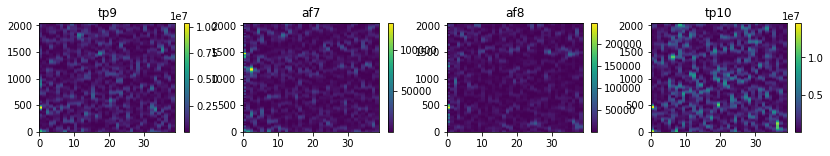

test_sitting_2_14
EYES OPEN


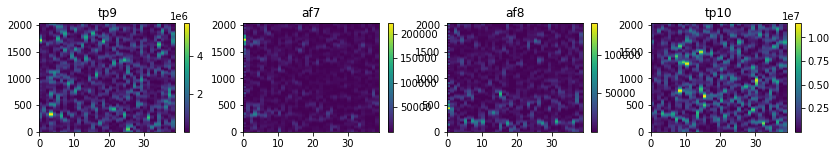

test_sitting_2_15
EYES CLOSED


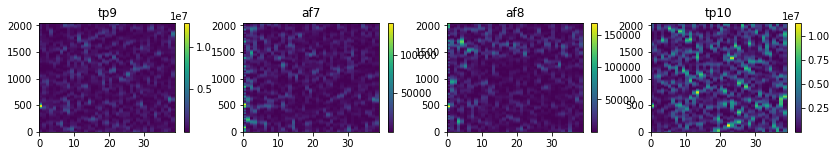

test_sitting_2_16
EYES OPEN


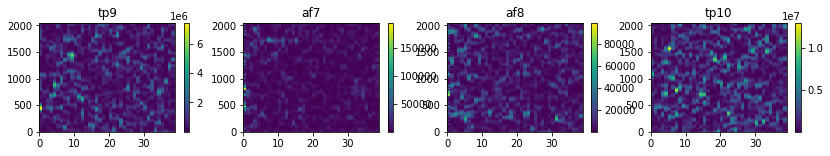

test_sitting_2_18
EYES OPEN


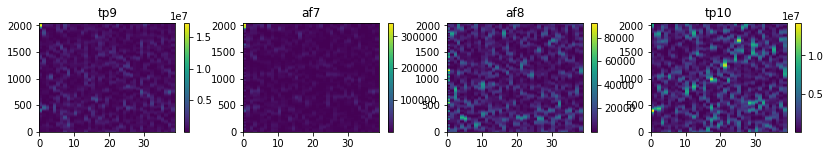

test_sitting_2_19
EYES CLOSED


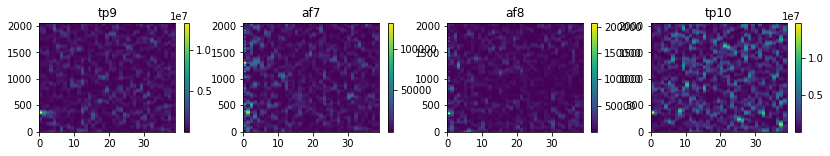

test_sitting_2_20
EYES OPEN


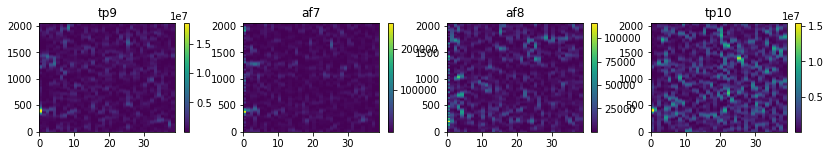

test_sitting_2_21
EYES CLOSED


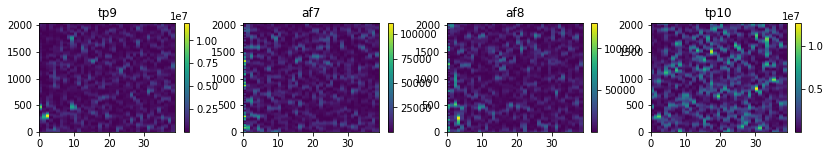

test_sitting_2_22
EYES OPEN


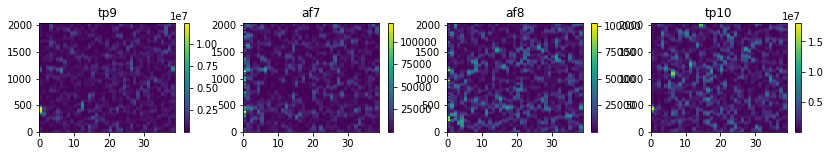

test_sitting_2_23
EYES CLOSED


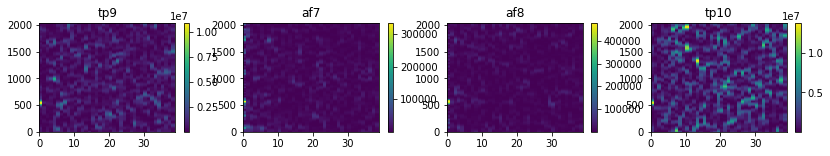

test_sitting_2_24
EYES OPEN


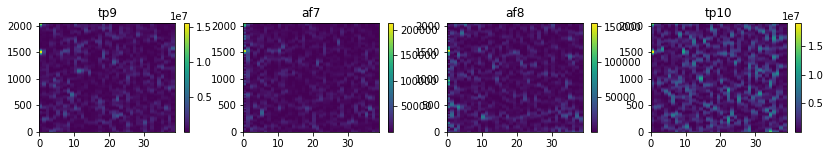

test_sitting_2_25
EYES CLOSED


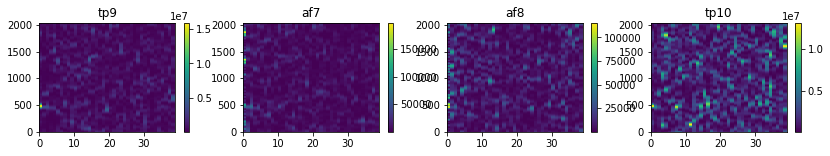

test_sitting_2_26
EYES OPEN


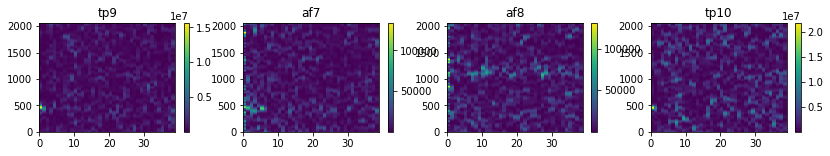

test_sitting_2_27
EYES CLOSED


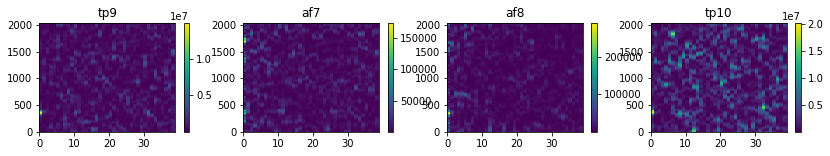

test_sitting_2_28
EYES OPEN


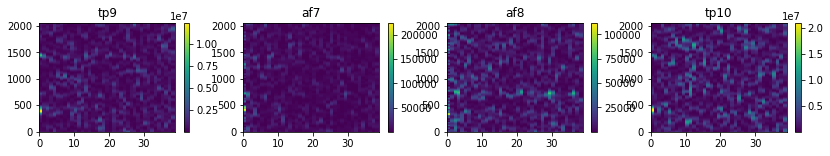

test_sitting_2_31
EYES CLOSED


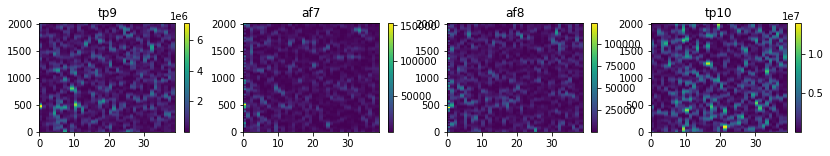

test_sitting_2_32
EYES OPEN


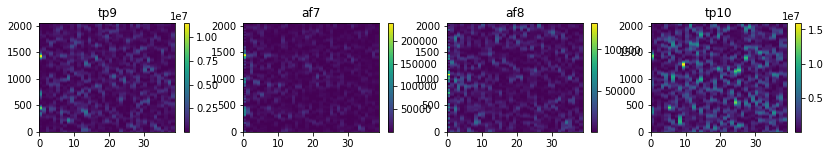

test_sitting_2_35
EYES CLOSED


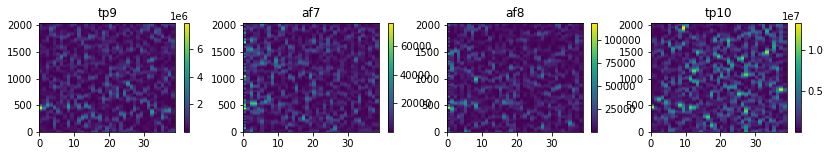

test_sitting_2_36
EYES OPEN


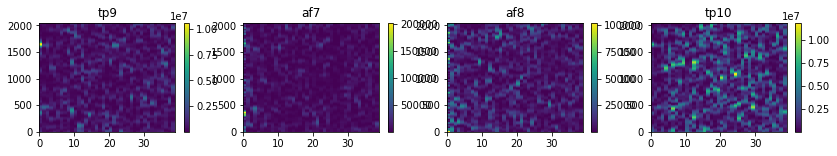

test_sitting_2_37
EYES CLOSED


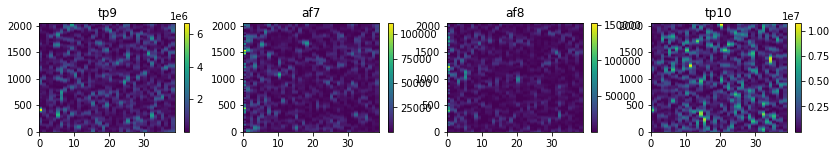

test_sitting_2_38
EYES OPEN


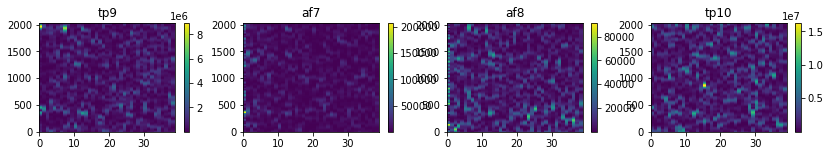

test_sitting_2_41
EYES CLOSED


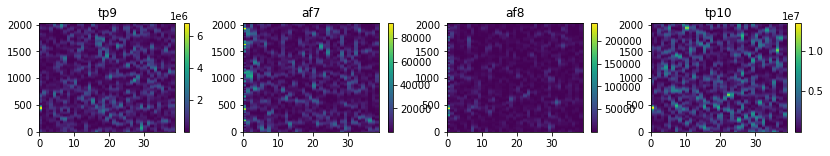

test_sitting_2_43
EYES CLOSED


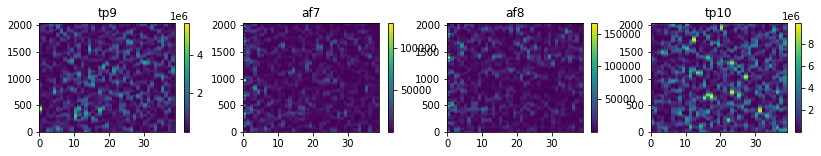

test_sitting_2_44
EYES OPEN


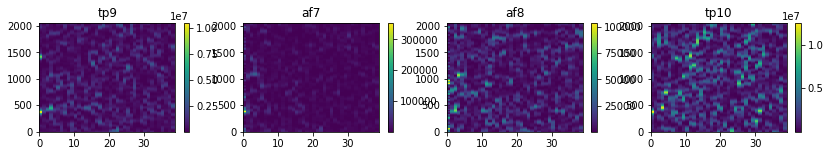

test_sitting_2_45
EYES CLOSED


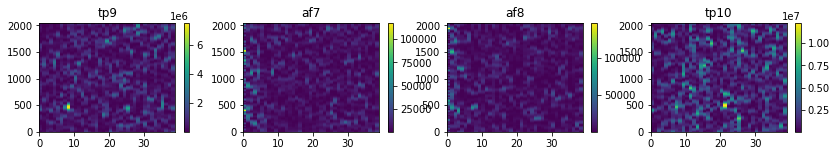

test_sitting_2_46
EYES OPEN


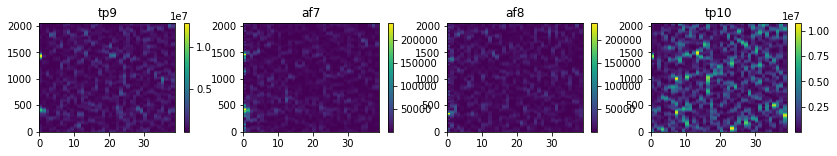

test_sitting_2_47
EYES CLOSED


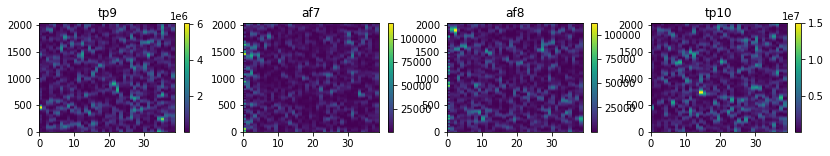

test_sitting_2_48
EYES OPEN


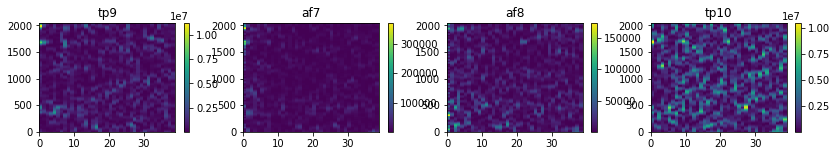

test_sitting_2_50
EYES OPEN


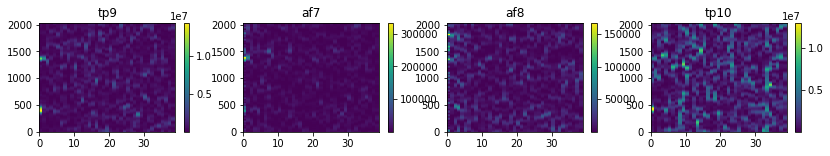

test_sitting_2_51
EYES CLOSED


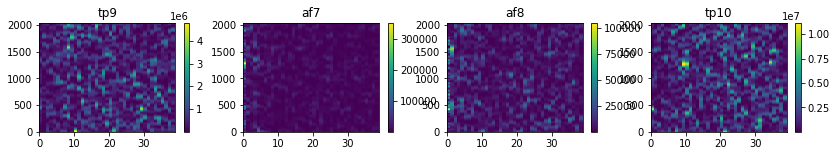

test_sitting_2_52
EYES OPEN


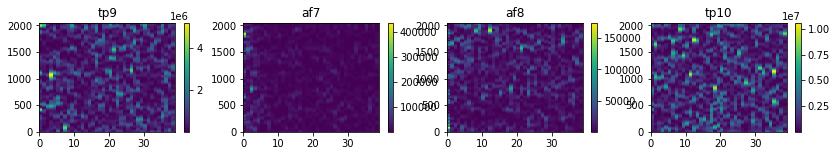

test_sitting_2_53
EYES CLOSED


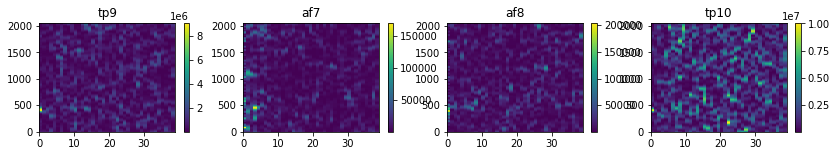

test_sitting_2_54
EYES OPEN


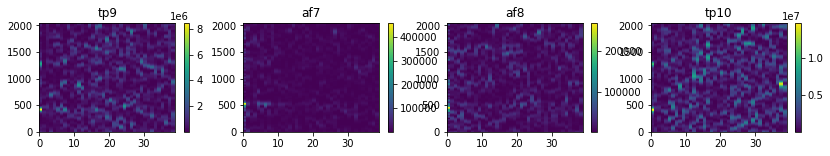

test_sitting_2_55
EYES CLOSED


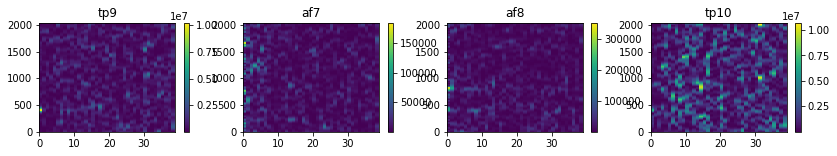

test_sitting_2_58
EYES OPEN


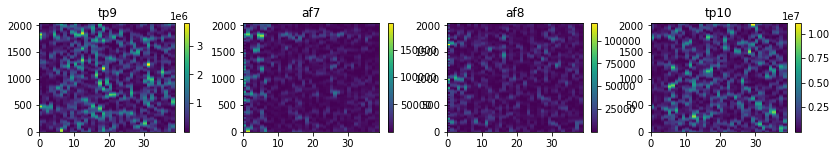

test_sitting_2_59
EYES CLOSED


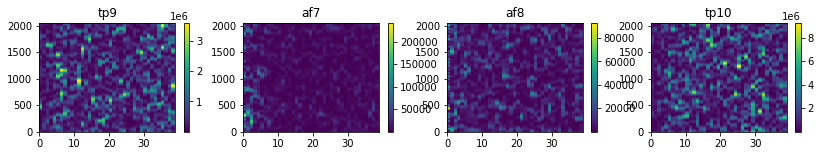

In [338]:
for id_idx in range(len(outerList)):
    print(seg_id_list[id_idx])
    if int(seg_id_list[id_idx].split('_')[-1])%2==0:
        print('EYES OPEN')
    elif int(seg_id_list[id_idx].split('_')[-1])%2==1:
        print('EYES CLOSED')
    temp = apply_wavelets(data=np.vstack([np.array([outerList[id_idx][key] for key in ['tp9','af7','af8','tp10']])]).T, 
                   wavelet_width=2, 
                   freqs=[f for f in range(4,81,2)], 
                   n_wavelet_cycles=[f for f in range(4,81,2)], 
                   extract_list=['power'], 
                   plot_things=False, 
                   verbose=False)
    #display(temp.mean(axis=0))
    plt.figure(figsize=[14,2])
    for i in range(4):

        plt.subplot(1,4,i+1)
        plt.pcolor(temp.values[:,i*39:(i+1)*39])
        plt.colorbar()
        plt.title(['tp9','af7','af8','tp10'][i])
        
    plt.show()

test_sitting_2_0
EYES OPEN


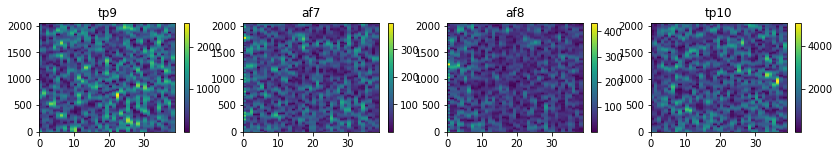

test_sitting_2_1
EYES CLOSED


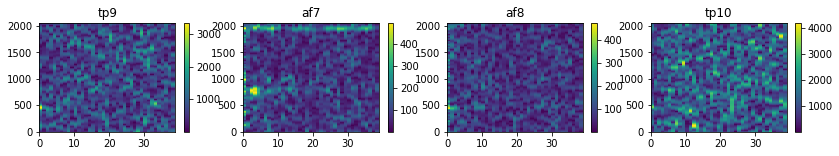

test_sitting_2_2
EYES OPEN


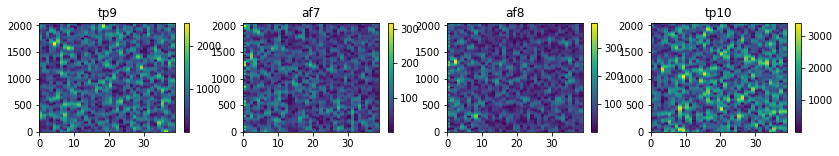

test_sitting_2_3
EYES CLOSED


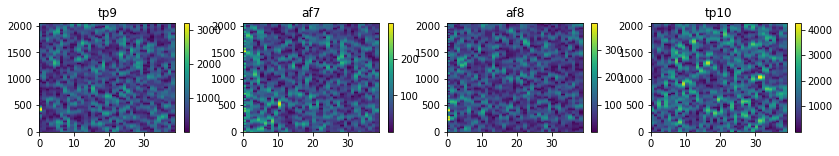

test_sitting_2_4
EYES OPEN


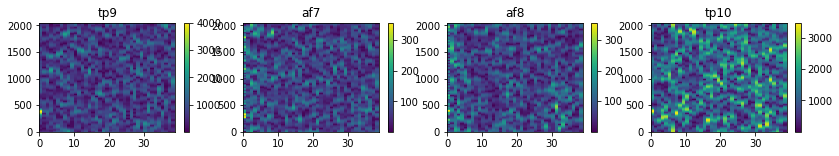

test_sitting_2_5
EYES CLOSED


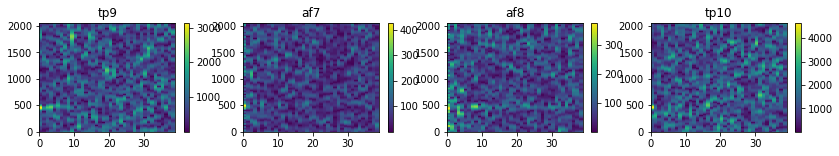

test_sitting_2_6
EYES OPEN


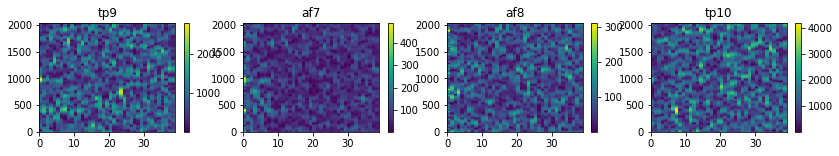

test_sitting_2_7
EYES CLOSED


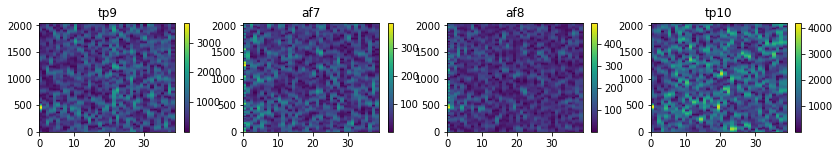

test_sitting_2_8
EYES OPEN


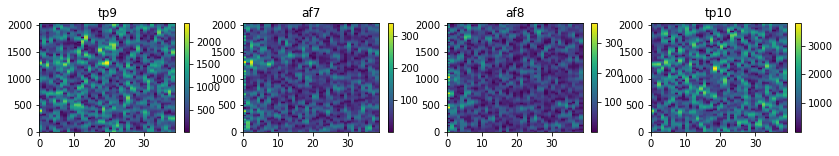

test_sitting_2_10
EYES OPEN


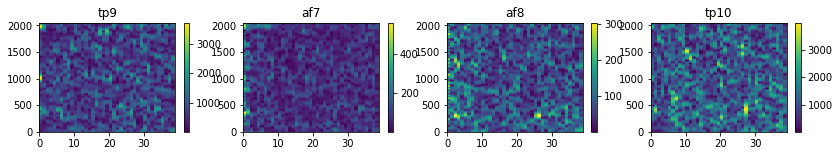

test_sitting_2_11
EYES CLOSED


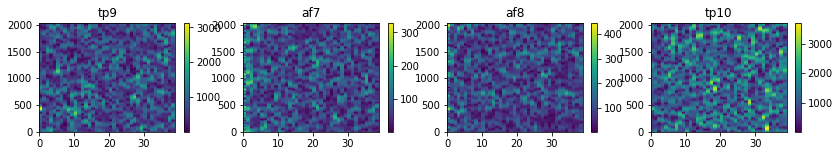

test_sitting_2_12
EYES OPEN


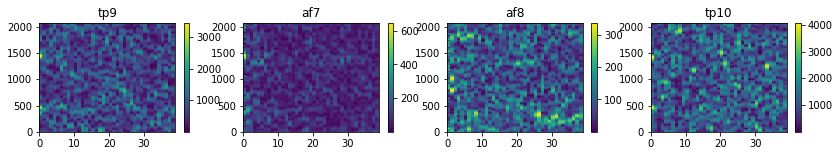

test_sitting_2_13
EYES CLOSED


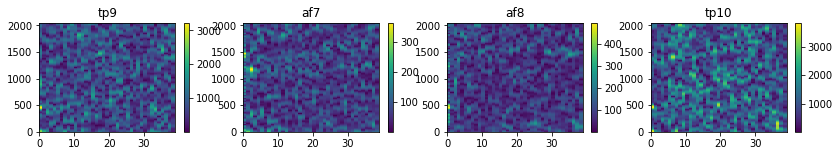

test_sitting_2_14
EYES OPEN


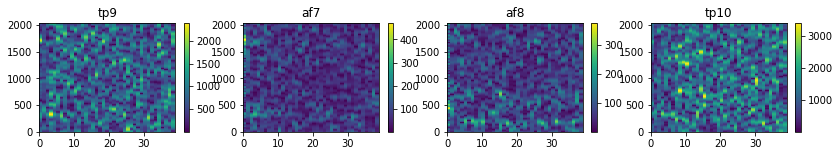

test_sitting_2_15
EYES CLOSED


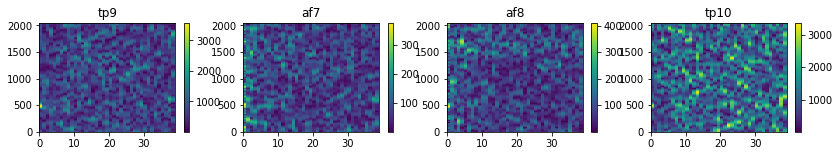

test_sitting_2_16
EYES OPEN


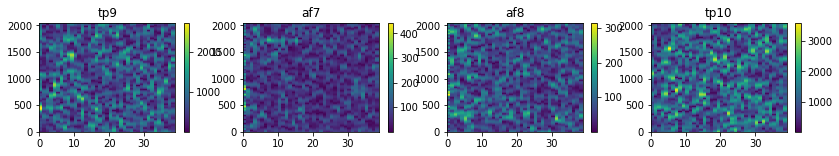

test_sitting_2_18
EYES OPEN


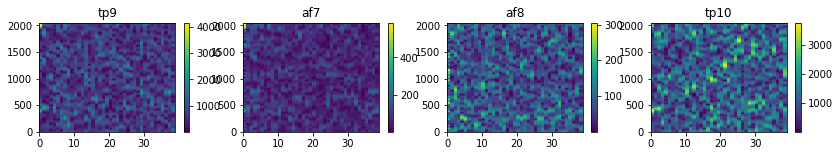

test_sitting_2_19
EYES CLOSED


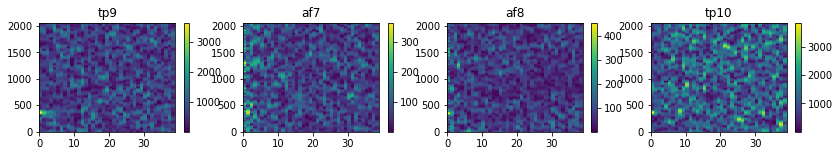

test_sitting_2_20
EYES OPEN


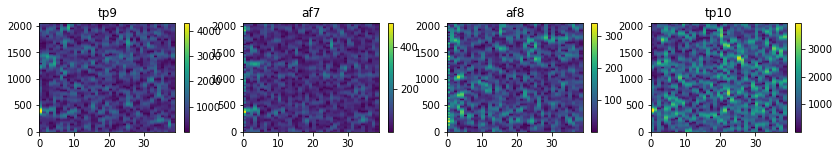

test_sitting_2_21
EYES CLOSED


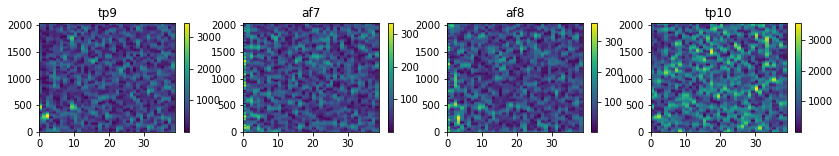

test_sitting_2_22
EYES OPEN


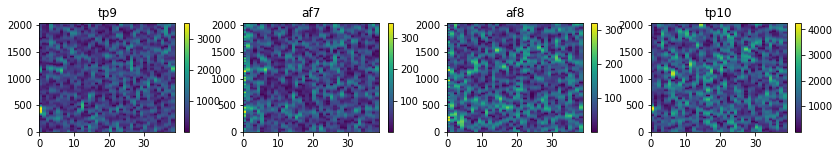

test_sitting_2_23
EYES CLOSED


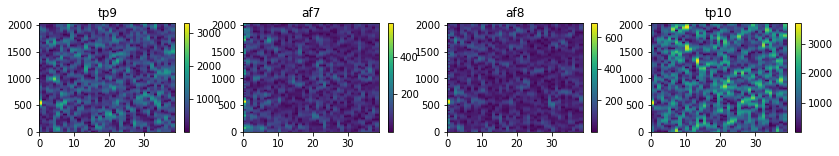

test_sitting_2_24
EYES OPEN


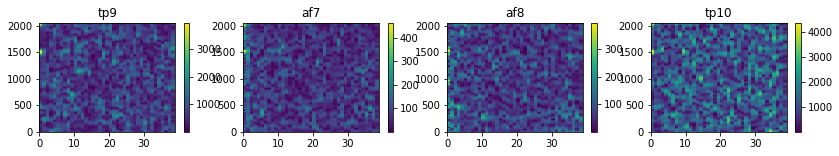

test_sitting_2_25
EYES CLOSED


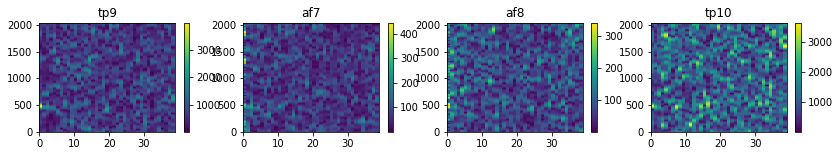

test_sitting_2_26
EYES OPEN


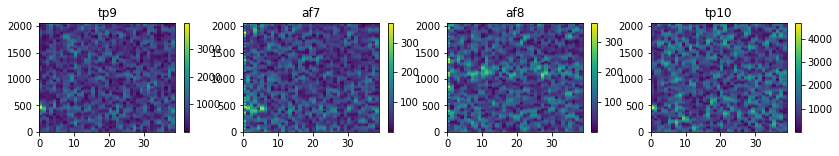

test_sitting_2_27
EYES CLOSED


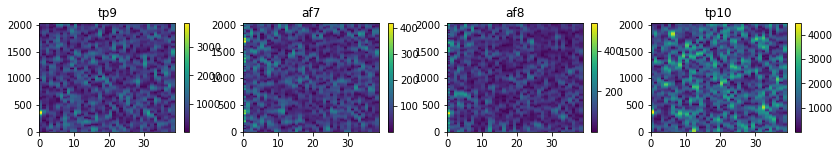

test_sitting_2_28
EYES OPEN


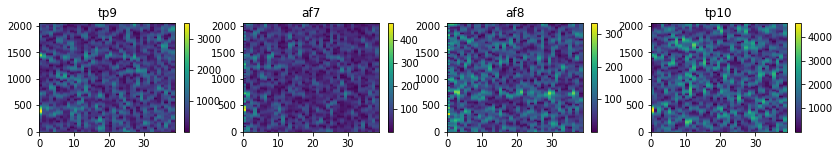

test_sitting_2_31
EYES CLOSED


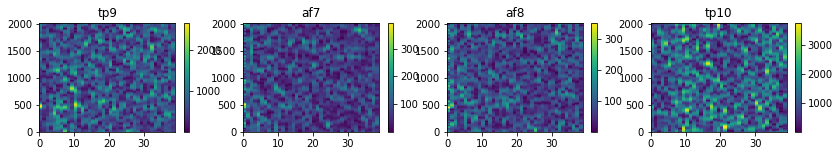

test_sitting_2_32
EYES OPEN


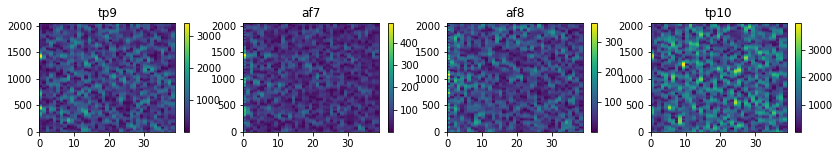

test_sitting_2_35
EYES CLOSED


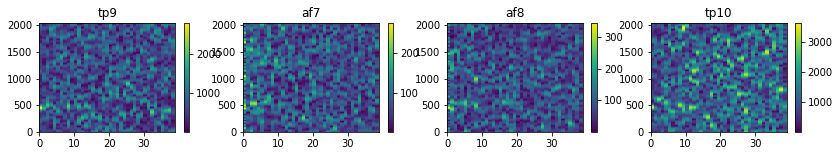

test_sitting_2_36
EYES OPEN


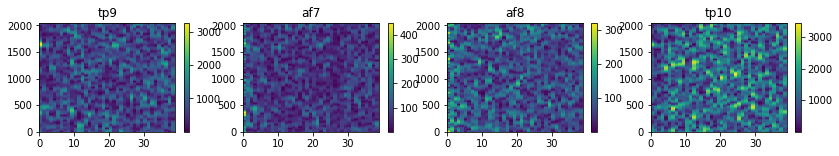

test_sitting_2_37
EYES CLOSED


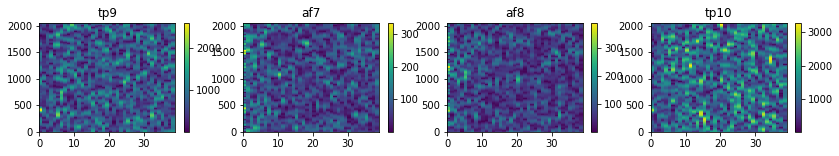

test_sitting_2_38
EYES OPEN


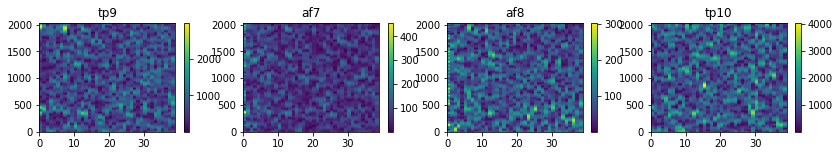

test_sitting_2_41
EYES CLOSED


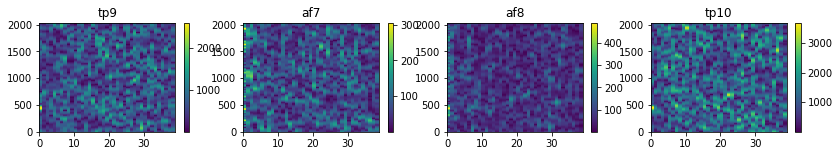

test_sitting_2_43
EYES CLOSED


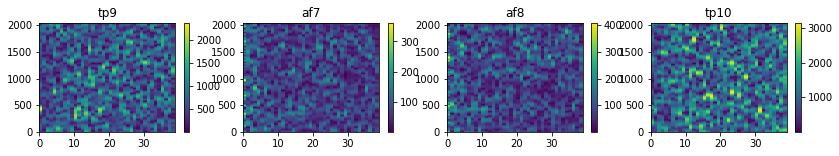

test_sitting_2_44
EYES OPEN


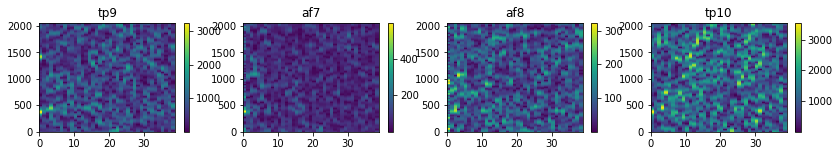

test_sitting_2_45
EYES CLOSED


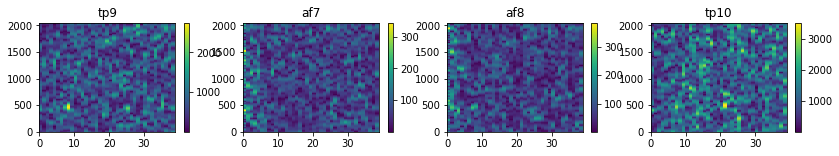

test_sitting_2_46
EYES OPEN


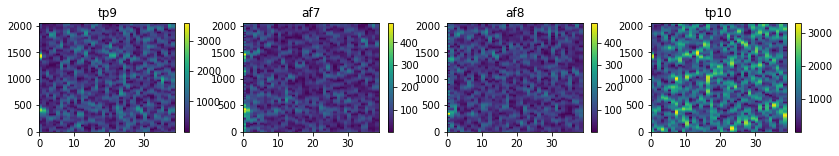

test_sitting_2_47
EYES CLOSED


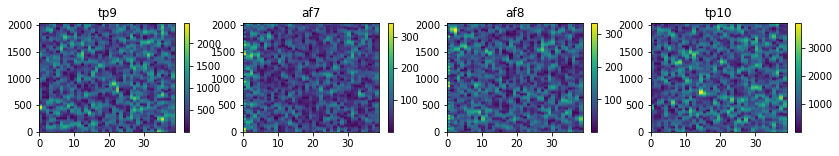

test_sitting_2_48
EYES OPEN


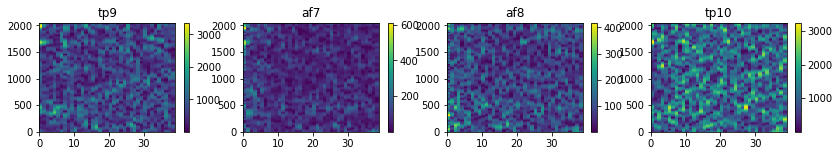

test_sitting_2_50
EYES OPEN


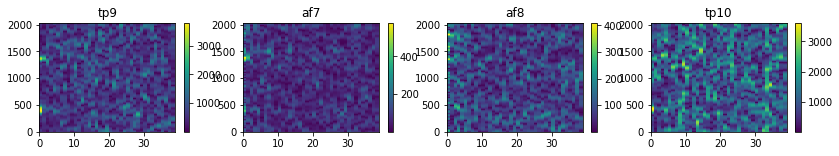

test_sitting_2_51
EYES CLOSED


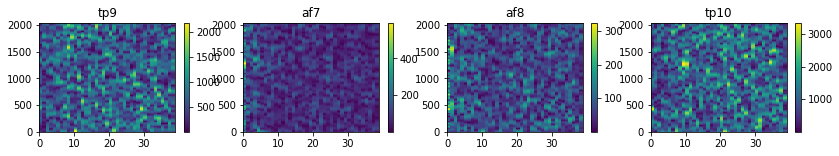

test_sitting_2_52
EYES OPEN


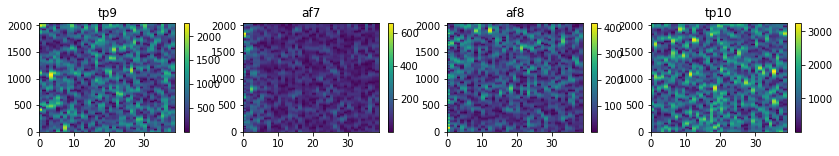

test_sitting_2_53
EYES CLOSED


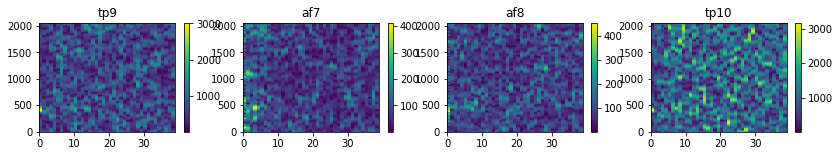

test_sitting_2_54
EYES OPEN


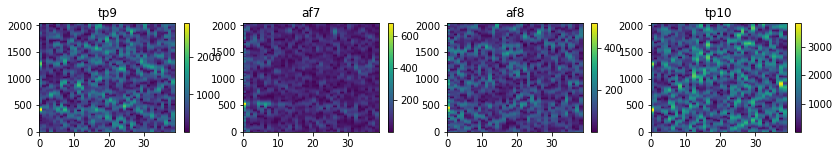

test_sitting_2_55
EYES CLOSED


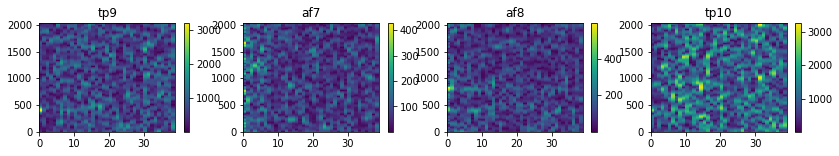

test_sitting_2_58
EYES OPEN


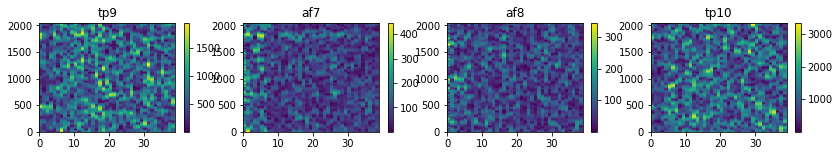

test_sitting_2_59
EYES CLOSED


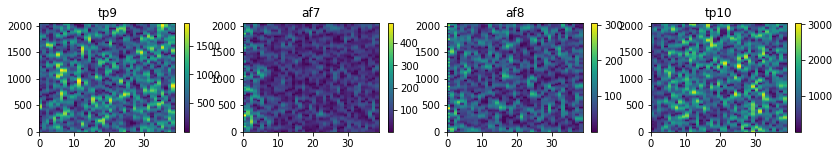

In [341]:
# Amplitude
for id_idx in range(len(outerList)):
    print(seg_id_list[id_idx])
    if int(seg_id_list[id_idx].split('_')[-1])%2==0:
        print('EYES OPEN')
    elif int(seg_id_list[id_idx].split('_')[-1])%2==1:
        print('EYES CLOSED')
    temp = apply_wavelets(data=np.vstack([np.array([outerList[id_idx][key] for key in ['tp9','af7','af8','tp10']])]).T, 
                   wavelet_width=2, 
                   freqs=[f for f in range(4,81,2)], 
                   n_wavelet_cycles=[f for f in range(4,81,2)], 
                   extract_list=['amplitude'], 
                   plot_things=False, 
                   verbose=False)
    #display(temp.mean(axis=0))
    plt.figure(figsize=[14,2])
    for i in range(4):

        plt.subplot(1,4,i+1)
        plt.pcolor(temp.values[:,i*39:(i+1)*39])
        plt.colorbar()
        plt.title(['tp9','af7','af8','tp10'][i])
        
    plt.show()

test_sitting_2_0
EYES OPEN


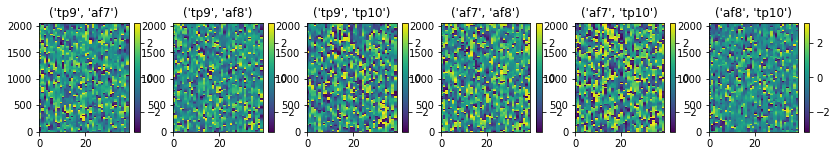

test_sitting_2_1
EYES CLOSED


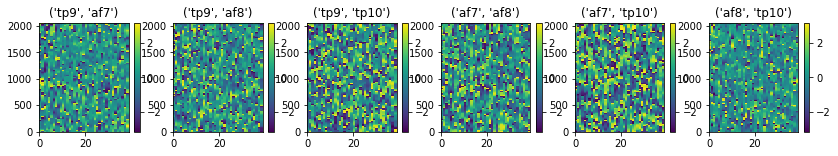

test_sitting_2_2
EYES OPEN


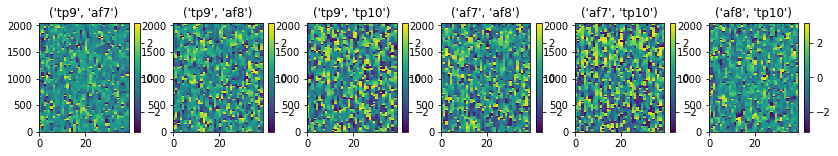

test_sitting_2_3
EYES CLOSED


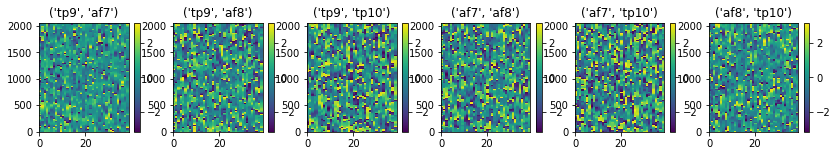

test_sitting_2_4
EYES OPEN


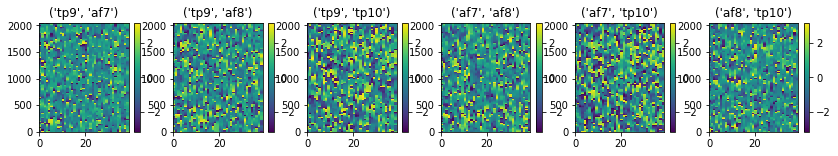

test_sitting_2_5
EYES CLOSED


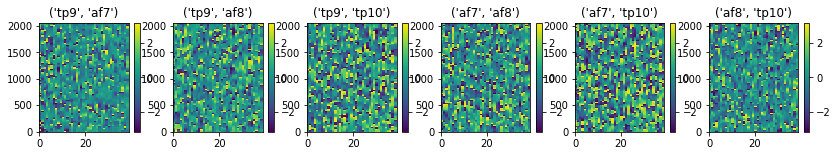

test_sitting_2_6
EYES OPEN


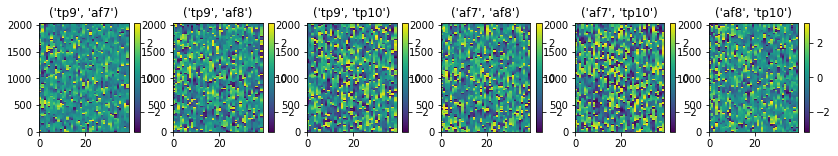

test_sitting_2_7
EYES CLOSED


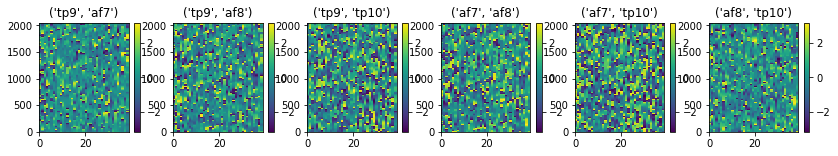

test_sitting_2_8
EYES OPEN


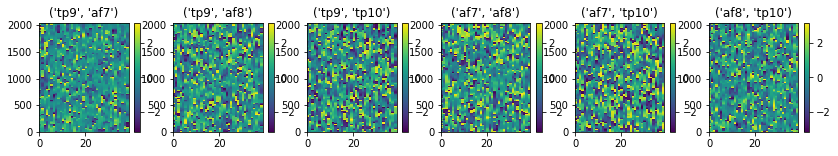

test_sitting_2_10
EYES OPEN


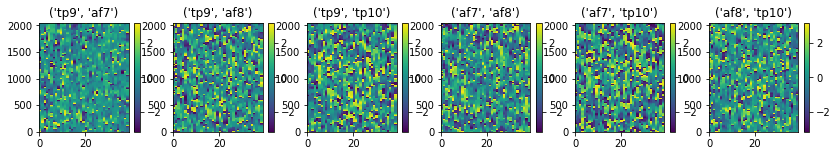

test_sitting_2_11
EYES CLOSED


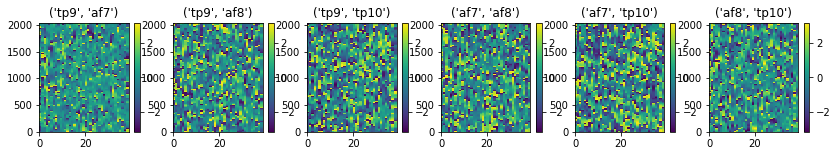

test_sitting_2_12
EYES OPEN


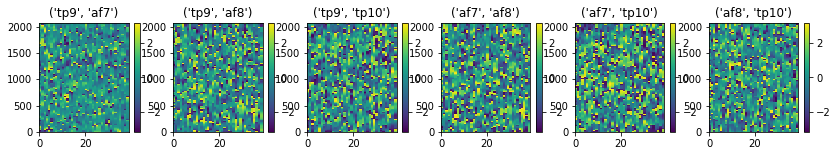

test_sitting_2_13
EYES CLOSED


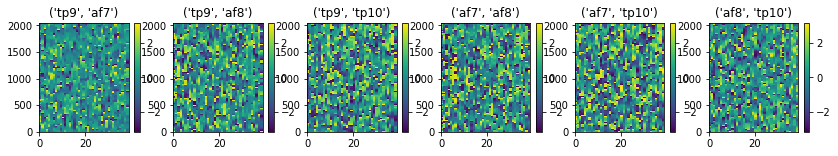

test_sitting_2_14
EYES OPEN


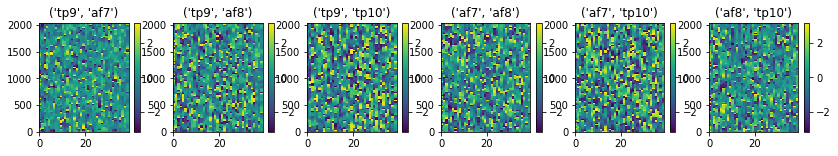

test_sitting_2_15
EYES CLOSED


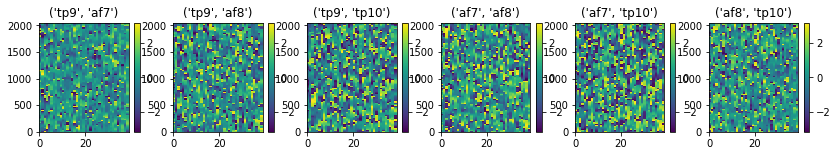

test_sitting_2_16
EYES OPEN


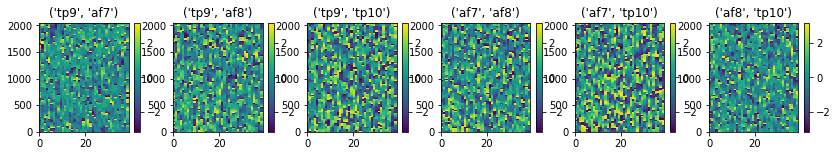

test_sitting_2_18
EYES OPEN


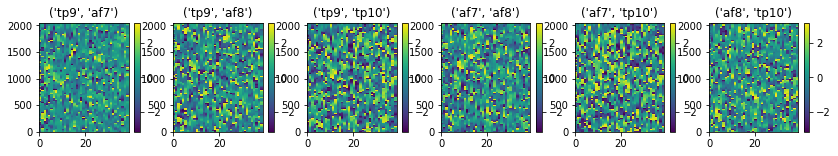

test_sitting_2_19
EYES CLOSED


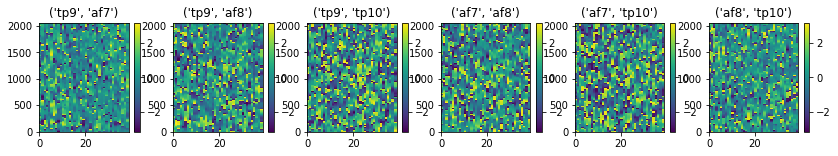

test_sitting_2_20
EYES OPEN


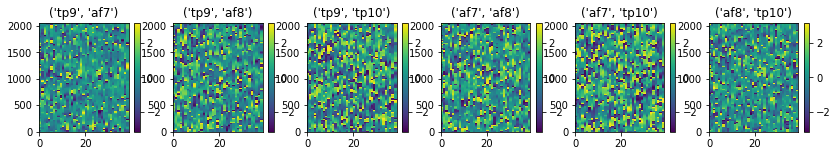

test_sitting_2_21
EYES CLOSED


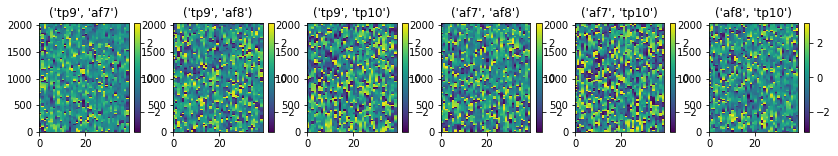

test_sitting_2_22
EYES OPEN


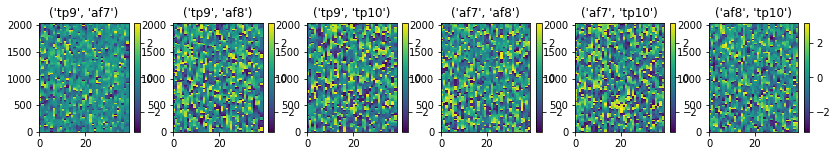

test_sitting_2_23
EYES CLOSED


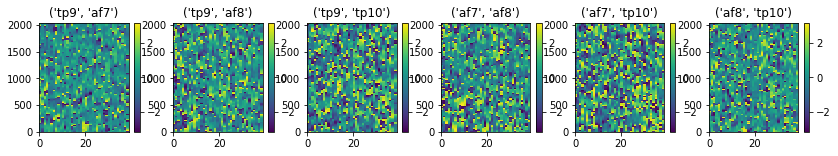

test_sitting_2_24
EYES OPEN


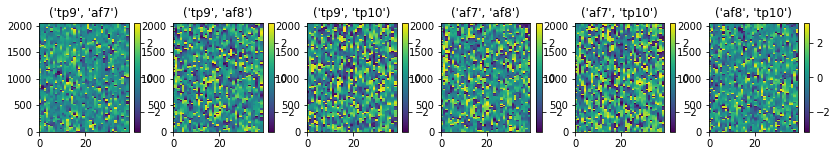

test_sitting_2_25
EYES CLOSED


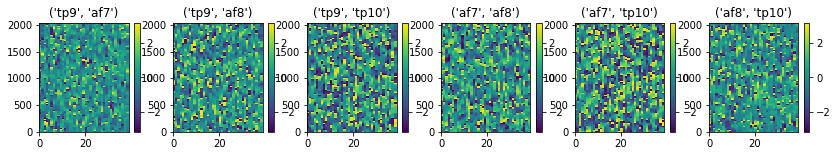

test_sitting_2_26
EYES OPEN


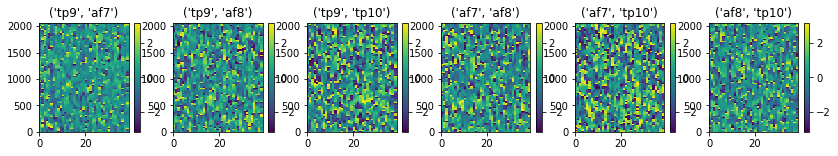

test_sitting_2_27
EYES CLOSED


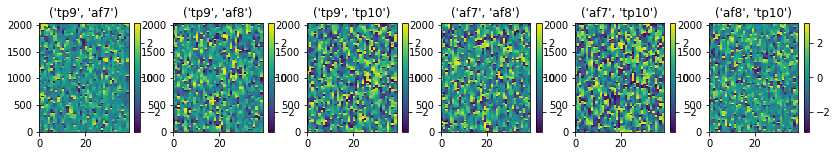

test_sitting_2_28
EYES OPEN


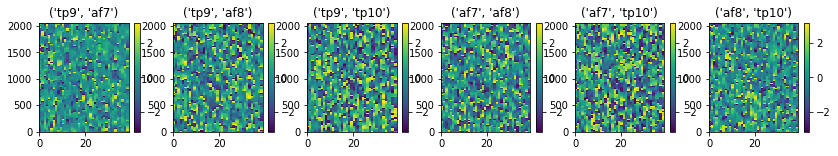

test_sitting_2_31
EYES CLOSED


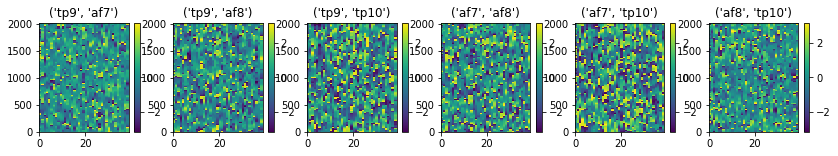

test_sitting_2_32
EYES OPEN


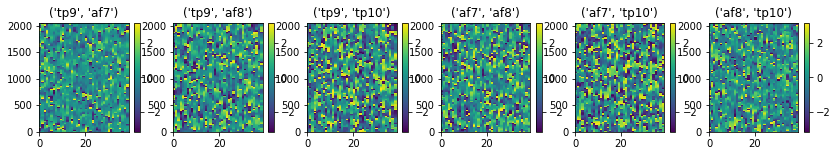

test_sitting_2_35
EYES CLOSED


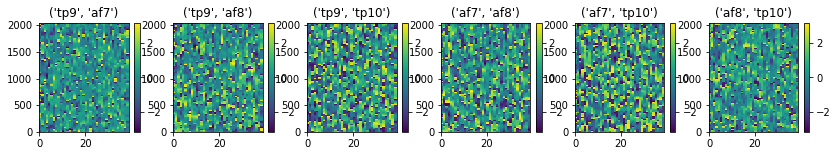

test_sitting_2_36
EYES OPEN


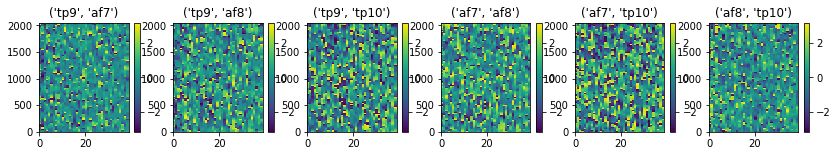

test_sitting_2_37
EYES CLOSED


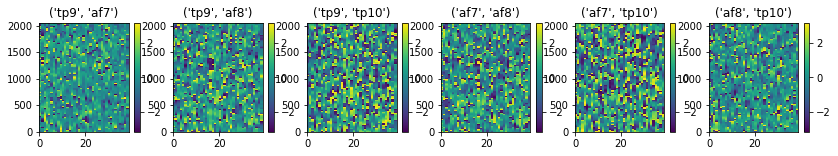

test_sitting_2_38
EYES OPEN


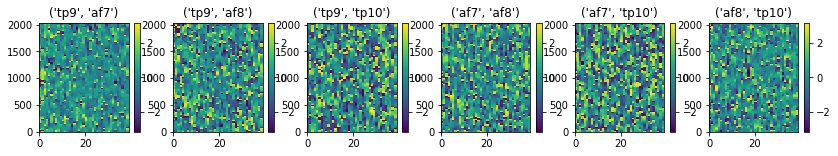

test_sitting_2_41
EYES CLOSED


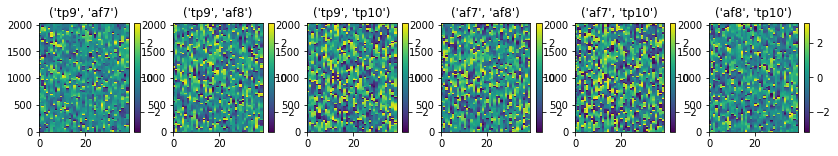

test_sitting_2_43
EYES CLOSED


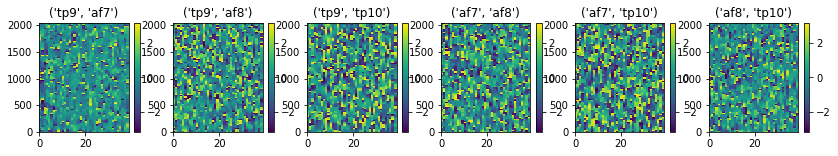

test_sitting_2_44
EYES OPEN


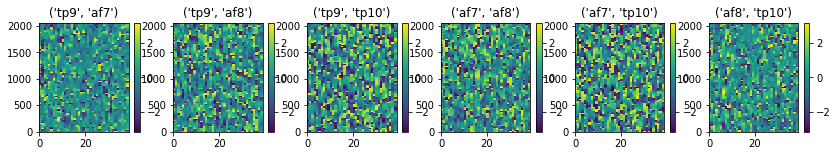

test_sitting_2_45
EYES CLOSED


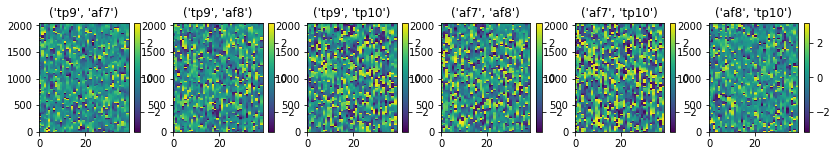

test_sitting_2_46
EYES OPEN


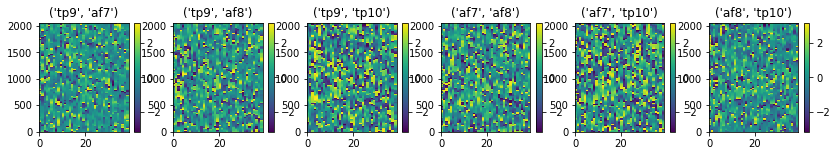

test_sitting_2_47
EYES CLOSED


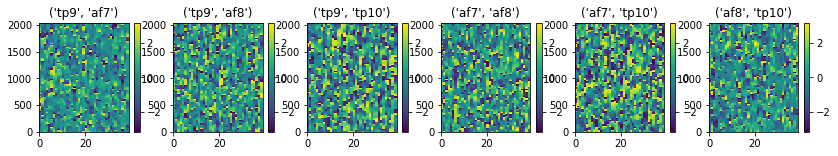

test_sitting_2_48
EYES OPEN


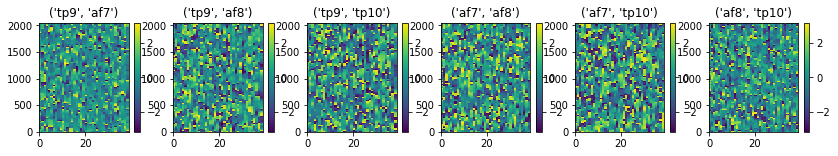

test_sitting_2_50
EYES OPEN


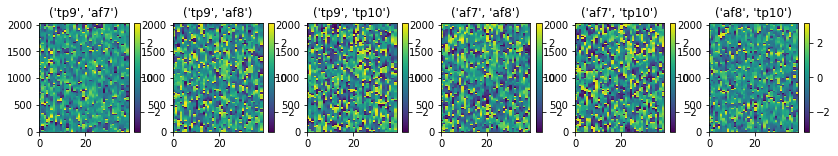

test_sitting_2_51
EYES CLOSED


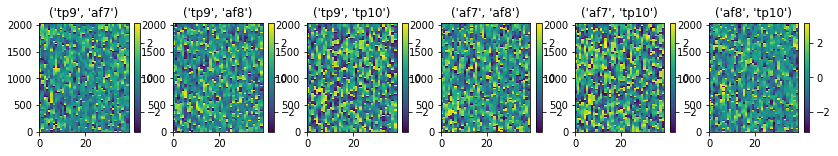

test_sitting_2_52
EYES OPEN


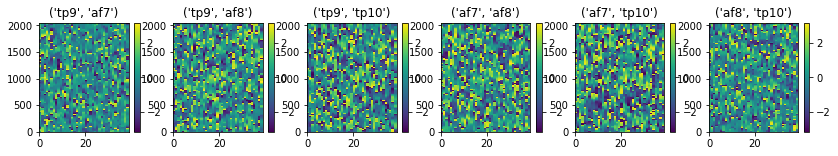

test_sitting_2_53
EYES CLOSED


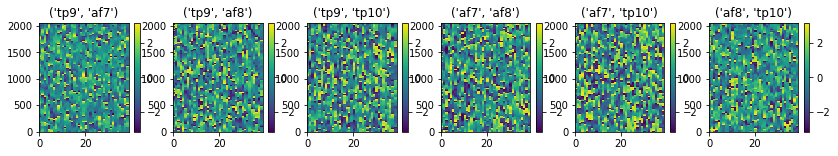

test_sitting_2_54
EYES OPEN


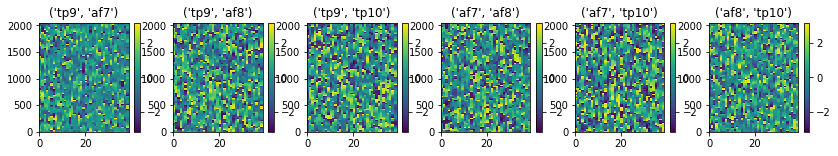

test_sitting_2_55
EYES CLOSED


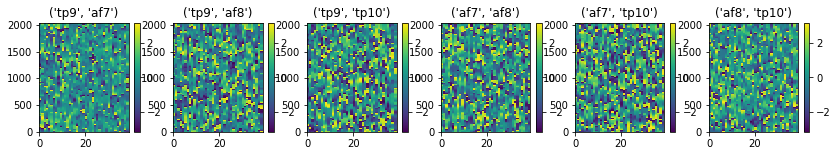

test_sitting_2_58
EYES OPEN


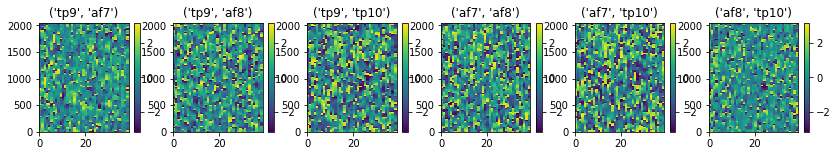

test_sitting_2_59
EYES CLOSED


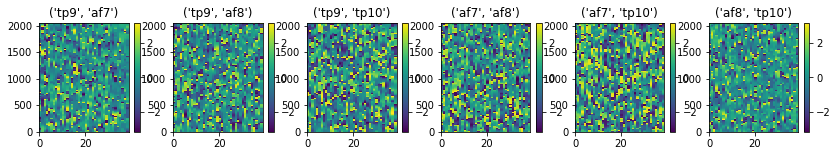

In [353]:
def smallestSignedAngleBetween(x, y):
                    """
                    based on function from https://stackoverflow.com/a/1878936
                    """
                    A = (x - y) % (2*np.pi)
                    B = (y - x) % (2*np.pi)
                    return [-a if a < b else b for a,b in zip(A,B)]
"""
for float_for_string in wavelet_freqs:
    float_string = str(float_for_string)   #example: 'phase6.0HzCh0'

    for ch_pair in [(0,1),(0,2),(0,3),(1,2),(1,3),(2,3)]:

        name_string_A = 'phase'+float_string+'HzCh'+str(ch_pair[0])
        name_string_B = 'phase'+float_string+'HzCh'+str(ch_pair[1])

        phase_diff_name = 'phaseDifference_'+name_string_A+'_'+name_string_B

        phase_diff = smallestSignedAngleBetween(x=wavelet_output[name_string_A], y=wavelet_output[name_string_B])

        phase_diff_dict[phase_diff_name] = phase_diff

        #print(phase_diff_name+': ', phase_diff_dict[phase_diff_name][0])
        #print('\n')

phase_diff_df = pd.DataFrame(phase_diff_dict, index=convolve_segment.index)
"""
from itertools import combinations
# Phase diff
for id_idx in range(len(outerList)):
    print(seg_id_list[id_idx])
    if int(seg_id_list[id_idx].split('_')[-1])%2==0:
        print('EYES OPEN')
    elif int(seg_id_list[id_idx].split('_')[-1])%2==1:
        print('EYES CLOSED')
    temp = apply_wavelets(data=np.vstack([np.array([outerList[id_idx][key] for key in ['tp9','af7','af8','tp10']])]).T, 
                   wavelet_width=2, 
                   freqs=[f for f in range(4,81,2)], 
                   n_wavelet_cycles=[f for f in range(4,81,2)], 
                   extract_list=['phase'], 
                   plot_things=False, 
                   verbose=False)
    new_temp = []
    A = (0,39)
    B = (39,78)
    C = (78,117)
    D = (117,156)
    for pair in combinations([A,B,C,D],2):
        new_temp_inner = []
        for i in range(temp.values.shape[0]):
            phasediff = smallestSignedAngleBetween(temp.values[i,pair[0][0]:pair[0][1]], temp.values[i,pair[1][0]:pair[1][1]])
            new_temp_inner.append(phasediff)
        new_temp.append(new_temp_inner)
    #display(temp.mean(axis=0))
    new_temp = np.array(new_temp)
    plt.figure(figsize=[14,2])
    for i in range(6):

        plt.subplot(1,6,i+1)
        plt.pcolor(new_temp[i])
        plt.colorbar()
        plt.title(list(combinations(['tp9','af7','af8','tp10'],2))[i])
        
    plt.show()

In [346]:
from itertools import combinations
A = (0,39)
B = (39,78)
C = (78,117)
D = (117,156)
list(combinations([A,B,C,D],2))

[((0, 39), (39, 78)),
 ((0, 39), (78, 117)),
 ((0, 39), (117, 156)),
 ((39, 78), (78, 117)),
 ((39, 78), (117, 156)),
 ((78, 117), (117, 156))]

In [347]:
list(combinations(['tp9','af7','af8','tp10'],2))

[('tp9', 'af7'),
 ('tp9', 'af8'),
 ('tp9', 'tp10'),
 ('af7', 'af8'),
 ('af7', 'tp10'),
 ('af8', 'tp10')]

In [348]:
list(combinations(['tp9','af7','af8','tp10'],2))

[('tp9', 'af7'),
 ('tp9', 'af8'),
 ('tp9', 'tp10'),
 ('af7', 'af8'),
 ('af7', 'tp10'),
 ('af8', 'tp10')]

In [350]:
list(combinations(['tp9','af7','af8','tp10'],2))[5]

('af8', 'tp10')

<ipython-input-287-ef04fb9b013d>:8: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = fig.gca(projection='3d')


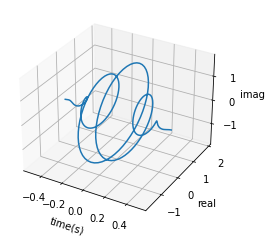

<ipython-input-287-ef04fb9b013d>:16: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = fig.gca(projection='3d')


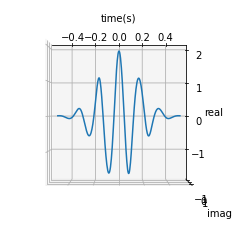

<ipython-input-287-ef04fb9b013d>:25: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = fig.gca(projection='3d')


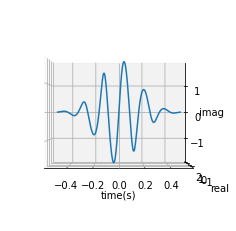

In [354]:
visualize_wavelet()